In [ ]:
!pip uninstall torchaudio
!pip uninstall torchdata
!pip uninstall torchsummary
!pip uninstall torchtext
!pip uninstall torchvision

In [ ]:
import sys
if 'google.colab' in str(get_ipython()):
  ! {sys.executable} -m pip install pytorch-lifestream
  !pip install "torch<2"
  !pip install torchvision==0.13.1

In [ ]:
!pip install pytorch-tabnet

In [ ]:
!pip install catboost

In [ ]:
!pip install optuna

In [ ]:
%load_ext autoreload
%autoreload 2

import torch
import pytorch_lightning as pl

from sklearn.metrics import accuracy_score, classification_report

from pytorch_tabnet.multitask import TabNetMultiTaskClassifier
from sklearn.model_selection import KFold
import logging

from sklearn.metrics import auc
from sklearn.metrics import precision_recall_curve
from sklearn.linear_model import LogisticRegression
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import make_scorer, roc_auc_score
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from sklearn.svm import LinearSVC
from catboost import CatBoostClassifier
import numpy as np
import lightgbm as lgb
import optuna
from sklearn.ensemble import RandomForestClassifier
from matplotlib import pyplot as plt
%matplotlib inline



from pytorch_tabnet.pretraining import TabNetPretrainer


from tqdm import tqdm
import matplotlib.pyplot as plt
from IPython.display import clear_output
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

import torch.nn.functional as F

In [ ]:
import os
import pandas as pd

data_path = 'data/'

df_trx = pd.read_csv(os.path.join(data_path, 'train_age_pred_new.csv'))
df_trx.head(2)

,client_id,trans_date,small_group,amount_rur
0,45005,0,1,62.967
1,45005,1,1,86.553


In [ ]:
df_target = pd.read_csv(os.path.join(data_path, 'train_target_age_pred_new.csv'))
df_target


,client_id,target
0,42053,3
1,34497,3
2,6316,3
3,6606,2
4,8666,2
...,...,...
495,25391,3
496,21205,0
497,498,2
498,10896,0


In [ ]:
df_target_train, df_target_test = train_test_split(
    df_target, test_size=0.1, stratify=df_target['target'], random_state=142)


df_target_train, df_target_valid = train_test_split(
    df_target_train, test_size=0.2, stratify=df_target_train['target'], random_state=142)


print('Split {} records to train: {}, valid: {}, test: {}'.format(
    *[len(df) for df in [df_target, df_target_train, df_target_valid, df_target_test]]))

Split 500 records to train: 360, valid: 90, test: 50


In [ ]:
df_trx_train = pd.merge(df_trx, df_target_train['client_id'], on='client_id', how='inner')

df_trx_valid = pd.merge(df_trx, df_target_valid['client_id'], on='client_id', how='inner')

df_trx_test = pd.merge(df_trx, df_target_test['client_id'], on='client_id', how='inner')


print('Split {} transactions to train: {}, valid: {}, test: {}'.format(
    *[len(df) for df in [df_trx, df_trx_train, df_trx_valid, df_trx_test]]))

Split 442398 transactions to train: 318832, valid: 78798, test: 44768


In [ ]:
from ptls.preprocessing import PandasDataPreprocessor

preprocessor = PandasDataPreprocessor(
    col_id='client_id',
    col_event_time='trans_date',
    event_time_transformation='none',
    cols_category=['small_group'],
    cols_numerical=['amount_rur'],
    return_records=False,
)

In [ ]:
%%time
df_data_train_no_target = preprocessor.fit_transform(df_trx_train)
df_data_valid_no_target = preprocessor.transform(df_trx_valid)
df_data_test_no_target = preprocessor.transform(df_trx_test)

CPU times: user 668 ms, sys: 26.5 ms, total: 694 ms
Wall time: 689 ms


In [ ]:
print('Record in dataset, train {}, valid {}, test {}\nEach record is a client with list of transactions'.format(
    *[len(df) for df in [df_data_train_no_target, df_data_valid_no_target, df_data_test_no_target]]))

Record in dataset, train 360, valid 90, test 50
Each record is a client with list of transactions


In [ ]:
df_target = df_target.rename(columns={'bins': 'target_bin'})
df_target

,client_id,target
0,42053,3
1,34497,3
2,6316,3
3,6606,2
4,8666,2
...,...,...
495,25391,3
496,21205,0
497,498,2
498,10896,0


In [ ]:
df_data_train = pd.merge(df_data_train_no_target, df_target, on='client_id')
df_data_valid = pd.merge(df_data_valid_no_target, df_target, on='client_id')
df_data_test = pd.merge(df_data_test_no_target, df_target, on='client_id')

In [ ]:
df_data_train_no_target = df_data_train_no_target.to_dict(orient='records')
df_data_valid_no_target = df_data_valid_no_target.to_dict(orient='records')
df_data_test_no_target = df_data_test_no_target.to_dict(orient='records')

In [ ]:
df_data_train = df_data_train.to_dict(orient='records')
df_data_valid = df_data_valid.to_dict(orient='records')
df_data_test = df_data_test.to_dict(orient='records')

In [ ]:
rec = df_data_train[0]
{k: v[:10] if type(v) is torch.Tensor else v for k, v in rec.items()}

{'client_id': 132,
 'trans_date': tensor([ 1,  6,  6,  7, 10, 11, 15, 15, 15, 16]),
 'event_time': tensor([ 1,  6,  6,  7, 10, 11, 15, 15, 15, 16]),
 'small_group': tensor([11, 17,  1,  1,  9,  3, 25, 66,  2,  3]),
 'amount_rur': tensor([ 36.5910,  28.2560,  17.2470,  10.9220,   3.0960,   4.3130, 112.1320,
         116.0910,   8.8850,   4.3130], dtype=torch.float64),
 'target': 2}

In [ ]:
rec = df_data_train_no_target[0]
{k: v[:10] if type(v) is torch.Tensor else v for k, v in rec.items()}

{'client_id': 132,
 'trans_date': tensor([ 1,  6,  6,  7, 10, 11, 15, 15, 15, 16]),
 'event_time': tensor([ 1,  6,  6,  7, 10, 11, 15, 15, 15, 16]),
 'small_group': tensor([11, 17,  1,  1,  9,  3, 25, 66,  2,  3]),
 'amount_rur': tensor([ 36.5910,  28.2560,  17.2470,  10.9220,   3.0960,   4.3130, 112.1320,
         116.0910,   8.8850,   4.3130], dtype=torch.float64)}

In [ ]:
def remove_extra_feature(name):
    for i in range(len(name)):
        if 'trans_date' in name[i]:
            del name[i]['trans_date']

In [ ]:
remove_extra_feature(df_data_train_no_target)
remove_extra_feature(df_data_valid_no_target)
remove_extra_feature(df_data_test_no_target)
remove_extra_feature(df_data_train)
remove_extra_feature(df_data_valid)
remove_extra_feature(df_data_test)

In [ ]:
from ptls.data_load.datasets import MemoryMapDataset

dataset_train = MemoryMapDataset(df_data_train)
dataset_valid = MemoryMapDataset(df_data_valid)

dataset_test = MemoryMapDataset(df_data_test)

In [ ]:
from functools import partial
from ptls.nn import TrxEncoder, RnnSeqEncoder
from ptls.frames.coles import CoLESModule

trx_encoder_params = dict(
    embeddings_noise=0.003,
    numeric_values={'amount_rur': 'identity'},
    embeddings={
        'event_time': {'in': 730, 'out': 16},
        'small_group': {'in': 170, 'out': 16},
    },
)

seq_encoder = RnnSeqEncoder(
    trx_encoder=TrxEncoder(**trx_encoder_params),
    hidden_size=256,
    type='gru',
)

model = CoLESModule(
    seq_encoder=seq_encoder,
    optimizer_partial=partial(torch.optim.Adam, lr=0.001),
    lr_scheduler_partial=partial(torch.optim.lr_scheduler.StepLR, step_size=30, gamma=0.9),
)

In [ ]:
from ptls.data_load.datasets import MemoryMapDataset
from ptls.data_load.iterable_processing import SeqLenFilter
from ptls.frames.coles import ColesDataset
from ptls.frames.coles.split_strategy import SampleSlices
from ptls.frames import PtlsDataModule

train_dl = PtlsDataModule(
    train_data=ColesDataset(
        MemoryMapDataset(
            data=df_data_train_no_target,
            i_filters=[
                SeqLenFilter(min_seq_len=25),
            ],
        ),
        splitter=SampleSlices(
            split_count=5,
            cnt_min=25,
            cnt_max=200,
        ),
    ),
    valid_data = ColesDataset(
        MemoryMapDataset(
            data=df_data_valid_no_target,
            i_filters=[
                SeqLenFilter(min_seq_len=25),
            ],
        ),
        splitter=SampleSlices(
            split_count=5,
            cnt_min=25,
            cnt_max=200,
        ),
    ),
    train_num_workers=8,
    train_batch_size=256,
)

In [ ]:

import tensorboard
%load_ext tensorboard


In [ ]:
logger = pl.loggers.TensorBoardLogger("logs", name="coles")

trainer = pl.Trainer(
    max_epochs=300,
    gpus=1 if torch.cuda.is_available() else 0,
    enable_progress_bar=False,
    logger = logger
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True, used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
%%time
print(f'logger.version = {trainer.logger.version}')
trainer.fit(model, train_dl)
print(trainer.logged_metrics)

logger.version = 0


INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name               | Type            | Params
-------------------------------------------------------
0 | _loss              | ContrastiveLoss | 0     
1 | _seq_encoder       | RnnSeqEncoder   | 238 K 
2 | _validation_metric | BatchRecallTopK | 0     
3 | _head              | Head            | 0     
-------------------------------------------------------
238 K     Trainable params
0         Non-trainable params
238 K     Total params
0.953     Total estimated model params size (MB)
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/trainer.py:1933: PossibleUserWarning: The number of training batches (2) is smal

{'loss': tensor(172.7251), 'seq_len': tensor(116.7538), 'valid/recall_top_k': tensor(0.5622)}
CPU times: user 1min 56s, sys: 3min 19s, total: 5min 16s
Wall time: 6min 52s


In [ ]:
torch.save(seq_encoder.state_dict(), "emb_part_age_pred.pt")

In [ ]:
%tensorboard --logdir logs


Reusing TensorBoard on port 6006 (pid 51172), started 0:00:05 ago. (Use '!kill 51172' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
from functools import partial
import torch
import torchmetrics
from ptls.frames.supervised import SequenceToTarget
from ptls.nn import Head

downstream_model = SequenceToTarget(
    seq_encoder=seq_encoder,
    head=Head(
        input_size=seq_encoder.embedding_size,
        use_batch_norm=True,
        objective='classification',
        num_classes=4,
    ),
    loss=torch.nn.CrossEntropyLoss(),
    metric_list=torchmetrics.Accuracy(compute_on_step=False),
    pretrained_lr=0.0001,
    optimizer_partial=partial(torch.optim.Adam, lr=0.02),
    lr_scheduler_partial=partial(torch.optim.lr_scheduler.StepLR, step_size=10, gamma=0.2),
)

In [ ]:
from ptls.data_load.datasets import MemoryMapDataset
from ptls.data_load.iterable_processing import SeqLenFilter, FeatureFilter
from ptls.frames.supervised import SeqToTargetDataset
from ptls.frames import PtlsDataModule

def get_dataset(data):
    return SeqToTargetDataset(
        MemoryMapDataset(
            data=data,
        ),
        target_col_name='target',
    )

finetune_dm = PtlsDataModule(
    train_data=get_dataset(df_data_train),
    valid_data=get_dataset(df_data_valid),
    test_data=get_dataset(df_data_test),
    train_num_workers=4,
    train_batch_size=256,
    test_batch_size=128,
)

In [ ]:
logger = pl.loggers.TensorBoardLogger("logs", name="downstream")

trainer_ft = pl.Trainer(
    max_epochs=250,
    gpus=1 if torch.cuda.is_available() else 0,
    enable_progress_bar=False,
    logger = logger
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True, used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
print(f'logger.version = {trainer_ft.logger.version}')
trainer_ft.fit(downstream_model, finetune_dm)
print(trainer_ft.logged_metrics)

INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name          | Type             | Params
---------------------------------------------------
0 | seq_encoder   | RnnSeqEncoder    | 238 K 
1 | head          | Head             | 1.5 K 
2 | loss          | CrossEntropyLoss | 0     
3 | train_metrics | ModuleDict       | 0     
4 | valid_metrics | ModuleDict       | 0     
5 | test_metrics  | ModuleDict       | 0     
---------------------------------------------------
239 K     Trainable params
0         Non-trainable params
239 K     Total params
0.959     Total estimated model params size (MB)


logger.version = 0


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/trainer.py:1933: PossibleUserWarning: The number of training batches (2) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


{'loss': tensor(0.5269), 'seq_len': tensor(897.8751), 'y': tensor(1.5096), 'val_loss': tensor(1.2071), 'valid/Accuracy': tensor(0.5778), 'train/Accuracy': tensor(0.8056)}


In [ ]:
trainer_ft.test(downstream_model, dataloaders=finetune_dm.test_dataloader())

INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│       test/Accuracy       │    0.3799999952316284     │
└───────────────────────────┴───────────────────────────┘

[{'test/Accuracy': 0.3799999952316284}]

In [ ]:
%tensorboard --logdir logs


Reusing TensorBoard on port 6006 (pid 51172), started 0:05:23 ago. (Use '!kill 51172' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:

from ptls.data_load.datasets import inference_data_loader

train_dl_new = inference_data_loader(df_data_train, num_workers=0, batch_size=256)
train_embeds_new = torch.vstack(trainer_ft.predict(downstream_model, train_dl_new, ))

test_dl_new = inference_data_loader(df_data_test, num_workers=0, batch_size=256)
test_embeds_new = torch.vstack(trainer_ft.predict(downstream_model, test_dl_new,))

train_embeds_new.shape, test_embeds_new.shape

INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:240: PossibleUserWarning: The dataloader, predict_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 8 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/epoch/prediction_epoch_loop.py:175: UserWarning: Lightning couldn't infer the indices fetched for your dataloader.
  warning_cache.warn("Lightning couldn't infer the indices fetched for your dataloader.")
INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


(torch.Size([360, 4]), torch.Size([50, 4]))

In [ ]:
df_target = pd.read_csv(os.path.join(data_path, 'train_target_age_pred_new.csv'))

df_target = df_target.set_index('client_id')
df_target.rename(columns={"bins": "target"}, inplace=True)

train_df = pd.DataFrame(data=train_embeds_new, columns=[f'embed_{i}' for i in range(train_embeds_new.shape[1])])
train_df['client_id'] = [x['client_id'] for x in df_data_train]
train_df = train_df.merge(df_target, how='left', on='client_id')

test_df = pd.DataFrame(data=test_embeds_new, columns=[f'embed_{i}' for i in range(test_embeds_new.shape[1])])
test_df['client_id'] = [x['client_id'] for x in df_data_test]
test_df = test_df.merge(df_target, how='left', on='client_id')

print(train_df.shape, test_df.shape)

(360, 6) (50, 6)


In [ ]:
train_df

,embed_0,embed_1,embed_2,embed_3,client_id,target
0,-1.805180,-4.788914,-0.260464,-2.872807,132,2
1,-1.204433,-0.827228,-5.377783,-1.353787,191,0
2,-1.362304,-2.169192,-10.609038,-0.462615,241,3
3,-2.429554,-0.492715,-6.434887,-1.206128,409,1
4,-1.011817,-5.695497,-1.695698,-0.799374,498,2
...,...,...,...,...,...,...
355,-1.020412,-6.482869,-0.566504,-2.651887,49076,2
356,-3.329012,-12.668212,-0.037048,-7.526274,49101,2
357,-5.072682,-0.034600,-9.814207,-3.586772,49184,1
358,-3.054352,-0.724108,-4.925284,-0.774728,49436,1


In [ ]:
embed_columns = [x for x in train_df.columns if x.startswith('embed')]
x_train, y_train = train_df[embed_columns], train_df['target']
x_test, y_test = test_df[embed_columns], test_df['target']

In [ ]:
clf_forest = RandomForestClassifier(random_state=42)
clf_forest.fit(x_train, y_train)
y_pred_forest = clf_forest.predict(x_test)
print('accuracy for random forest:', clf_forest.score(x_test, y_test))

accuracy for random forest: 0.38


In [ ]:
seq_encoder = RnnSeqEncoder(
    trx_encoder=TrxEncoder(**trx_encoder_params),
    hidden_size=256,
    type='gru',
)
seq_encoder.load_state_dict(torch.load("emb_part_age_pred.pt"))

<All keys matched successfully>

In [ ]:

from ptls.data_load.datasets import inference_data_loader

train_dl = inference_data_loader(df_data_train, num_workers=0, batch_size=256)
train_embeds = torch.vstack(trainer.predict(model, train_dl, ))

test_dl = inference_data_loader(df_data_test, num_workers=0, batch_size=256)
test_embeds = torch.vstack(trainer.predict(model, test_dl))

train_embeds.shape, test_embeds.shape

INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:240: PossibleUserWarning: The dataloader, predict_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 8 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(
INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


(torch.Size([360, 256]), torch.Size([50, 256]))

In [ ]:
df_target = pd.read_csv(os.path.join(data_path, 'train_target_age_pred_new.csv'))

df_target = df_target.set_index('client_id')
df_target.rename(columns={"bins": "target"}, inplace=True)

train_df = pd.DataFrame(data=train_embeds, columns=[f'embed_{i}' for i in range(train_embeds.shape[1])])
train_df['client_id'] = [x['client_id'] for x in df_data_train]
train_df = train_df.merge(df_target, how='left', on='client_id')

test_df = pd.DataFrame(data=test_embeds, columns=[f'embed_{i}' for i in range(test_embeds.shape[1])])
test_df['client_id'] = [x['client_id'] for x in df_data_test]
test_df = test_df.merge(df_target, how='left', on='client_id')

print(train_df.shape, test_df.shape)

(360, 258) (50, 258)


In [ ]:
embed_columns = [x for x in train_df.columns if x.startswith('embed')]
x_train, y_train = train_df[embed_columns], train_df['target']
x_test, y_test = test_df[embed_columns], test_df['target']

In [ ]:
print(x_train.shape, y_train.shape)
print(x_test.shape, y_test.shape)


(360, 256) (360,)
(50, 256) (50,)


# Random Forest

In [ ]:
clf_forest = RandomForestClassifier(random_state=42)
clf_forest.fit(x_train, y_train)
y_pred_forest = clf_forest.predict(x_test)
print('accuracy for random forest:', clf_forest.score(x_test, y_test))

accuracy for random forest: 0.36


In [ ]:
report_forest = classification_report(y_test, y_pred_forest)

In [ ]:
print("Classification Report Random Forest:\n", report_forest)

Classification Report Random Forest:
               precision    recall  f1-score   support

           0       0.17      0.21      0.19        14
           1       0.50      0.50      0.50        12
           2       0.50      0.46      0.48        13
           3       0.38      0.27      0.32        11

    accuracy                           0.36        50
   macro avg       0.39      0.36      0.37        50
weighted avg       0.38      0.36      0.37        50



# Random Forest with hyperparametres

In [ ]:
x_train_val, x_val, y_train_val, y_val = train_test_split(x_train,y_train, test_size=0.2, random_state=42)

In [ ]:

def objective(trial):
    params = {
        'max_depth' :  trial.suggest_int('max_depth', 1, 30),
        'min_samples_leaf' : trial.suggest_int("min_samples_leaf", 4, 30),
        'min_samples_split' : trial.suggest_int("min_samples_split", 2, 30),
        'n_estimators' : trial.suggest_int('n_estimators', 10, 200, step=5),
    }


    forest = RandomForestClassifier(random_state = 42, max_depth=params['max_depth'], min_samples_leaf=params['min_samples_leaf'],min_samples_split = params['min_samples_split'],\
                                    n_estimators=params['n_estimators'])

    forest.fit(x_train_val, y_train_val)
    score = forest.score(x_val, y_val)
    return score

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)
study.best_params

[I 2024-01-02 11:02:02,241] A new study created in memory with name: no-name-61bec862-890c-4395-8721-c8a7b47b754d
[I 2024-01-02 11:02:02,646] Trial 0 finished with value: 0.325 and parameters: {'max_depth': 18, 'min_samples_leaf': 8, 'min_samples_split': 22, 'n_estimators': 145}. Best is trial 0 with value: 0.325.
[I 2024-01-02 11:02:02,976] Trial 1 finished with value: 0.3625 and parameters: {'max_depth': 10, 'min_samples_leaf': 17, 'min_samples_split': 14, 'n_estimators': 135}. Best is trial 1 with value: 0.3625.
[I 2024-01-02 11:02:03,407] Trial 2 finished with value: 0.3375 and parameters: {'max_depth': 18, 'min_samples_leaf': 9, 'min_samples_split': 21, 'n_estimators': 160}. Best is trial 1 with value: 0.3625.
[I 2024-01-02 11:02:03,579] Trial 3 finished with value: 0.3125 and parameters: {'max_depth': 16, 'min_samples_leaf': 5, 'min_samples_split': 13, 'n_estimators': 55}. Best is trial 1 with value: 0.3625.
[I 2024-01-02 11:02:03,743] Trial 4 finished with value: 0.3125 and para

{'max_depth': 23,
 'min_samples_leaf': 11,
 'min_samples_split': 4,
 'n_estimators': 75}

In [ ]:
best_params = study.best_params
clf_forest = RandomForestClassifier(random_state=42, max_depth=best_params['max_depth'],\
                                    min_samples_leaf=best_params['min_samples_leaf'],min_samples_split = best_params['min_samples_split'],\
                                    n_estimators=best_params['n_estimators'])
clf_forest.fit(x_train, y_train)
y_pred_forest =clf_forest.predict(x_test)
print('accuracy for random forest:', clf_forest.score(x_test, y_test))

accuracy for random forest: 0.34


# Light Gradient Boosting Machine

In [ ]:

d_train=lgb.Dataset(x_train, label=y_train)
params={}
params['learning_rate']=0.03
params['boosting_type']='gbdt'
params['objective']='multiclass'
params['metric']='multi_logloss'
params['max_depth']=10
params['num_class']=len(y_train.unique())
clf_lgb=lgb.train(params,d_train,10)

y_pred_1=clf_lgb.predict(x_test)


In [ ]:

y_pred_1 = [np.argmax(line) for line in y_pred_1]
accuracy_score(y_test, y_pred_1)


0.47

In [ ]:

clf_lgb = lgb.LGBMClassifier(max_depth = 6, num_leaves = 20, learning_rate=0.1, random_state=42)
clf_lgb.fit(x_train, y_train)

In [ ]:
y_pred_gb=clf_lgb.predict(x_test)
print('score, lgb:', clf_lgb.score(x_test, y_test))

score, lgb: 0.46


In [ ]:
report = classification_report(y_test, y_pred_gb)
print("Classification Report:\n", report)

Classification Report:
               precision    recall  f1-score   support

           0       0.33      0.24      0.28        29
           1       0.71      0.59      0.65        34
           2       0.56      0.65      0.60        23
           3       0.17      0.29      0.21        14

    accuracy                           0.46       100
   macro avg       0.44      0.44      0.43       100
weighted avg       0.49      0.46      0.47       100



# Catboost

In [ ]:
clf_catboost = CatBoostClassifier(
    iterations=100, depth=6, learning_rate=0.1,
   loss_function='MultiClass', verbose=False, random_state = 42)
clf_catboost.fit(x_train, y_train)

In [ ]:
y_pred_cat = clf_catboost.predict(x_test)

accuracy_cat = accuracy_score(y_test, y_pred_cat)
report = classification_report(y_test, y_pred_cat)

print(f"Accuracy: {accuracy_cat}")
print("Classification Report:\n", report)

Accuracy: 0.33
Classification Report:
               precision    recall  f1-score   support

           0       0.18      0.10      0.13        29
           1       0.58      0.41      0.48        34
           2       0.35      0.57      0.43        23
           3       0.14      0.21      0.17        14

    accuracy                           0.33       100
   macro avg       0.31      0.32      0.30       100
weighted avg       0.35      0.33      0.32       100



# One-vs-Rest

In [ ]:
clf_ovsr = OneVsRestClassifier(LinearSVC(random_state=42, max_iter=100000)).fit(x_train, y_train)
y_pred_ovsr = clf_ovsr.predict(x_test)
accuracy_ovsr = accuracy_score(y_test, y_pred_ovsr)
report_ovsr = classification_report(y_test, y_pred_ovsr)
print(f"Accuracy One vs Rest: {accuracy_ovsr}")
print("Classification Report One vs Rest:\n", report_ovsr)

Accuracy One vs Rest: 0.34
Classification Report One vs Rest:
               precision    recall  f1-score   support

           0       0.29      0.24      0.26        29
           1       0.56      0.44      0.49        34
           2       0.31      0.43      0.36        23
           3       0.12      0.14      0.13        14

    accuracy                           0.34       100
   macro avg       0.32      0.32      0.31       100
weighted avg       0.36      0.34      0.35       100



# One-vs-One

In [ ]:
clf_ovso = OneVsOneClassifier(LinearSVC(random_state=42, max_iter=100000)).fit(x_train, y_train)
y_pred_ovso =clf_ovso.predict(x_test)
accuracy_ovso = accuracy_score(y_test, y_pred_ovso)
report_ovso = classification_report(y_test, y_pred_ovso)
print(f"Accuracy One vs One: {accuracy_ovso}")
print("Classification Report One vs One:\n", report_ovso)

Accuracy One vs One: 0.4
Classification Report One vs One:
               precision    recall  f1-score   support

           0       0.42      0.34      0.38        29
           1       0.57      0.50      0.53        34
           2       0.38      0.48      0.42        23
           3       0.12      0.14      0.13        14

    accuracy                           0.40       100
   macro avg       0.37      0.37      0.37       100
weighted avg       0.42      0.40      0.41       100



# One-vs-one with best C

In [ ]:
params_grid = [{'kernel': ['rbf'], 'gamma': [1e-3, 1e-4],
                     'C': np.linspace(1, 10000, 20)},
                    {'kernel': ['linear'], 'C': np.linspace(1, 10000, 20)}]
svm_model = GridSearchCV(SVC(random_state=42), params_grid, cv=5)
svm_model.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=SVC(random_state=42),
             param_grid=[{'C': array([1.00000000e+00, 5.27263158e+02, 1.05352632e+03, 1.57978947e+03,
       2.10605263e+03, 2.63231579e+03, 3.15857895e+03, 3.68484211e+03,
       4.21110526e+03, 4.73736842e+03, 5.26363158e+03, 5.78989474e+03,
       6.31615789e+03, 6.84242105e+03, 7.36868421e+03, 7.89494737e+03,
       8.42121053e+03, 8.94747368e+03, 9.47373...
                          'gamma': [0.001, 0.0001], 'kernel': ['rbf']},
                         {'C': array([1.00000000e+00, 5.27263158e+02, 1.05352632e+03, 1.57978947e+03,
       2.10605263e+03, 2.63231579e+03, 3.15857895e+03, 3.68484211e+03,
       4.21110526e+03, 4.73736842e+03, 5.26363158e+03, 5.78989474e+03,
       6.31615789e+03, 6.84242105e+03, 7.36868421e+03, 7.89494737e+03,
       8.42121053e+03, 8.94747368e+03, 9.47373684e+03, 1.00000000e+04]),
                          'kernel': ['linear']}])

In [ ]:

print('Best score for training data:', svm_model.best_score_,"\n")

print('Best C:',svm_model.best_estimator_.C,"\n")
print('Best Kernel:',svm_model.best_estimator_.kernel,"\n")
print('Best Gamma:',svm_model.best_estimator_.gamma,"\n")

final_model = svm_model.best_estimator_
y_pred_svm_hyp = final_model.predict(x_test)

Best score for training data: 0.4 

Best C: 5789.894736842106 

Best Kernel: rbf 

Best Gamma: 0.001 



In [ ]:
best_c_svm = svm_model.best_estimator_.C

In [ ]:
clf_ovso_c = OneVsOneClassifier(LinearSVC(random_state=42, max_iter=100000000, C=best_c_svm)).fit(x_train, y_train)
y_pred_ovso_c =clf_ovso_c.predict(x_test)
accuracy_ovso_c = accuracy_score(y_test, y_pred_ovso_c)
report_ovso_c = classification_report(y_test, y_pred_ovso_c)
print(f"Accuracy One vs Resr: {accuracy_ovso_c}")
print("Classification Report One vs Rest:\n", report_ovso_c)

Accuracy One vs Resr: 0.33
Classification Report One vs Rest:
               precision    recall  f1-score   support

           0       0.35      0.24      0.29        29
           1       0.43      0.29      0.35        34
           2       0.48      0.48      0.48        23
           3       0.15      0.36      0.21        14

    accuracy                           0.33       100
   macro avg       0.35      0.34      0.33       100
weighted avg       0.38      0.33      0.34       100



# Logistic Regression OVR

In [ ]:
logistic_reg = LogisticRegression(multi_class='ovr', max_iter=1000)

logistic_reg.fit(x_train, y_train)

y_pred_log_ovr = logistic_reg.predict(x_test)
y_proba = logistic_reg.predict_proba(x_train)
print('ROC-AUC_score', roc_auc_score(y_train, y_proba, multi_class='ovr'))

accuracy_log_ovr = accuracy_score(y_test, y_pred_log_ovr)
print(f"Accuracy: {accuracy_log_ovr}")

print("Classification Report:")
print(classification_report(y_test, y_pred_log_ovr))


ROC-AUC_score 0.7568721613000446
Accuracy: 0.35
Classification Report:
              precision    recall  f1-score   support

           0       0.29      0.24      0.26        29
           1       0.61      0.50      0.55        34
           2       0.32      0.43      0.37        23
           3       0.06      0.07      0.06        14

    accuracy                           0.35       100
   macro avg       0.32      0.31      0.31       100
weighted avg       0.37      0.35      0.36       100



In [ ]:

param_grid = {'C': np.logspace(-10, 10, 20)}

logistic_reg = LogisticRegression(multi_class='ovr', max_iter=100000)

grid_search = GridSearchCV(logistic_reg, param_grid, cv=5, scoring='accuracy')
grid_search.fit(x_train, y_train)


best_C = grid_search.best_params_['C']
best_model = grid_search.best_estimator_


y_pred = best_model.predict(x_test)


accuracy = accuracy_score(y_test, y_pred)
print(f"Best C value: {best_C}")
print(f"Accuracy: {accuracy}")

print("Classification Report:")
print(classification_report(y_test, y_pred))

Best C value: 3.359818286283774
Accuracy: 0.37
Classification Report:
              precision    recall  f1-score   support

           0       0.33      0.21      0.26        29
           1       0.61      0.41      0.49        34
           2       0.36      0.57      0.44        23
           3       0.17      0.29      0.22        14

    accuracy                           0.37       100
   macro avg       0.37      0.37      0.35       100
weighted avg       0.41      0.37      0.37       100



In [ ]:
grid_search.best_score_

0.38999999999999996

# Without embedings

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
target = pd.read_csv('data/train_target_age_pred_new.csv')
target

,client_id,target
0,42053,3
1,34497,3
2,6316,3
3,6606,2
4,8666,2
...,...,...
495,25391,3
496,21205,0
497,498,2
498,10896,0


In [ ]:
whole_data = pd.merge(df_trx, target, on='client_id', how='inner')
whole_data = whole_data.groupby(['client_id']).apply(lambda x: x)
whole_data = whole_data.drop(columns = ['client_id'])
whole_data



trans_date  small_group  amount_rur  target
client_id                                                    
132       344290           1           24      36.591       2
          344291           6            0      28.256       2
          344292           6            1      17.247       2
          344293           7            1      10.922       2
          344294          10           25       3.096       2
...                      ...          ...         ...     ...
49717     289803         727           25       9.159       0
          289804         727           45     173.064       0
          289805         727            1      13.459       0
          289806         727            8      63.397       0
          289807         727           12      19.149       0

[442398 rows x 4 columns]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(whole_data.drop(columns = 'target'), whole_data['target'], test_size=0.2, random_state=42)

In [ ]:
X_train

,,trans_date,small_group,amount_rur
client_id,,,,
21490,364003,338,1,2.656
7575,86009,259,1,292.236
28997,125830,485,2,39.721
45405,117414,254,1,26.058
3042,69934,703,61,60.421
...,...,...,...,...
27091,100131,613,12,11.041
41681,183218,292,2,113.586
12431,242661,583,1,4.511


In [ ]:
from sklearn.ensemble import RandomForestClassifier


clf_forest = RandomForestClassifier(random_state = 42)
clf_forest.fit(X_train, y_train)
y_pred_forest =clf_forest.predict(X_test)
clf_forest.score(X_test, y_test)

0.31621835443037977

# TabNet

In [ ]:
x_train, y_train = train_df[embed_columns], train_df['target']
x_test, y_test = test_df[embed_columns], test_df['target']
x_train_val, x_val, y_train_val, y_val = train_test_split(x_train, y_train, test_size=0.2, random_state=42)

In [ ]:
clf = TabNetMultiTaskClassifier(n_steps=1,
                                optimizer_fn=torch.optim.Adam,
                                optimizer_params=dict(lr=2e-2),
                                scheduler_params={"step_size":10,
                                                  "gamma":0.9},
                                scheduler_fn=torch.optim.lr_scheduler.StepLR,
                                mask_type='entmax',
                                lambda_sparse=0,

                      )

/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/abstract_model.py:82: UserWarning: Device used : cuda
  warnings.warn(f"Device used : {self.device}")


In [ ]:
max_epochs = 11
clf.fit(
    X_train=x_train_val.values, y_train=y_train_val.values.reshape(-1, 1),
    eval_set=[(x_train_val.values, y_train_val.values.reshape(-1, 1)), (x_val.values, y_val.values.reshape(-1, 1))],
    max_epochs=max_epochs ,
    eval_name=['train', 'val'],
    eval_metric=['balanced_accuracy'],
    patience=20,
    batch_size=1024,
    virtual_batch_size=128,
    num_workers=1,
    drop_last=False,
)

epoch 0  | loss: 1.52751 | train_balanced_accuracy: 0.24457 | val_balanced_accuracy: 0.28179 |  0:00:02s
epoch 1  | loss: 1.38254 | train_balanced_accuracy: 0.23508 | val_balanced_accuracy: 0.23    |  0:00:03s
epoch 2  | loss: 1.34858 | train_balanced_accuracy: 0.22215 | val_balanced_accuracy: 0.1825  |  0:00:03s
epoch 3  | loss: 1.33177 | train_balanced_accuracy: 0.22192 | val_balanced_accuracy: 0.28524 |  0:00:04s
epoch 4  | loss: 1.31417 | train_balanced_accuracy: 0.20339 | val_balanced_accuracy: 0.23679 |  0:00:05s
epoch 5  | loss: 1.31573 | train_balanced_accuracy: 0.19731 | val_balanced_accuracy: 0.21607 |  0:00:06s
epoch 6  | loss: 1.2817  | train_balanced_accuracy: 0.24245 | val_balanced_accuracy: 0.225   |  0:00:07s
epoch 7  | loss: 1.28286 | train_balanced_accuracy: 0.25937 | val_balanced_accuracy: 0.24643 |  0:00:09s
epoch 8  | loss: 1.26387 | train_balanced_accuracy: 0.30352 | val_balanced_accuracy: 0.2875  |  0:00:10s
epoch 9  | loss: 1.23135 | train_balanced_accuracy: 0.3

/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/callbacks.py:172: UserWarning: Best weights from best epoch are automatically used!
  warnings.warn(wrn_msg)


In [ ]:
pred_test_tmp = clf.predict(x_test.values)
pred_test_tab_net = []
for el in pred_test_tmp[0]:
  pred_test_tab_net.append(int(el))

In [ ]:
accuracy_tabnet = accuracy_score(y_test, pred_test_tab_net)
print(f"Accuracy: {accuracy_tabnet}")

Accuracy: 0.39


попробуем через предобученную модель выбить лучше скор

In [ ]:
unsupervised_model = TabNetPretrainer(
    optimizer_fn=torch.optim.Adam,
    optimizer_params=dict(lr=2e-2),
    mask_type='entmax',
    n_shared_decoder=1,
    n_indep_decoder=1,
    verbose=5,
)

/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/abstract_model.py:82: UserWarning: Device used : cuda
  warnings.warn(f"Device used : {self.device}")


In [ ]:
unsupervised_model.fit(
    X_train=x_train_val.values,
    eval_set=[x_val.values],
    max_epochs=100 ,
    patience=0,
    batch_size=2048,
    virtual_batch_size=128,
    num_workers=2,
    drop_last=False,
)

/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/abstract_model.py:687: UserWarning: No early stopping will be performed, last training weights will be used.
  warnings.warn(wrn_msg)


epoch 0  | loss: 313.99399| val_0_unsup_loss_numpy: 15.214599609375|  0:00:01s
epoch 5  | loss: 107.75391| val_0_unsup_loss_numpy: 16.517480850219727|  0:00:05s
epoch 10 | loss: 51.73695| val_0_unsup_loss_numpy: 15.072750091552734|  0:00:09s
epoch 15 | loss: 27.61162| val_0_unsup_loss_numpy: 12.999170303344727|  0:00:13s
epoch 20 | loss: 15.17648| val_0_unsup_loss_numpy: 8.480079650878906|  0:00:18s
epoch 25 | loss: 5.66159 | val_0_unsup_loss_numpy: 3.4758899211883545|  0:00:21s
epoch 30 | loss: 2.18327 | val_0_unsup_loss_numpy: 1.6688200235366821|  0:00:25s
epoch 35 | loss: 1.46833 | val_0_unsup_loss_numpy: 1.3269699811935425|  0:00:30s
epoch 40 | loss: 1.20284 | val_0_unsup_loss_numpy: 1.212589979171753|  0:00:34s
epoch 45 | loss: 1.04326 | val_0_unsup_loss_numpy: 1.0507999658584595|  0:00:38s
epoch 50 | loss: 1.01267 | val_0_unsup_loss_numpy: 0.9905099868774414|  0:00:42s
epoch 55 | loss: 0.95791 | val_0_unsup_loss_numpy: 0.979449987411499|  0:00:46s
epoch 60 | loss: 0.95389 | val_0

In [ ]:
reconstructed_X, embedded_X = unsupervised_model.predict(x_val.values)
assert(reconstructed_X.shape==embedded_X.shape)

In [ ]:
unsupervised_explain_matrix, unsupervised_masks = unsupervised_model.explain(x_val.values)

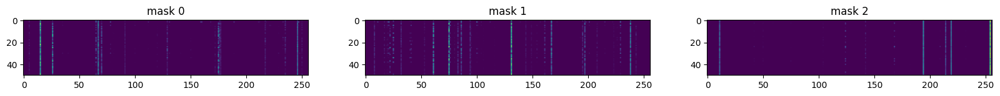

In [ ]:
fig, axs = plt.subplots(1, 3, figsize=(20,20))

for i in range(3):
    axs[i].imshow(unsupervised_masks[i][:50])
    axs[i].set_title(f"mask {i}")

In [ ]:
unsupervised_model.save_model('./test_pretrain')
loaded_pretrain = TabNetPretrainer()
loaded_pretrain.load_model('./test_pretrain.zip')

Successfully saved model at ./test_pretrain.zip


/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/abstract_model.py:82: UserWarning: Device used : cuda
  warnings.warn(f"Device used : {self.device}")


In [ ]:
clf_pretrained = TabNetMultiTaskClassifier(n_steps=1,
                                optimizer_fn=torch.optim.Adam,
                                optimizer_params=dict(lr=2e-2),
                                scheduler_params={"step_size":5,
                                                  "gamma":0.9},
                                scheduler_fn=torch.optim.lr_scheduler.StepLR,
                                mask_type='entmax',
                                lambda_sparse=0,

                      )

In [ ]:
clf_pretrained.fit(
    X_train=x_train_val.values, y_train=y_train_val.values.reshape(-1, 1),
    eval_set=[(x_train_val.values, y_train_val.values.reshape(-1, 1)), (x_val.values, y_val.values.reshape(-1, 1))],
    max_epochs=max_epochs ,
    eval_name=['train', 'val'],
    eval_metric=['balanced_accuracy'],
    patience=0,
    batch_size=1024,
    virtual_batch_size=128,
    num_workers=1,
    drop_last=False,
    from_unsupervised=loaded_pretrain,
)

/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/abstract_model.py:118: UserWarning: Pretraining: n_steps changed from 1 to 3
  warnings.warn(wrn_msg)
/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/abstract_model.py:687: UserWarning: No early stopping will be performed, last training weights will be used.
  warnings.warn(wrn_msg)
/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/abstract_model.py:248: UserWarning: Loading weights from unsupervised pretraining
  warnings.warn("Loading weights from unsupervised pretraining")


epoch 0  | loss: 1.99242 | train_balanced_accuracy: 0.21479 | val_balanced_accuracy: 0.24786 |  0:00:00s
epoch 1  | loss: 1.713   | train_balanced_accuracy: 0.21524 | val_balanced_accuracy: 0.20357 |  0:00:01s
epoch 2  | loss: 1.58434 | train_balanced_accuracy: 0.19864 | val_balanced_accuracy: 0.20476 |  0:00:02s
epoch 3  | loss: 1.5068  | train_balanced_accuracy: 0.23566 | val_balanced_accuracy: 0.22619 |  0:00:02s
epoch 4  | loss: 1.44101 | train_balanced_accuracy: 0.25792 | val_balanced_accuracy: 0.2619  |  0:00:03s
epoch 5  | loss: 1.39848 | train_balanced_accuracy: 0.28177 | val_balanced_accuracy: 0.22619 |  0:00:04s
epoch 6  | loss: 1.38283 | train_balanced_accuracy: 0.2908  | val_balanced_accuracy: 0.29762 |  0:00:05s
epoch 7  | loss: 1.35073 | train_balanced_accuracy: 0.25993 | val_balanced_accuracy: 0.28571 |  0:00:06s
epoch 8  | loss: 1.31472 | train_balanced_accuracy: 0.25    | val_balanced_accuracy: 0.2625  |  0:00:07s
epoch 9  | loss: 1.33509 | train_balanced_accuracy: 0.2

In [ ]:
pred_pretrained= clf_pretrained.predict(x_test.values)
tab_net_pretrained = []
for el in pred_pretrained[0]:
  tab_net_pretrained.append(int(el))

In [ ]:
accuracy_tabnet_pretrained = accuracy_score(y_test, tab_net_pretrained)
print(f"Accuracy: {accuracy_tabnet_pretrained}")

Accuracy: 0.29


# Реккурентная нейронная сеть LSTM

In [ ]:
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader

In [ ]:
class Dataset(torch.utils.data.Dataset):
  def __init__(self, data):
    self.data = data

  def __len__(self):
    return len(self.data)

  def __getitem__(self, idx):
    return self.data[idx]

def collate_fn(ditem):
  ci = torch.tensor([item['client_id'] for item in ditem], dtype = torch.double).reshape(-1, 1)
  td = pad_sequence([item['trans_date'] for item in ditem], batch_first = True).to(torch.double)
  group = pad_sequence([item['small_group'] for item in ditem], batch_first = True).to(torch.double)
  amount = pad_sequence([item['amount_rur'] for item in ditem], batch_first = True).to(torch.double)
  time = pad_sequence([item['event_time'] for item in ditem], batch_first = True).to(torch.double)
  target = torch.tensor([item['target'] for item in ditem], dtype = torch.double).reshape(-1, 1)
  return {'client_id' : ci,'trans_date': td, 'small_group': group, 'amount_rur':amount,  'event_time':time, 'target':target}



In [ ]:
train_dataset, val_dataset = train_test_split(dataset, test_size=0.2, random_state=42)

In [ ]:
train_targets = []
val_targets = []

In [ ]:
for i in train_dataset:
  for el, value in i.items():
    if el == 'target':
      train_targets.append(value)

for i in val_dataset:
  for el, value in i.items():
    if el == 'target':
      val_targets.append(value)

In [ ]:
len(train_targets), len(val_targets)

(400, 100)

In [ ]:
my_dataset_train = Dataset(train_dataset)
my_dataset_val = Dataset(val_dataset)

train_loader = DataLoader(my_dataset_train, batch_size=32, collate_fn = collate_fn)
val_loader = DataLoader(my_dataset_val, batch_size=32, collate_fn = collate_fn)
next(iter(train_loader))['target'].shape

torch.Size([32, 1])

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

class LSTMClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, dropout_prob=0.2):
        super(LSTMClassifier, self).__init__()
        self.entry = nn.Linear(input_size, hidden_size)
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(hidden_size, hidden_size)
        self.dropout = nn.Dropout(dropout_prob)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        client_id = x['client_id'].reshape(-1, 1).type(torch.FloatTensor)
        amount_rur = x['amount_rur'].type(torch.FloatTensor)[..., :1000]
        event_time = x['event_time'].type(torch.FloatTensor)[..., :1000]
        trans_date = x['trans_date'].type(torch.FloatTensor)[..., :1000]
        small_group = x['small_group'].type(torch.FloatTensor)[..., :1000]
        y = client_id  + amount_rur + event_time + trans_date + small_group
        y = self.entry(y)
        lstm_out, _ = self.lstm(y)
        output = self.dropout(lstm_out)
        output = self.fc(output)
        return output

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)

cuda:0


In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
input_size = 1000
hidden_size = 256
output_size = 4
model = LSTMClassifier(input_size, hidden_size, output_size)
criterion = nn.CrossEntropyLoss()
num_epochs = 2

optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = None


train_loss, val_loss, train_acc, val_acc = train(model, optimizer, criterion, scheduler, train_loader, torch.tensor(train_targets).reshape(-1, 1),
                                                 val_loader, torch.tensor(val_targets).reshape(-1, 1), num_epochs)

In [ ]:
my_dataset = Dataset(dataset)
loader = DataLoader(my_dataset, batch_size=32, collate_fn = collate_fn)
input_size = 1147
hidden_size = 256
output_size = 4
model = LSTMClassifier(input_size,hidden_size , output_size)

In [ ]:
x_train, y_train = train_df[embed_columns], train_df['target']
x_test, y_test = test_df[embed_columns], test_df['target']
x_train_val, x_val, y_train_val, y_val = train_test_split(x_train,y_train, test_size=0.2, random_state=42, stratify=y_train)

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)

cuda:0


In [ ]:
def plot_losses(train_losses, train_metrics, val_losses, val_metrics):
    clear_output()
    fig, axs = plt.subplots(1, 2, figsize=(15, 5))
    axs[0].plot(range(1, len(train_losses) + 1), train_losses, label='train')
    axs[0].plot(range(1, len(val_losses) + 1), val_losses, label='val')
    axs[1].plot(range(1, len(train_metrics) + 1), train_metrics, label='train')
    axs[1].plot(range(1, len(val_metrics) + 1), val_metrics, label='val')

    if max(train_losses) / min(train_losses) > 10:
        axs[0].set_yscale('log')

    if max(train_metrics) / min(train_metrics) > 10:
        axs[0].set_yscale('log')

    for ax in axs:
        ax.set_xlabel('epoch')
        ax.legend()

    axs[0].set_ylabel('loss')
    axs[1].set_ylabel('Accuracy')
    plt.show()

In [ ]:
@torch.no_grad()
def test(model,criterion, loader, target, tqdm_desc):
    model.eval()
    acc = 0.0
    loss = 0.0
    for data, target in tqdm(zip(loader, target), desc=tqdm_desc):
        # data = data.to(device)
        # target = target.to(device)

        output = model(data)

        cur_loss = criterion(output.squeeze(), target)

        acc += (output.argmax(dim=1) == target).sum().item()
        loss += cur_loss.item() * target.shape[0]

    acc /= len(val_loader.dataset)
    loss /= len(val_loader.dataset)

    return loss, acc

def train_epoch(model, optimizer, criterion, train_loader,target, tqdm_desc):
    model.train()
    acc = 0.0
    loss = 0.0
    for data, target in tqdm(zip(train_loader, target), desc=tqdm_desc):
        data = data.to(device)
        target = target.to(device)

        optimizer.zero_grad()
        output = model(data)

        l = criterion(output.squeeze(), target)
        l.backward()

        acc += (output.argmax(dim=1) == target).sum()
        loss += l.item() * target.shape[0]
        optimizer.step()
    acc /= len(train_loader.dataset)
    loss /= len(train_loader.dataset)
    return loss, acc

def train(model, optimizer, criterion, scheduler,train_loader, train_targets,  val_loader, val_targets, n_epochs):
    train_loss = 0.0
    train_acc = 0.0

    val_loss = 0.0
    val_acc = 0.0
    train_losses = []
    val_losees = []
    train_accuracies = []
    val_accuracies = []
    for epoch in range(n_epochs):
        train_loss, train_acc = train_epoch(model, optimizer, criterion, train_loader, train_targets ,f'Training epoch {epoch + 1} /{n_epochs}')
        val_loss, val_acc = test(model,criterion, val_loader,  val_targets,f'Validating epoch {epoch + 1}/{n_epochs}')

        train_losses.append(train_loss)
        train_accuracies.append(train_acc)
        val_accuracies.append(val_acc)
        val_losees.append(val_loss)



        print(f"Epoch {epoch + 1}")
        print(f" train loss: {train_loss}, train acc: {train_acc}")
        print(f" val loss: {val_loss}, val acc: {val_acc}\n")

        if scheduler is not None:
            scheduler.step(val_loss)
    return train_losses, val_losees, train_accuracies, val_accuracies



In [ ]:
num_epochs = 100

batch_size = 64
dropout_prob = 0.5
hidden_size = 512

input_size = x_train.shape[1]
output_size = y_train.max().item() + 1

train_dataset = TensorDataset(torch.tensor(x_train_val.values, dtype=torch.float32), torch.tensor(y_train_val.values, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(x_val.values, dtype=torch.float32), torch.tensor(y_val.values, dtype=torch.long))


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

model = LSTMClassifier(input_size, hidden_size, output_size, dropout_prob).to(device)
criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = None



train_loss, val_loss, train_acc, val_acc = train(model, optimizer, criterion, scheduler, train_loader, val_loader, num_epochs)


Validating epoch 1/100: 100%|██████████| 2/2 [00:00<00:00, 437.68it/s]


Epoch 1
 train loss: 1.3907836437225343, train acc: 0.2906250059604645
 val loss: 1.3875291347503662, val acc: 0.25



Validating epoch 2/100: 100%|██████████| 2/2 [00:00<00:00, 431.22it/s]


Epoch 2
 train loss: 1.393286895751953, train acc: 0.26250001788139343
 val loss: 1.3790243148803711, val acc: 0.275



Validating epoch 3/100: 100%|██████████| 2/2 [00:00<00:00, 399.19it/s]


Epoch 3
 train loss: 1.3840436935424805, train acc: 0.28437501192092896
 val loss: 1.379595732688904, val acc: 0.275



Validating epoch 4/100: 100%|██████████| 2/2 [00:00<00:00, 410.58it/s]


Epoch 4
 train loss: 1.392524242401123, train acc: 0.2593750059604645
 val loss: 1.3767810583114624, val acc: 0.25



Validating epoch 5/100: 100%|██████████| 2/2 [00:00<00:00, 424.85it/s]


Epoch 5
 train loss: 1.3748974800109863, train acc: 0.30937501788139343
 val loss: 1.3702045917510985, val acc: 0.2875



Validating epoch 6/100: 100%|██████████| 2/2 [00:00<00:00, 425.56it/s]


Epoch 6
 train loss: 1.3782865762710572, train acc: 0.328125
 val loss: 1.3690815210342406, val acc: 0.3



Validating epoch 7/100: 100%|██████████| 2/2 [00:00<00:00, 375.23it/s]


Epoch 7
 train loss: 1.384306287765503, train acc: 0.2750000059604645
 val loss: 1.364785122871399, val acc: 0.3



Validating epoch 8/100: 100%|██████████| 2/2 [00:00<00:00, 231.60it/s]


Epoch 8
 train loss: 1.361174750328064, train acc: 0.30000001192092896
 val loss: 1.3594164371490478, val acc: 0.2625



Validating epoch 9/100: 100%|██████████| 2/2 [00:00<00:00, 377.25it/s]


Epoch 9
 train loss: 1.3727830171585083, train acc: 0.26875001192092896
 val loss: 1.3583644866943358, val acc: 0.325



Validating epoch 10/100: 100%|██████████| 2/2 [00:00<00:00, 397.41it/s]


Epoch 10
 train loss: 1.3604605436325072, train acc: 0.3343749940395355
 val loss: 1.3521919250488281, val acc: 0.2625



Validating epoch 11/100: 100%|██████████| 2/2 [00:00<00:00, 420.17it/s]


Epoch 11
 train loss: 1.3611809968948365, train acc: 0.30937501788139343
 val loss: 1.3486387014389039, val acc: 0.3



Validating epoch 12/100: 100%|██████████| 2/2 [00:00<00:00, 357.17it/s]


Epoch 12
 train loss: 1.3562739133834838, train acc: 0.30937501788139343
 val loss: 1.3422102451324462, val acc: 0.3125



Validating epoch 13/100: 100%|██████████| 2/2 [00:00<00:00, 357.49it/s]


Epoch 13
 train loss: 1.3535897731781006, train acc: 0.328125
 val loss: 1.3383817672729492, val acc: 0.275



Validating epoch 14/100: 100%|██████████| 2/2 [00:00<00:00, 206.90it/s]


Epoch 14
 train loss: 1.3420786142349244, train acc: 0.34062501788139343
 val loss: 1.330926775932312, val acc: 0.3375



Validating epoch 15/100: 100%|██████████| 2/2 [00:00<00:00, 310.76it/s]


Epoch 15
 train loss: 1.3383122205734252, train acc: 0.3343749940395355
 val loss: 1.3250249862670898, val acc: 0.325



Validating epoch 16/100: 100%|██████████| 2/2 [00:00<00:00, 318.97it/s]


Epoch 16
 train loss: 1.3476333379745484, train acc: 0.3125
 val loss: 1.319787359237671, val acc: 0.3375



Validating epoch 17/100: 100%|██████████| 2/2 [00:00<00:00, 305.69it/s]


Epoch 17
 train loss: 1.336428427696228, train acc: 0.30000001192092896
 val loss: 1.318381953239441, val acc: 0.35



Validating epoch 18/100: 100%|██████████| 2/2 [00:00<00:00, 336.62it/s]


Epoch 18
 train loss: 1.336104440689087, train acc: 0.3531250059604645
 val loss: 1.3112787008285522, val acc: 0.3375



Validating epoch 19/100: 100%|██████████| 2/2 [00:00<00:00, 329.09it/s]


Epoch 19
 train loss: 1.3465744495391845, train acc: 0.3375000059604645
 val loss: 1.3159075260162354, val acc: 0.3625



Validating epoch 20/100: 100%|██████████| 2/2 [00:00<00:00, 252.08it/s]


Epoch 20
 train loss: 1.338052248954773, train acc: 0.34687501192092896
 val loss: 1.3129738569259644, val acc: 0.325



Validating epoch 21/100: 100%|██████████| 2/2 [00:00<00:00, 331.23it/s]


Epoch 21
 train loss: 1.3129024744033813, train acc: 0.34375
 val loss: 1.304325532913208, val acc: 0.3375



Validating epoch 22/100: 100%|██████████| 2/2 [00:00<00:00, 249.70it/s]


Epoch 22
 train loss: 1.3188119649887085, train acc: 0.390625
 val loss: 1.2977761030197144, val acc: 0.3625



Validating epoch 23/100: 100%|██████████| 2/2 [00:00<00:00, 361.10it/s]


Epoch 23
 train loss: 1.3315478563308716, train acc: 0.3062500059604645
 val loss: 1.295968770980835, val acc: 0.3625



Validating epoch 24/100: 100%|██████████| 2/2 [00:00<00:00, 198.66it/s]


Epoch 24
 train loss: 1.3176172256469727, train acc: 0.3531250059604645
 val loss: 1.2931020975112915, val acc: 0.375



Validating epoch 25/100: 100%|██████████| 2/2 [00:00<00:00, 200.99it/s]


Epoch 25
 train loss: 1.3282825231552124, train acc: 0.3343749940395355
 val loss: 1.2944859504699706, val acc: 0.3625



Validating epoch 26/100: 100%|██████████| 2/2 [00:00<00:00, 321.87it/s]


Epoch 26
 train loss: 1.3279350996017456, train acc: 0.34375
 val loss: 1.2981231212615967, val acc: 0.35



Validating epoch 27/100: 100%|██████████| 2/2 [00:00<00:00, 371.64it/s]


Epoch 27
 train loss: 1.3166124820709229, train acc: 0.32500001788139343
 val loss: 1.2946526050567626, val acc: 0.375



Validating epoch 28/100: 100%|██████████| 2/2 [00:00<00:00, 374.12it/s]


Epoch 28
 train loss: 1.3224016427993774, train acc: 0.3499999940395355
 val loss: 1.2914021730422973, val acc: 0.3125



Validating epoch 29/100: 100%|██████████| 2/2 [00:00<00:00, 328.63it/s]


Epoch 29
 train loss: 1.3255926847457886, train acc: 0.34062501788139343
 val loss: 1.2940218210220338, val acc: 0.35



Validating epoch 30/100: 100%|██████████| 2/2 [00:00<00:00, 352.21it/s]


Epoch 30
 train loss: 1.3157468557357788, train acc: 0.34375
 val loss: 1.2893814325332642, val acc: 0.35



Validating epoch 31/100: 100%|██████████| 2/2 [00:00<00:00, 386.96it/s]


Epoch 31
 train loss: 1.305325412750244, train acc: 0.3656249940395355
 val loss: 1.2832048654556274, val acc: 0.375



Validating epoch 32/100: 100%|██████████| 2/2 [00:00<00:00, 339.80it/s]


Epoch 32
 train loss: 1.3238556146621705, train acc: 0.35625001788139343
 val loss: 1.2904149293899536, val acc: 0.3875



Validating epoch 33/100: 100%|██████████| 2/2 [00:00<00:00, 357.94it/s]


Epoch 33
 train loss: 1.3050664901733398, train acc: 0.37812501192092896
 val loss: 1.2844699144363403, val acc: 0.375



Validating epoch 34/100: 100%|██████████| 2/2 [00:00<00:00, 371.34it/s]


Epoch 34
 train loss: 1.3039121627807617, train acc: 0.3499999940395355
 val loss: 1.2821188926696778, val acc: 0.425



Validating epoch 35/100: 100%|██████████| 2/2 [00:00<00:00, 253.95it/s]


Epoch 35
 train loss: 1.3107529163360596, train acc: 0.34062501788139343
 val loss: 1.2843095302581786, val acc: 0.35



Validating epoch 36/100: 100%|██████████| 2/2 [00:00<00:00, 213.09it/s]


Epoch 36
 train loss: 1.3081986904144287, train acc: 0.375
 val loss: 1.2850857019424438, val acc: 0.3375



Validating epoch 37/100: 100%|██████████| 2/2 [00:00<00:00, 289.25it/s]


Epoch 37
 train loss: 1.3079972982406616, train acc: 0.3499999940395355
 val loss: 1.282371711730957, val acc: 0.375



Validating epoch 38/100: 100%|██████████| 2/2 [00:00<00:00, 218.92it/s]


Epoch 38
 train loss: 1.298556661605835, train acc: 0.36250001192092896
 val loss: 1.2835301637649537, val acc: 0.375



Validating epoch 39/100: 100%|██████████| 2/2 [00:00<00:00, 363.47it/s]


Epoch 39
 train loss: 1.3047362565994263, train acc: 0.3687500059604645
 val loss: 1.2789432048797607, val acc: 0.325



Validating epoch 40/100: 100%|██████████| 2/2 [00:00<00:00, 240.40it/s]


Epoch 40
 train loss: 1.2869884967803955, train acc: 0.38750001788139343
 val loss: 1.2802992343902588, val acc: 0.4



Validating epoch 41/100: 100%|██████████| 2/2 [00:00<00:00, 220.09it/s]


Epoch 41
 train loss: 1.3076565265655518, train acc: 0.34375
 val loss: 1.2759878158569335, val acc: 0.35



Validating epoch 42/100: 100%|██████████| 2/2 [00:00<00:00, 334.17it/s]


Epoch 42
 train loss: 1.2860940456390382, train acc: 0.3843750059604645
 val loss: 1.27333242893219, val acc: 0.35



Validating epoch 43/100: 100%|██████████| 2/2 [00:00<00:00, 185.96it/s]


Epoch 43
 train loss: 1.2869642496109008, train acc: 0.38750001788139343
 val loss: 1.2733808279037475, val acc: 0.3875



Validating epoch 44/100: 100%|██████████| 2/2 [00:00<00:00, 285.73it/s]


Epoch 44
 train loss: 1.3037109375, train acc: 0.375
 val loss: 1.276507019996643, val acc: 0.375



Validating epoch 45/100: 100%|██████████| 2/2 [00:00<00:00, 407.93it/s]


Epoch 45
 train loss: 1.3004197835922242, train acc: 0.375
 val loss: 1.2803648233413696, val acc: 0.375



Validating epoch 46/100: 100%|██████████| 2/2 [00:00<00:00, 186.01it/s]


Epoch 46
 train loss: 1.2918710470199586, train acc: 0.375
 val loss: 1.2760570049285889, val acc: 0.375



Validating epoch 47/100: 100%|██████████| 2/2 [00:00<00:00, 204.62it/s]


Epoch 47
 train loss: 1.2994616985321046, train acc: 0.3687500059604645
 val loss: 1.2717239379882812, val acc: 0.3



Validating epoch 48/100: 100%|██████████| 2/2 [00:00<00:00, 292.70it/s]


Epoch 48
 train loss: 1.2889310359954833, train acc: 0.3375000059604645
 val loss: 1.2744249820709228, val acc: 0.425



Validating epoch 49/100: 100%|██████████| 2/2 [00:00<00:00, 232.03it/s]


Epoch 49
 train loss: 1.282274055480957, train acc: 0.38750001788139343
 val loss: 1.2715624570846558, val acc: 0.3625



Validating epoch 50/100: 100%|██████████| 2/2 [00:00<00:00, 358.37it/s]


Epoch 50
 train loss: 1.2818548679351807, train acc: 0.3656249940395355
 val loss: 1.2752238750457763, val acc: 0.3375



Validating epoch 51/100: 100%|██████████| 2/2 [00:00<00:00, 355.63it/s]


Epoch 51
 train loss: 1.2752127170562744, train acc: 0.40937501192092896
 val loss: 1.2766263723373412, val acc: 0.3875



Validating epoch 52/100: 100%|██████████| 2/2 [00:00<00:00, 371.28it/s]


Epoch 52
 train loss: 1.2754438161849975, train acc: 0.3499999940395355
 val loss: 1.2768394231796265, val acc: 0.4



Validating epoch 53/100: 100%|██████████| 2/2 [00:00<00:00, 358.14it/s]


Epoch 53
 train loss: 1.2791060924530029, train acc: 0.3687500059604645
 val loss: 1.2772026062011719, val acc: 0.3625



Validating epoch 54/100: 100%|██████████| 2/2 [00:00<00:00, 380.06it/s]


Epoch 54
 train loss: 1.2649197340011598, train acc: 0.37812501192092896
 val loss: 1.279833769798279, val acc: 0.375



Validating epoch 55/100: 100%|██████████| 2/2 [00:00<00:00, 356.54it/s]


Epoch 55
 train loss: 1.2764810562133788, train acc: 0.37812501192092896
 val loss: 1.2698756456375122, val acc: 0.4



Validating epoch 56/100: 100%|██████████| 2/2 [00:00<00:00, 351.86it/s]


Epoch 56
 train loss: 1.2908208131790162, train acc: 0.37812501192092896
 val loss: 1.268684196472168, val acc: 0.3875



Validating epoch 57/100: 100%|██████████| 2/2 [00:00<00:00, 314.79it/s]


Epoch 57
 train loss: 1.2876666069030762, train acc: 0.3812499940395355
 val loss: 1.2753289699554444, val acc: 0.35



Validating epoch 58/100: 100%|██████████| 2/2 [00:00<00:00, 336.59it/s]


Epoch 58
 train loss: 1.2910468101501464, train acc: 0.3968749940395355
 val loss: 1.267069363594055, val acc: 0.4125



Validating epoch 59/100: 100%|██████████| 2/2 [00:00<00:00, 190.86it/s]


Epoch 59
 train loss: 1.2640974044799804, train acc: 0.3968749940395355
 val loss: 1.2630130290985107, val acc: 0.35



Validating epoch 60/100: 100%|██████████| 2/2 [00:00<00:00, 361.19it/s]


Epoch 60
 train loss: 1.2783660173416138, train acc: 0.375
 val loss: 1.26410870552063, val acc: 0.4



Validating epoch 61/100: 100%|██████████| 2/2 [00:00<00:00, 179.39it/s]


Epoch 61
 train loss: 1.2665370941162108, train acc: 0.4156250059604645
 val loss: 1.2613193273544312, val acc: 0.3875



Validating epoch 62/100: 100%|██████████| 2/2 [00:00<00:00, 357.62it/s]


Epoch 62
 train loss: 1.2627749919891358, train acc: 0.421875
 val loss: 1.261755681037903, val acc: 0.375



Validating epoch 63/100: 100%|██████████| 2/2 [00:00<00:00, 345.15it/s]


Epoch 63
 train loss: 1.2760413885116577, train acc: 0.3812499940395355
 val loss: 1.2625527858734131, val acc: 0.3875



Validating epoch 64/100: 100%|██████████| 2/2 [00:00<00:00, 350.17it/s]


Epoch 64
 train loss: 1.2595943450927733, train acc: 0.37812501192092896
 val loss: 1.2601455211639405, val acc: 0.3625



Validating epoch 65/100: 100%|██████████| 2/2 [00:00<00:00, 340.52it/s]


Epoch 65
 train loss: 1.2571302890777587, train acc: 0.4281249940395355
 val loss: 1.2659653663635253, val acc: 0.3875



Validating epoch 66/100: 100%|██████████| 2/2 [00:00<00:00, 176.85it/s]


Epoch 66
 train loss: 1.2405389308929444, train acc: 0.44062501192092896
 val loss: 1.2608784437179565, val acc: 0.4



Validating epoch 67/100: 100%|██████████| 2/2 [00:00<00:00, 317.41it/s]


Epoch 67
 train loss: 1.2626695871353149, train acc: 0.40312501788139343
 val loss: 1.2606668710708617, val acc: 0.425



Validating epoch 68/100: 100%|██████████| 2/2 [00:00<00:00, 365.80it/s]


Epoch 68
 train loss: 1.2584695100784302, train acc: 0.4312500059604645
 val loss: 1.258148717880249, val acc: 0.3875



Validating epoch 69/100: 100%|██████████| 2/2 [00:00<00:00, 383.76it/s]


Epoch 69
 train loss: 1.2535223960876465, train acc: 0.4312500059604645
 val loss: 1.2600002527236938, val acc: 0.4



Validating epoch 70/100: 100%|██████████| 2/2 [00:00<00:00, 316.96it/s]


Epoch 70
 train loss: 1.2602926969528199, train acc: 0.40937501192092896
 val loss: 1.2598048210144044, val acc: 0.4



Validating epoch 71/100: 100%|██████████| 2/2 [00:00<00:00, 333.84it/s]


Epoch 71
 train loss: 1.2728318929672242, train acc: 0.39375001192092896
 val loss: 1.2704241752624512, val acc: 0.3625



Validating epoch 72/100: 100%|██████████| 2/2 [00:00<00:00, 259.14it/s]


Epoch 72
 train loss: 1.2437260389328002, train acc: 0.39375001192092896
 val loss: 1.262644147872925, val acc: 0.375



Validating epoch 73/100: 100%|██████████| 2/2 [00:00<00:00, 178.16it/s]


Epoch 73
 train loss: 1.235794472694397, train acc: 0.40625
 val loss: 1.261720395088196, val acc: 0.375



Validating epoch 74/100: 100%|██████████| 2/2 [00:00<00:00, 249.08it/s]


Epoch 74
 train loss: 1.2437343835830688, train acc: 0.4593749940395355
 val loss: 1.2700940370559692, val acc: 0.3875



Validating epoch 75/100: 100%|██████████| 2/2 [00:00<00:00, 188.04it/s]


Epoch 75
 train loss: 1.2556066751480102, train acc: 0.40937501192092896
 val loss: 1.265531635284424, val acc: 0.4



Validating epoch 76/100: 100%|██████████| 2/2 [00:00<00:00, 210.52it/s]


Epoch 76
 train loss: 1.258469033241272, train acc: 0.390625
 val loss: 1.2647437572479248, val acc: 0.4



Validating epoch 77/100: 100%|██████████| 2/2 [00:00<00:00, 246.88it/s]


Epoch 77
 train loss: 1.231046772003174, train acc: 0.4437499940395355
 val loss: 1.259579062461853, val acc: 0.3625



Validating epoch 78/100: 100%|██████████| 2/2 [00:00<00:00, 299.81it/s]


Epoch 78
 train loss: 1.2373698472976684, train acc: 0.41875001788139343
 val loss: 1.2574225664138794, val acc: 0.375



Validating epoch 79/100: 100%|██████████| 2/2 [00:00<00:00, 357.95it/s]


Epoch 79
 train loss: 1.2343434810638427, train acc: 0.3968749940395355
 val loss: 1.258753490447998, val acc: 0.4



Validating epoch 80/100: 100%|██████████| 2/2 [00:00<00:00, 235.65it/s]


Epoch 80
 train loss: 1.2442145347595215, train acc: 0.4156250059604645
 val loss: 1.2618173599243163, val acc: 0.3875



Validating epoch 81/100: 100%|██████████| 2/2 [00:00<00:00, 315.20it/s]


Epoch 81
 train loss: 1.2550702095031738, train acc: 0.40937501192092896
 val loss: 1.2604350566864013, val acc: 0.4



Validating epoch 82/100: 100%|██████████| 2/2 [00:00<00:00, 234.67it/s]


Epoch 82
 train loss: 1.2567124843597413, train acc: 0.3843750059604645
 val loss: 1.2671919107437133, val acc: 0.4125



Validating epoch 83/100: 100%|██████████| 2/2 [00:00<00:00, 194.18it/s]


Epoch 83
 train loss: 1.2361917734146117, train acc: 0.4124999940395355
 val loss: 1.264429473876953, val acc: 0.375



Validating epoch 84/100: 100%|██████████| 2/2 [00:00<00:00, 251.80it/s]


Epoch 84
 train loss: 1.2267009258270263, train acc: 0.42500001192092896
 val loss: 1.2620397090911866, val acc: 0.4



Validating epoch 85/100: 100%|██████████| 2/2 [00:00<00:00, 178.29it/s]


Epoch 85
 train loss: 1.2511326789855957, train acc: 0.375
 val loss: 1.2637518167495727, val acc: 0.375



Validating epoch 86/100: 100%|██████████| 2/2 [00:00<00:00, 226.13it/s]


Epoch 86
 train loss: 1.2500150680541993, train acc: 0.3968749940395355
 val loss: 1.2603533029556275, val acc: 0.4



Validating epoch 87/100: 100%|██████████| 2/2 [00:00<00:00, 164.32it/s]


Epoch 87
 train loss: 1.2307855606079101, train acc: 0.4281249940395355
 val loss: 1.2622950315475463, val acc: 0.3875



Validating epoch 88/100: 100%|██████████| 2/2 [00:00<00:00, 316.05it/s]


Epoch 88
 train loss: 1.2260210752487182, train acc: 0.4124999940395355
 val loss: 1.258850598335266, val acc: 0.425



Validating epoch 89/100: 100%|██████████| 2/2 [00:00<00:00, 323.98it/s]


Epoch 89
 train loss: 1.227911615371704, train acc: 0.3843750059604645
 val loss: 1.261052680015564, val acc: 0.4125



Validating epoch 90/100: 100%|██████████| 2/2 [00:00<00:00, 209.36it/s]


Epoch 90
 train loss: 1.2433447360992431, train acc: 0.390625
 val loss: 1.2609633922576904, val acc: 0.375



Validating epoch 91/100: 100%|██████████| 2/2 [00:00<00:00, 414.95it/s]


Epoch 91
 train loss: 1.2243720769882203, train acc: 0.4312500059604645
 val loss: 1.2702392578125, val acc: 0.3875



Validating epoch 92/100: 100%|██████████| 2/2 [00:00<00:00, 376.66it/s]


Epoch 92
 train loss: 1.207583737373352, train acc: 0.4375
 val loss: 1.2562202215194702, val acc: 0.4



Validating epoch 93/100: 100%|██████████| 2/2 [00:00<00:00, 336.00it/s]


Epoch 93
 train loss: 1.2339791297912597, train acc: 0.4468750059604645
 val loss: 1.2591949939727782, val acc: 0.35



Validating epoch 94/100: 100%|██████████| 2/2 [00:00<00:00, 345.11it/s]


Epoch 94
 train loss: 1.2410512685775756, train acc: 0.4156250059604645
 val loss: 1.2581926822662353, val acc: 0.3875



Validating epoch 95/100: 100%|██████████| 2/2 [00:00<00:00, 288.08it/s]


Epoch 95
 train loss: 1.2459527492523192, train acc: 0.38750001788139343
 val loss: 1.2653164625167848, val acc: 0.375



Validating epoch 96/100: 100%|██████████| 2/2 [00:00<00:00, 368.81it/s]


Epoch 96
 train loss: 1.2298081874847413, train acc: 0.44062501192092896
 val loss: 1.2618242979049683, val acc: 0.375



Validating epoch 97/100: 100%|██████████| 2/2 [00:00<00:00, 379.90it/s]


Epoch 97
 train loss: 1.2244369983673096, train acc: 0.41875001788139343
 val loss: 1.2690145254135132, val acc: 0.375



Validating epoch 98/100: 100%|██████████| 2/2 [00:00<00:00, 375.82it/s]


Epoch 98
 train loss: 1.2219049215316773, train acc: 0.4312500059604645
 val loss: 1.2568439960479736, val acc: 0.4



Validating epoch 99/100: 100%|██████████| 2/2 [00:00<00:00, 346.36it/s]


Epoch 99
 train loss: 1.222948718070984, train acc: 0.42500001192092896
 val loss: 1.2548679113388062, val acc: 0.375



Validating epoch 100/100: 100%|██████████| 2/2 [00:00<00:00, 342.07it/s]


Epoch 100
 train loss: 1.1881886720657349, train acc: 0.45625001192092896
 val loss: 1.2527617692947388, val acc: 0.3875



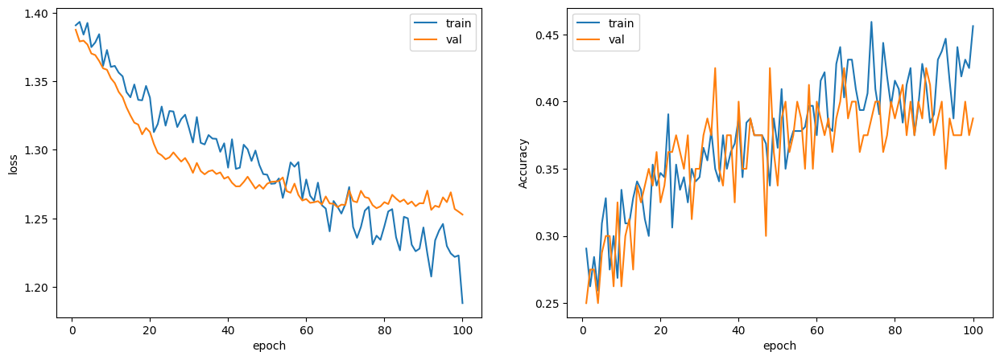

In [ ]:
train_acc_numpy = [tensor.cpu() for tensor in train_acc]
train_acc_numpy = np.array(train_acc_numpy)

plot_losses(train_loss, train_acc_numpy, val_loss, val_acc)


In [ ]:
@torch.no_grad()
def predict(model, test_loader):
    model.eval()
    prediction = []

    for data, target in tqdm(test_loader, desc='Testing'):
        data = data.to(device)

        output = model(data)
        probabilities = torch.softmax(output, dim=1)
        prediction.append(probabilities)


    return prediction

In [ ]:
teset_dataset = TensorDataset(torch.tensor(x_test.values, dtype=torch.float32), torch.tensor(y_test.values, dtype=torch.long))

test_loader = DataLoader(teset_dataset, batch_size=batch_size, shuffle=False)

preds = predict(model,test_loader)




Testing: 100%|██████████| 2/2 [00:00<00:00, 341.89it/s]


In [ ]:
conc_preds = torch.cat(preds, dim=0)
res = torch.argmax(conc_preds, dim=1)
res = res.cpu().numpy()

In [ ]:
acc = accuracy_score(y_test, res)
print(f"Accuracy: {acc}")

Accuracy: 0.28


## Попробуем другой оптимайзер

In [ ]:
num_epochs = 200

batch_size = 64
dropout_prob = 0.5
hidden_size = 512

input_size = x_train.shape[1]
output_size = y_train.max().item() + 1

train_dataset = TensorDataset(torch.tensor(x_train_val.values, dtype=torch.float32), torch.tensor(y_train_val.values, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(x_val.values, dtype=torch.float32), torch.tensor(y_val.values, dtype=torch.long))


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

model = LSTMClassifier(input_size, hidden_size, output_size, dropout_prob).to(device)
criterion = nn.CrossEntropyLoss()

optimizer = optim.SGD(model.parameters(), lr=0.1, momentum=0.9)
scheduler = None



train_loss, val_loss, train_acc, val_acc = train(model, optimizer, criterion, scheduler, train_loader, val_loader, num_epochs)


Validating epoch 1/200: 100%|██████████| 2/2 [00:00<00:00, 414.33it/s]


Epoch 1
 train loss: 1.3852332830429077, train acc: 0.26875001192092896
 val loss: 1.3841734170913695, val acc: 0.275



Validating epoch 2/200: 100%|██████████| 2/2 [00:00<00:00, 456.22it/s]


Epoch 2
 train loss: 1.3885125398635865, train acc: 0.2718749940395355
 val loss: 1.3808359384536744, val acc: 0.2625



Validating epoch 3/200: 100%|██████████| 2/2 [00:00<00:00, 401.98it/s]


Epoch 3
 train loss: 1.3815242767333984, train acc: 0.265625
 val loss: 1.3799468994140625, val acc: 0.3



Validating epoch 4/200: 100%|██████████| 2/2 [00:00<00:00, 428.10it/s]


Epoch 4
 train loss: 1.3956822156906128, train acc: 0.27812501788139343
 val loss: 1.3869941473007201, val acc: 0.275



Validating epoch 5/200: 100%|██████████| 2/2 [00:00<00:00, 447.39it/s]


Epoch 5
 train loss: 1.3849898338317872, train acc: 0.2593750059604645
 val loss: 1.387219738960266, val acc: 0.25



Validating epoch 6/200: 100%|██████████| 2/2 [00:00<00:00, 387.39it/s]


Epoch 6
 train loss: 1.4083197832107544, train acc: 0.22500000894069672
 val loss: 1.3818986892700196, val acc: 0.2375



Validating epoch 7/200: 100%|██████████| 2/2 [00:00<00:00, 451.36it/s]


Epoch 7
 train loss: 1.387569499015808, train acc: 0.27812501788139343
 val loss: 1.3792901039123535, val acc: 0.275



Validating epoch 8/200: 100%|██████████| 2/2 [00:00<00:00, 408.86it/s]


Epoch 8
 train loss: 1.3790358066558839, train acc: 0.28125
 val loss: 1.3810765266418457, val acc: 0.275



Validating epoch 9/200: 100%|██████████| 2/2 [00:00<00:00, 371.97it/s]


Epoch 9
 train loss: 1.411341094970703, train acc: 0.2593750059604645
 val loss: 1.3772723436355592, val acc: 0.275



Validating epoch 10/200: 100%|██████████| 2/2 [00:00<00:00, 335.69it/s]


Epoch 10
 train loss: 1.4146518945693969, train acc: 0.28437501192092896
 val loss: 1.3714468240737916, val acc: 0.275



Validating epoch 11/200: 100%|██████████| 2/2 [00:00<00:00, 135.35it/s]


Epoch 11
 train loss: 1.3971554279327392, train acc: 0.27812501788139343
 val loss: 1.3700231313705444, val acc: 0.2875



Validating epoch 12/200: 100%|██████████| 2/2 [00:00<00:00, 228.86it/s]


Epoch 12
 train loss: 1.381955862045288, train acc: 0.2718749940395355
 val loss: 1.3708882331848145, val acc: 0.3375



Validating epoch 13/200: 100%|██████████| 2/2 [00:00<00:00, 199.28it/s]


Epoch 13
 train loss: 1.374888277053833, train acc: 0.296875
 val loss: 1.358612561225891, val acc: 0.2625



Validating epoch 14/200: 100%|██████████| 2/2 [00:00<00:00, 339.28it/s]


Epoch 14
 train loss: 1.3834835052490235, train acc: 0.2906250059604645
 val loss: 1.3571402072906493, val acc: 0.3



Validating epoch 15/200: 100%|██████████| 2/2 [00:00<00:00, 332.91it/s]


Epoch 15
 train loss: 1.3880324363708496, train acc: 0.23125000298023224
 val loss: 1.3514408349990845, val acc: 0.325



Validating epoch 16/200: 100%|██████████| 2/2 [00:00<00:00, 343.39it/s]


Epoch 16
 train loss: 1.3885389804840087, train acc: 0.2593750059604645
 val loss: 1.34775390625, val acc: 0.325



Validating epoch 17/200: 100%|██████████| 2/2 [00:00<00:00, 230.25it/s]


Epoch 17
 train loss: 1.3838173627853394, train acc: 0.2906250059604645
 val loss: 1.3488349199295044, val acc: 0.2875



Validating epoch 18/200: 100%|██████████| 2/2 [00:00<00:00, 397.53it/s]


Epoch 18
 train loss: 1.356109070777893, train acc: 0.3031249940395355
 val loss: 1.345022964477539, val acc: 0.325



Validating epoch 19/200: 100%|██████████| 2/2 [00:00<00:00, 260.64it/s]


Epoch 19
 train loss: 1.3679733991622924, train acc: 0.31562501192092896
 val loss: 1.344694399833679, val acc: 0.275



Validating epoch 20/200: 100%|██████████| 2/2 [00:00<00:00, 341.11it/s]


Epoch 20
 train loss: 1.370659351348877, train acc: 0.3375000059604645
 val loss: 1.3415079355239867, val acc: 0.4



Validating epoch 21/200: 100%|██████████| 2/2 [00:00<00:00, 316.69it/s]


Epoch 21
 train loss: 1.3864053726196288, train acc: 0.28125
 val loss: 1.3331225156784057, val acc: 0.3375



Validating epoch 22/200: 100%|██████████| 2/2 [00:00<00:00, 266.97it/s]


Epoch 22
 train loss: 1.3656181335449218, train acc: 0.2718749940395355
 val loss: 1.3284817457199096, val acc: 0.3125



Validating epoch 23/200: 100%|██████████| 2/2 [00:00<00:00, 379.75it/s]


Epoch 23
 train loss: 1.3913760900497436, train acc: 0.3031249940395355
 val loss: 1.3316993713378906, val acc: 0.325



Validating epoch 24/200: 100%|██████████| 2/2 [00:00<00:00, 319.35it/s]


Epoch 24
 train loss: 1.384822463989258, train acc: 0.3031249940395355
 val loss: 1.339300775527954, val acc: 0.3375



Validating epoch 25/200: 100%|██████████| 2/2 [00:00<00:00, 340.72it/s]


Epoch 25
 train loss: 1.403139877319336, train acc: 0.296875
 val loss: 1.3363906145095825, val acc: 0.3125



Validating epoch 26/200: 100%|██████████| 2/2 [00:00<00:00, 371.98it/s]


Epoch 26
 train loss: 1.3588285446166992, train acc: 0.33125001192092896
 val loss: 1.323154878616333, val acc: 0.375



Validating epoch 27/200: 100%|██████████| 2/2 [00:00<00:00, 340.78it/s]


Epoch 27
 train loss: 1.3662389039993286, train acc: 0.3218750059604645
 val loss: 1.3596785545349122, val acc: 0.2875



Validating epoch 28/200: 100%|██████████| 2/2 [00:00<00:00, 355.40it/s]


Epoch 28
 train loss: 1.3775681495666503, train acc: 0.2874999940395355
 val loss: 1.3461101531982422, val acc: 0.3875



Validating epoch 29/200: 100%|██████████| 2/2 [00:00<00:00, 270.80it/s]


Epoch 29
 train loss: 1.3999676942825316, train acc: 0.30937501788139343
 val loss: 1.3513299465179442, val acc: 0.2875



Validating epoch 30/200: 100%|██████████| 2/2 [00:00<00:00, 244.82it/s]


Epoch 30
 train loss: 1.3581988573074342, train acc: 0.29375001788139343
 val loss: 1.322223162651062, val acc: 0.3125



Validating epoch 31/200: 100%|██████████| 2/2 [00:00<00:00, 241.22it/s]


Epoch 31
 train loss: 1.3547188282012939, train acc: 0.3062500059604645
 val loss: 1.3154226541519165, val acc: 0.3125



Validating epoch 32/200: 100%|██████████| 2/2 [00:00<00:00, 302.38it/s]


Epoch 32
 train loss: 1.3425907373428345, train acc: 0.3187499940395355
 val loss: 1.305482530593872, val acc: 0.425



Validating epoch 33/200: 100%|██████████| 2/2 [00:00<00:00, 373.11it/s]


Epoch 33
 train loss: 1.3573607444763183, train acc: 0.30937501788139343
 val loss: 1.3052393674850464, val acc: 0.3



Validating epoch 34/200: 100%|██████████| 2/2 [00:00<00:00, 252.72it/s]


Epoch 34
 train loss: 1.3229552030563354, train acc: 0.359375
 val loss: 1.3011621713638306, val acc: 0.3875



Validating epoch 35/200: 100%|██████████| 2/2 [00:00<00:00, 374.91it/s]


Epoch 35
 train loss: 1.3518174648284913, train acc: 0.30000001192092896
 val loss: 1.3155588388442994, val acc: 0.3125



Validating epoch 36/200: 100%|██████████| 2/2 [00:00<00:00, 397.32it/s]


Epoch 36
 train loss: 1.3378618717193604, train acc: 0.3187499940395355
 val loss: 1.2938695669174194, val acc: 0.375



Validating epoch 37/200: 100%|██████████| 2/2 [00:00<00:00, 339.50it/s]


Epoch 37
 train loss: 1.3452426195144653, train acc: 0.31562501192092896
 val loss: 1.3077539443969726, val acc: 0.325



Validating epoch 38/200: 100%|██████████| 2/2 [00:00<00:00, 302.30it/s]


Epoch 38
 train loss: 1.4078438758850098, train acc: 0.34062501788139343
 val loss: 1.296336793899536, val acc: 0.375



Validating epoch 39/200: 100%|██████████| 2/2 [00:00<00:00, 395.45it/s]


Epoch 39
 train loss: 1.347919774055481, train acc: 0.3375000059604645
 val loss: 1.3015987873077393, val acc: 0.3625



Validating epoch 40/200: 100%|██████████| 2/2 [00:00<00:00, 382.90it/s]


Epoch 40
 train loss: 1.3422953367233277, train acc: 0.34687501192092896
 val loss: 1.2928012609481812, val acc: 0.4125



Validating epoch 41/200: 100%|██████████| 2/2 [00:00<00:00, 370.26it/s]


Epoch 41
 train loss: 1.341784405708313, train acc: 0.34375
 val loss: 1.2986445426940918, val acc: 0.325



Validating epoch 42/200: 100%|██████████| 2/2 [00:00<00:00, 383.50it/s]


Epoch 42
 train loss: 1.3511146783828736, train acc: 0.3031249940395355
 val loss: 1.2817630529403687, val acc: 0.3625



Validating epoch 43/200: 100%|██████████| 2/2 [00:00<00:00, 374.29it/s]


Epoch 43
 train loss: 1.3490748167037965, train acc: 0.3375000059604645
 val loss: 1.2896239042282105, val acc: 0.3375



Validating epoch 44/200: 100%|██████████| 2/2 [00:00<00:00, 376.04it/s]


Epoch 44
 train loss: 1.3461615562438964, train acc: 0.3187499940395355
 val loss: 1.297437834739685, val acc: 0.325



Validating epoch 45/200: 100%|██████████| 2/2 [00:00<00:00, 397.77it/s]


Epoch 45
 train loss: 1.3701846599578857, train acc: 0.30000001192092896
 val loss: 1.2799335718154907, val acc: 0.425



Validating epoch 46/200: 100%|██████████| 2/2 [00:00<00:00, 414.87it/s]


Epoch 46
 train loss: 1.3950650453567506, train acc: 0.3062500059604645
 val loss: 1.3161346912384033, val acc: 0.3125



Validating epoch 47/200: 100%|██████████| 2/2 [00:00<00:00, 399.82it/s]


Epoch 47
 train loss: 1.368375039100647, train acc: 0.3187499940395355
 val loss: 1.2828659296035767, val acc: 0.3625



Validating epoch 48/200: 100%|██████████| 2/2 [00:00<00:00, 377.20it/s]


Epoch 48
 train loss: 1.34042649269104, train acc: 0.3656249940395355
 val loss: 1.2779688358306884, val acc: 0.3375



Validating epoch 49/200: 100%|██████████| 2/2 [00:00<00:00, 261.94it/s]


Epoch 49
 train loss: 1.3119028806686401, train acc: 0.3531250059604645
 val loss: 1.2918670415878295, val acc: 0.3625



Validating epoch 50/200: 100%|██████████| 2/2 [00:00<00:00, 331.85it/s]


Epoch 50
 train loss: 1.3347835540771484, train acc: 0.34062501788139343
 val loss: 1.2866103172302246, val acc: 0.425



Validating epoch 51/200: 100%|██████████| 2/2 [00:00<00:00, 325.92it/s]


Epoch 51
 train loss: 1.3304574489593506, train acc: 0.3656249940395355
 val loss: 1.2976986408233642, val acc: 0.35



Validating epoch 52/200: 100%|██████████| 2/2 [00:00<00:00, 387.97it/s]


Epoch 52
 train loss: 1.3310714721679688, train acc: 0.3343749940395355
 val loss: 1.287933921813965, val acc: 0.4



Validating epoch 53/200: 100%|██████████| 2/2 [00:00<00:00, 373.92it/s]


Epoch 53
 train loss: 1.3031872034072876, train acc: 0.359375
 val loss: 1.278491163253784, val acc: 0.4



Validating epoch 54/200: 100%|██████████| 2/2 [00:00<00:00, 362.86it/s]


Epoch 54
 train loss: 1.3266508817672729, train acc: 0.3375000059604645
 val loss: 1.2854987859725953, val acc: 0.3375



Validating epoch 55/200: 100%|██████████| 2/2 [00:00<00:00, 363.43it/s]


Epoch 55
 train loss: 1.3094576120376586, train acc: 0.34375
 val loss: 1.2815654516220092, val acc: 0.4



Validating epoch 56/200: 100%|██████████| 2/2 [00:00<00:00, 348.99it/s]


Epoch 56
 train loss: 1.3321537017822265, train acc: 0.34375
 val loss: 1.2981384515762329, val acc: 0.3375



Validating epoch 57/200: 100%|██████████| 2/2 [00:00<00:00, 343.74it/s]


Epoch 57
 train loss: 1.341911506652832, train acc: 0.375
 val loss: 1.2825317621231078, val acc: 0.35



Validating epoch 58/200: 100%|██████████| 2/2 [00:00<00:00, 334.45it/s]


Epoch 58
 train loss: 1.347482180595398, train acc: 0.3375000059604645
 val loss: 1.2775322675704956, val acc: 0.4125



Validating epoch 59/200: 100%|██████████| 2/2 [00:00<00:00, 383.97it/s]


Epoch 59
 train loss: 1.327269148826599, train acc: 0.3218750059604645
 val loss: 1.2867889404296875, val acc: 0.4



Validating epoch 60/200: 100%|██████████| 2/2 [00:00<00:00, 351.12it/s]


Epoch 60
 train loss: 1.3314454078674316, train acc: 0.3343749940395355
 val loss: 1.2684146404266357, val acc: 0.35



Validating epoch 61/200: 100%|██████████| 2/2 [00:00<00:00, 366.73it/s]


Epoch 61
 train loss: 1.3117390394210815, train acc: 0.37187501788139343
 val loss: 1.2749348878860474, val acc: 0.3875



Validating epoch 62/200: 100%|██████████| 2/2 [00:00<00:00, 362.14it/s]


Epoch 62
 train loss: 1.3243950843811034, train acc: 0.34062501788139343
 val loss: 1.2719022035598755, val acc: 0.35



Validating epoch 63/200: 100%|██████████| 2/2 [00:00<00:00, 379.85it/s]


Epoch 63
 train loss: 1.3329158306121827, train acc: 0.36250001192092896
 val loss: 1.2744454145431519, val acc: 0.3625



Validating epoch 64/200: 100%|██████████| 2/2 [00:00<00:00, 366.30it/s]


Epoch 64
 train loss: 1.337354588508606, train acc: 0.3656249940395355
 val loss: 1.2738317251205444, val acc: 0.4125



Validating epoch 65/200: 100%|██████████| 2/2 [00:00<00:00, 368.12it/s]


Epoch 65
 train loss: 1.3045527935028076, train acc: 0.3375000059604645
 val loss: 1.2904935121536254, val acc: 0.35



Validating epoch 66/200: 100%|██████████| 2/2 [00:00<00:00, 361.78it/s]


Epoch 66
 train loss: 1.323094940185547, train acc: 0.33125001192092896
 val loss: 1.2739238739013672, val acc: 0.4



Validating epoch 67/200: 100%|██████████| 2/2 [00:00<00:00, 421.03it/s]


Epoch 67
 train loss: 1.301851487159729, train acc: 0.390625
 val loss: 1.2714255571365356, val acc: 0.3375



Validating epoch 68/200: 100%|██████████| 2/2 [00:00<00:00, 354.32it/s]


Epoch 68
 train loss: 1.315021848678589, train acc: 0.3531250059604645
 val loss: 1.264043664932251, val acc: 0.35



Validating epoch 69/200: 100%|██████████| 2/2 [00:00<00:00, 286.84it/s]


Epoch 69
 train loss: 1.3070791959762573, train acc: 0.34375
 val loss: 1.2663666486740113, val acc: 0.35



Validating epoch 70/200: 100%|██████████| 2/2 [00:00<00:00, 265.70it/s]


Epoch 70
 train loss: 1.310418963432312, train acc: 0.34062501788139343
 val loss: 1.2619783878326416, val acc: 0.35



Validating epoch 71/200: 100%|██████████| 2/2 [00:00<00:00, 409.48it/s]


Epoch 71
 train loss: 1.2978595495224, train acc: 0.34687501192092896
 val loss: 1.263111424446106, val acc: 0.3375



Validating epoch 72/200: 100%|██████████| 2/2 [00:00<00:00, 422.71it/s]


Epoch 72
 train loss: 1.2826639890670777, train acc: 0.3499999940395355
 val loss: 1.2640340328216553, val acc: 0.4



Validating epoch 73/200: 100%|██████████| 2/2 [00:00<00:00, 412.78it/s]


Epoch 73
 train loss: 1.329192090034485, train acc: 0.328125
 val loss: 1.26476731300354, val acc: 0.375



Validating epoch 74/200: 100%|██████████| 2/2 [00:00<00:00, 361.00it/s]


Epoch 74
 train loss: 1.3205302000045775, train acc: 0.38750001788139343
 val loss: 1.2718819856643677, val acc: 0.4



Validating epoch 75/200: 100%|██████████| 2/2 [00:00<00:00, 405.83it/s]


Epoch 75
 train loss: 1.3112998962402345, train acc: 0.3531250059604645
 val loss: 1.2654885530471802, val acc: 0.3375



Validating epoch 76/200: 100%|██████████| 2/2 [00:00<00:00, 388.70it/s]


Epoch 76
 train loss: 1.2882827758789062, train acc: 0.38750001788139343
 val loss: 1.27125825881958, val acc: 0.3875



Validating epoch 77/200: 100%|██████████| 2/2 [00:00<00:00, 362.72it/s]


Epoch 77
 train loss: 1.2856699466705321, train acc: 0.3812499940395355
 val loss: 1.2807359218597412, val acc: 0.35



Validating epoch 78/200: 100%|██████████| 2/2 [00:00<00:00, 419.30it/s]


Epoch 78
 train loss: 1.3113502264022827, train acc: 0.34062501788139343
 val loss: 1.2766414880752563, val acc: 0.3875



Validating epoch 79/200: 100%|██████████| 2/2 [00:00<00:00, 383.16it/s]


Epoch 79
 train loss: 1.3003068447113038, train acc: 0.35625001788139343
 val loss: 1.265401577949524, val acc: 0.3875



Validating epoch 80/200: 100%|██████████| 2/2 [00:00<00:00, 384.09it/s]


Epoch 80
 train loss: 1.3038289308547975, train acc: 0.34687501192092896
 val loss: 1.2581092834472656, val acc: 0.3375



Validating epoch 81/200: 100%|██████████| 2/2 [00:00<00:00, 235.17it/s]


Epoch 81
 train loss: 1.2909002542495727, train acc: 0.359375
 val loss: 1.2598247528076172, val acc: 0.3375



Validating epoch 82/200: 100%|██████████| 2/2 [00:00<00:00, 190.94it/s]


Epoch 82
 train loss: 1.2959378480911254, train acc: 0.3968749940395355
 val loss: 1.2788578271865845, val acc: 0.3625



Validating epoch 83/200: 100%|██████████| 2/2 [00:00<00:00, 252.75it/s]


Epoch 83
 train loss: 1.3060765981674194, train acc: 0.34687501192092896
 val loss: 1.257621741294861, val acc: 0.325



Validating epoch 84/200: 100%|██████████| 2/2 [00:00<00:00, 202.63it/s]


Epoch 84
 train loss: 1.289177131652832, train acc: 0.38750001788139343
 val loss: 1.2609189033508301, val acc: 0.35



Validating epoch 85/200: 100%|██████████| 2/2 [00:00<00:00, 208.49it/s]


Epoch 85
 train loss: 1.287154531478882, train acc: 0.37812501192092896
 val loss: 1.260376477241516, val acc: 0.3375



Validating epoch 86/200: 100%|██████████| 2/2 [00:00<00:00, 115.26it/s]


Epoch 86
 train loss: 1.2921779870986938, train acc: 0.390625
 val loss: 1.2793192625045777, val acc: 0.35



Validating epoch 87/200: 100%|██████████| 2/2 [00:00<00:00, 99.54it/s]


Epoch 87
 train loss: 1.282192301750183, train acc: 0.40937501192092896
 val loss: 1.2605701208114624, val acc: 0.35



Validating epoch 88/200: 100%|██████████| 2/2 [00:00<00:00, 104.51it/s]


Epoch 88
 train loss: 1.3064789295196533, train acc: 0.3375000059604645
 val loss: 1.2602788209915161, val acc: 0.3875



Validating epoch 89/200: 100%|██████████| 2/2 [00:00<00:00, 116.26it/s]


Epoch 89
 train loss: 1.3130428552627564, train acc: 0.34375
 val loss: 1.2592437982559204, val acc: 0.3375



Validating epoch 90/200: 100%|██████████| 2/2 [00:00<00:00, 207.10it/s]


Epoch 90
 train loss: 1.3165647745132447, train acc: 0.3375000059604645
 val loss: 1.2634541273117066, val acc: 0.3875



Validating epoch 91/200: 100%|██████████| 2/2 [00:00<00:00, 110.19it/s]


Epoch 91
 train loss: 1.300717830657959, train acc: 0.37812501192092896
 val loss: 1.261957836151123, val acc: 0.375



Validating epoch 92/200: 100%|██████████| 2/2 [00:00<00:00, 171.42it/s]


Epoch 92
 train loss: 1.3052856206893921, train acc: 0.39375001192092896
 val loss: 1.2836680173873902, val acc: 0.35



Validating epoch 93/200: 100%|██████████| 2/2 [00:00<00:00, 125.13it/s]


Epoch 93
 train loss: 1.276008915901184, train acc: 0.38750001788139343
 val loss: 1.2573098421096802, val acc: 0.35



Validating epoch 94/200: 100%|██████████| 2/2 [00:00<00:00, 217.14it/s]


Epoch 94
 train loss: 1.2947413444519043, train acc: 0.35625001788139343
 val loss: 1.2580271005630492, val acc: 0.375



Validating epoch 95/200: 100%|██████████| 2/2 [00:00<00:00, 324.52it/s]


Epoch 95
 train loss: 1.297360372543335, train acc: 0.3375000059604645
 val loss: 1.2658143520355225, val acc: 0.4



Validating epoch 96/200: 100%|██████████| 2/2 [00:00<00:00, 397.83it/s]


Epoch 96
 train loss: 1.2988022565841675, train acc: 0.3843750059604645
 val loss: 1.2589890718460084, val acc: 0.375



Validating epoch 97/200: 100%|██████████| 2/2 [00:00<00:00, 419.72it/s]


Epoch 97
 train loss: 1.2977221727371215, train acc: 0.359375
 val loss: 1.2603054761886596, val acc: 0.3875



Validating epoch 98/200: 100%|██████████| 2/2 [00:00<00:00, 305.47it/s]


Epoch 98
 train loss: 1.3016366481781005, train acc: 0.375
 val loss: 1.25468966960907, val acc: 0.3375



Validating epoch 99/200: 100%|██████████| 2/2 [00:00<00:00, 326.15it/s]


Epoch 99
 train loss: 1.275771164894104, train acc: 0.3812499940395355
 val loss: 1.2518115758895874, val acc: 0.3375



Validating epoch 100/200: 100%|██████████| 2/2 [00:00<00:00, 346.82it/s]


Epoch 100
 train loss: 1.2756069421768188, train acc: 0.3812499940395355
 val loss: 1.2566256523132324, val acc: 0.375



Validating epoch 101/200: 100%|██████████| 2/2 [00:00<00:00, 353.19it/s]


Epoch 101
 train loss: 1.271071696281433, train acc: 0.37812501192092896
 val loss: 1.2552524089813233, val acc: 0.3875



Validating epoch 102/200: 100%|██████████| 2/2 [00:00<00:00, 370.06it/s]


Epoch 102
 train loss: 1.284091329574585, train acc: 0.40625
 val loss: 1.2600462198257447, val acc: 0.3875



Validating epoch 103/200: 100%|██████████| 2/2 [00:00<00:00, 366.07it/s]


Epoch 103
 train loss: 1.2690208911895753, train acc: 0.3968749940395355
 val loss: 1.2600775003433227, val acc: 0.4125



Validating epoch 104/200: 100%|██████████| 2/2 [00:00<00:00, 324.60it/s]


Epoch 104
 train loss: 1.2756221294403076, train acc: 0.3656249940395355
 val loss: 1.255213975906372, val acc: 0.3625



Validating epoch 105/200: 100%|██████████| 2/2 [00:00<00:00, 360.03it/s]


Epoch 105
 train loss: 1.2986109495162963, train acc: 0.36250001192092896
 val loss: 1.2524141073226929, val acc: 0.375



Validating epoch 106/200: 100%|██████████| 2/2 [00:00<00:00, 377.81it/s]


Epoch 106
 train loss: 1.296010160446167, train acc: 0.34687501192092896
 val loss: 1.2567041397094727, val acc: 0.4



Validating epoch 107/200: 100%|██████████| 2/2 [00:00<00:00, 365.39it/s]


Epoch 107
 train loss: 1.2867660045623779, train acc: 0.40625
 val loss: 1.2597922801971435, val acc: 0.35



Validating epoch 108/200: 100%|██████████| 2/2 [00:00<00:00, 251.18it/s]


Epoch 108
 train loss: 1.2824103832244873, train acc: 0.3843750059604645
 val loss: 1.2714181900024415, val acc: 0.3875



Validating epoch 109/200: 100%|██████████| 2/2 [00:00<00:00, 386.30it/s]


Epoch 109
 train loss: 1.295101571083069, train acc: 0.3656249940395355
 val loss: 1.271006965637207, val acc: 0.3375



Validating epoch 110/200: 100%|██████████| 2/2 [00:00<00:00, 337.42it/s]


Epoch 110
 train loss: 1.289034652709961, train acc: 0.37187501788139343
 val loss: 1.24880690574646, val acc: 0.3625



Validating epoch 111/200: 100%|██████████| 2/2 [00:00<00:00, 350.56it/s]


Epoch 111
 train loss: 1.2777511358261109, train acc: 0.3687500059604645
 val loss: 1.262856912612915, val acc: 0.3875



Validating epoch 112/200: 100%|██████████| 2/2 [00:00<00:00, 318.39it/s]


Epoch 112
 train loss: 1.296709656715393, train acc: 0.36250001192092896
 val loss: 1.2642666339874267, val acc: 0.325



Validating epoch 113/200: 100%|██████████| 2/2 [00:00<00:00, 315.30it/s]


Epoch 113
 train loss: 1.2687857389450072, train acc: 0.4000000059604645
 val loss: 1.2700673580169677, val acc: 0.3625



Validating epoch 114/200: 100%|██████████| 2/2 [00:00<00:00, 321.69it/s]


Epoch 114
 train loss: 1.2978205919265746, train acc: 0.3531250059604645
 val loss: 1.2586997032165528, val acc: 0.3875



Validating epoch 115/200: 100%|██████████| 2/2 [00:00<00:00, 405.72it/s]


Epoch 115
 train loss: 1.2797401189804076, train acc: 0.375
 val loss: 1.2652704954147338, val acc: 0.3625



Validating epoch 116/200: 100%|██████████| 2/2 [00:00<00:00, 383.60it/s]


Epoch 116
 train loss: 1.2602610111236572, train acc: 0.3968749940395355
 val loss: 1.267907404899597, val acc: 0.4



Validating epoch 117/200: 100%|██████████| 2/2 [00:00<00:00, 375.63it/s]


Epoch 117
 train loss: 1.257281446456909, train acc: 0.40625
 val loss: 1.2507338523864746, val acc: 0.35



Validating epoch 118/200: 100%|██████████| 2/2 [00:00<00:00, 338.61it/s]


Epoch 118
 train loss: 1.2991065740585328, train acc: 0.375
 val loss: 1.2624852418899537, val acc: 0.4



Validating epoch 119/200: 100%|██████████| 2/2 [00:00<00:00, 352.92it/s]


Epoch 119
 train loss: 1.264883780479431, train acc: 0.39375001192092896
 val loss: 1.268660831451416, val acc: 0.375



Validating epoch 120/200: 100%|██████████| 2/2 [00:00<00:00, 278.59it/s]


Epoch 120
 train loss: 1.2415467739105224, train acc: 0.40937501192092896
 val loss: 1.252019500732422, val acc: 0.3625



Validating epoch 121/200: 100%|██████████| 2/2 [00:00<00:00, 351.24it/s]


Epoch 121
 train loss: 1.2540933609008789, train acc: 0.40312501788139343
 val loss: 1.251666045188904, val acc: 0.35



Validating epoch 122/200: 100%|██████████| 2/2 [00:00<00:00, 233.48it/s]


Epoch 122
 train loss: 1.2781011819839478, train acc: 0.375
 val loss: 1.2470563888549804, val acc: 0.3625



Validating epoch 123/200: 100%|██████████| 2/2 [00:00<00:00, 339.28it/s]


Epoch 123
 train loss: 1.278889775276184, train acc: 0.390625
 val loss: 1.2584171295166016, val acc: 0.3875



Validating epoch 124/200: 100%|██████████| 2/2 [00:00<00:00, 333.26it/s]


Epoch 124
 train loss: 1.2585438013076782, train acc: 0.4156250059604645
 val loss: 1.2482176542282104, val acc: 0.35



Validating epoch 125/200: 100%|██████████| 2/2 [00:00<00:00, 274.19it/s]


Epoch 125
 train loss: 1.255532145500183, train acc: 0.39375001192092896
 val loss: 1.2527792930603028, val acc: 0.3625



Validating epoch 126/200: 100%|██████████| 2/2 [00:00<00:00, 370.13it/s]


Epoch 126
 train loss: 1.2440608501434327, train acc: 0.39375001192092896
 val loss: 1.2515226602554321, val acc: 0.3375



Validating epoch 127/200: 100%|██████████| 2/2 [00:00<00:00, 366.73it/s]


Epoch 127
 train loss: 1.2387736320495606, train acc: 0.42500001192092896
 val loss: 1.24196298122406, val acc: 0.3625



Validating epoch 128/200: 100%|██████████| 2/2 [00:00<00:00, 338.29it/s]


Epoch 128
 train loss: 1.2392836570739747, train acc: 0.39375001192092896
 val loss: 1.2385040283203126, val acc: 0.3625



Validating epoch 129/200: 100%|██████████| 2/2 [00:00<00:00, 273.03it/s]


Epoch 129
 train loss: 1.2869053602218627, train acc: 0.3375000059604645
 val loss: 1.2475951433181762, val acc: 0.4125



Validating epoch 130/200: 100%|██████████| 2/2 [00:00<00:00, 301.39it/s]


Epoch 130
 train loss: 1.270695114135742, train acc: 0.3812499940395355
 val loss: 1.2480009555816651, val acc: 0.375



Validating epoch 131/200: 100%|██████████| 2/2 [00:00<00:00, 288.66it/s]


Epoch 131
 train loss: 1.2596366643905639, train acc: 0.4000000059604645
 val loss: 1.2518737316131592, val acc: 0.35



Validating epoch 132/200: 100%|██████████| 2/2 [00:00<00:00, 324.60it/s]


Epoch 132
 train loss: 1.2554643154144287, train acc: 0.3843750059604645
 val loss: 1.2640902757644654, val acc: 0.3875



Validating epoch 133/200: 100%|██████████| 2/2 [00:00<00:00, 360.20it/s]


Epoch 133
 train loss: 1.2651596784591674, train acc: 0.37812501192092896
 val loss: 1.2600250244140625, val acc: 0.35



Validating epoch 134/200: 100%|██████████| 2/2 [00:00<00:00, 363.95it/s]


Epoch 134
 train loss: 1.2513370275497437, train acc: 0.3968749940395355
 val loss: 1.2555483341217042, val acc: 0.35



Validating epoch 135/200: 100%|██████████| 2/2 [00:00<00:00, 343.08it/s]


Epoch 135
 train loss: 1.2613473653793335, train acc: 0.37187501788139343
 val loss: 1.2636866569519043, val acc: 0.375



Validating epoch 136/200: 100%|██████████| 2/2 [00:00<00:00, 319.04it/s]


Epoch 136
 train loss: 1.2595752477645874, train acc: 0.37187501788139343
 val loss: 1.2500140428543092, val acc: 0.375



Validating epoch 137/200: 100%|██████████| 2/2 [00:00<00:00, 221.66it/s]


Epoch 137
 train loss: 1.2834049701690673, train acc: 0.39375001192092896
 val loss: 1.2482171297073363, val acc: 0.375



Validating epoch 138/200: 100%|██████████| 2/2 [00:00<00:00, 384.04it/s]


Epoch 138
 train loss: 1.276133394241333, train acc: 0.3968749940395355
 val loss: 1.247430968284607, val acc: 0.35



Validating epoch 139/200: 100%|██████████| 2/2 [00:00<00:00, 339.44it/s]


Epoch 139
 train loss: 1.2573673725128174, train acc: 0.39375001192092896
 val loss: 1.2513919353485108, val acc: 0.4



Validating epoch 140/200: 100%|██████████| 2/2 [00:00<00:00, 375.33it/s]


Epoch 140
 train loss: 1.2605333566665649, train acc: 0.40937501192092896
 val loss: 1.2675131797790526, val acc: 0.35



Validating epoch 141/200: 100%|██████████| 2/2 [00:00<00:00, 322.06it/s]


Epoch 141
 train loss: 1.243471622467041, train acc: 0.40312501788139343
 val loss: 1.255840015411377, val acc: 0.4125



Validating epoch 142/200: 100%|██████████| 2/2 [00:00<00:00, 361.48it/s]


Epoch 142
 train loss: 1.2479131698608399, train acc: 0.4124999940395355
 val loss: 1.2576159238815308, val acc: 0.3875



Validating epoch 143/200: 100%|██████████| 2/2 [00:00<00:00, 366.52it/s]


Epoch 143
 train loss: 1.2636125564575196, train acc: 0.390625
 val loss: 1.244113039970398, val acc: 0.3625



Validating epoch 144/200: 100%|██████████| 2/2 [00:00<00:00, 344.15it/s]


Epoch 144
 train loss: 1.2625385761260985, train acc: 0.390625
 val loss: 1.2522621870040893, val acc: 0.3375



Validating epoch 145/200: 100%|██████████| 2/2 [00:00<00:00, 365.64it/s]


Epoch 145
 train loss: 1.2475937843322753, train acc: 0.3843750059604645
 val loss: 1.2534918308258056, val acc: 0.425



Validating epoch 146/200: 100%|██████████| 2/2 [00:00<00:00, 356.95it/s]


Epoch 146
 train loss: 1.247503972053528, train acc: 0.39375001192092896
 val loss: 1.2466931819915772, val acc: 0.3875



Validating epoch 147/200: 100%|██████████| 2/2 [00:00<00:00, 356.29it/s]


Epoch 147
 train loss: 1.2170826196670532, train acc: 0.421875
 val loss: 1.2420562744140624, val acc: 0.3375



Validating epoch 148/200: 100%|██████████| 2/2 [00:00<00:00, 376.00it/s]


Epoch 148
 train loss: 1.2318456172943115, train acc: 0.40937501192092896
 val loss: 1.2578790426254272, val acc: 0.4



Validating epoch 149/200: 100%|██████████| 2/2 [00:00<00:00, 385.12it/s]


Epoch 149
 train loss: 1.2772957801818847, train acc: 0.3687500059604645
 val loss: 1.262766456604004, val acc: 0.425



Validating epoch 150/200: 100%|██████████| 2/2 [00:00<00:00, 364.41it/s]


Epoch 150
 train loss: 1.2568477392196655, train acc: 0.3812499940395355
 val loss: 1.2751760721206664, val acc: 0.4



Validating epoch 151/200: 100%|██████████| 2/2 [00:00<00:00, 396.06it/s]


Epoch 151
 train loss: 1.278555941581726, train acc: 0.375
 val loss: 1.2446518421173096, val acc: 0.4



Validating epoch 152/200: 100%|██████████| 2/2 [00:00<00:00, 378.44it/s]


Epoch 152
 train loss: 1.2015833616256715, train acc: 0.46562501788139343
 val loss: 1.238417649269104, val acc: 0.375



Validating epoch 153/200: 100%|██████████| 2/2 [00:00<00:00, 395.56it/s]


Epoch 153
 train loss: 1.251225233078003, train acc: 0.4124999940395355
 val loss: 1.2436763286590575, val acc: 0.3875



Validating epoch 154/200: 100%|██████████| 2/2 [00:00<00:00, 340.65it/s]


Epoch 154
 train loss: 1.2541502952575683, train acc: 0.4281249940395355
 val loss: 1.2500089645385741, val acc: 0.4375



Validating epoch 155/200: 100%|██████████| 2/2 [00:00<00:00, 379.61it/s]


Epoch 155
 train loss: 1.2654622793197632, train acc: 0.4000000059604645
 val loss: 1.2505659818649293, val acc: 0.375



Validating epoch 156/200: 100%|██████████| 2/2 [00:00<00:00, 364.52it/s]


Epoch 156
 train loss: 1.252325963973999, train acc: 0.3968749940395355
 val loss: 1.2653912544250487, val acc: 0.375



Validating epoch 157/200: 100%|██████████| 2/2 [00:00<00:00, 301.07it/s]

Epoch 157


 train loss: 1.2983349561691284, train acc: 0.3843750059604645
 val loss: 1.2630266666412353, val acc: 0.4125



Validating epoch 158/200: 100%|██████████| 2/2 [00:00<00:00, 306.99it/s]


Epoch 158
 train loss: 1.2394176721572876, train acc: 0.421875
 val loss: 1.2679646015167236, val acc: 0.375



Validating epoch 159/200: 100%|██████████| 2/2 [00:00<00:00, 320.16it/s]


Epoch 159
 train loss: 1.235254955291748, train acc: 0.4000000059604645
 val loss: 1.2467211484909058, val acc: 0.3875



Validating epoch 160/200: 100%|██████████| 2/2 [00:00<00:00, 334.42it/s]


Epoch 160
 train loss: 1.196312141418457, train acc: 0.4593749940395355
 val loss: 1.2416087627410888, val acc: 0.4



Validating epoch 161/200: 100%|██████████| 2/2 [00:00<00:00, 344.77it/s]


Epoch 161
 train loss: 1.2363704204559327, train acc: 0.4156250059604645
 val loss: 1.2444554805755614, val acc: 0.4375



Validating epoch 162/200: 100%|██████████| 2/2 [00:00<00:00, 327.42it/s]


Epoch 162
 train loss: 1.2130571126937866, train acc: 0.421875
 val loss: 1.2473737001419067, val acc: 0.3625



Validating epoch 163/200: 100%|██████████| 2/2 [00:00<00:00, 359.46it/s]


Epoch 163
 train loss: 1.2012212514877318, train acc: 0.45000001788139343
 val loss: 1.2417940855026246, val acc: 0.3875



Validating epoch 164/200: 100%|██████████| 2/2 [00:00<00:00, 340.71it/s]


Epoch 164
 train loss: 1.1875952243804933, train acc: 0.4625000059604645
 val loss: 1.2628882646560669, val acc: 0.3375



Validating epoch 165/200: 100%|██████████| 2/2 [00:00<00:00, 386.55it/s]


Epoch 165
 train loss: 1.2264175891876221, train acc: 0.42500001192092896
 val loss: 1.2623921871185302, val acc: 0.3875



Validating epoch 166/200: 100%|██████████| 2/2 [00:00<00:00, 315.01it/s]


Epoch 166
 train loss: 1.264856481552124, train acc: 0.43437501788139343
 val loss: 1.254524827003479, val acc: 0.3625



Validating epoch 167/200: 100%|██████████| 2/2 [00:00<00:00, 358.09it/s]


Epoch 167
 train loss: 1.2283373117446899, train acc: 0.43437501788139343
 val loss: 1.2661851167678833, val acc: 0.3375



Validating epoch 168/200: 100%|██████████| 2/2 [00:00<00:00, 328.94it/s]


Epoch 168
 train loss: 1.2143993854522706, train acc: 0.4312500059604645
 val loss: 1.259632134437561, val acc: 0.425



Validating epoch 169/200: 100%|██████████| 2/2 [00:00<00:00, 363.84it/s]


Epoch 169
 train loss: 1.2188284635543822, train acc: 0.41875001788139343
 val loss: 1.2532243251800537, val acc: 0.3625



Validating epoch 170/200: 100%|██████████| 2/2 [00:00<00:00, 246.08it/s]


Epoch 170
 train loss: 1.2024217605590821, train acc: 0.484375
 val loss: 1.2472172975540161, val acc: 0.375



Validating epoch 171/200: 100%|██████████| 2/2 [00:00<00:00, 327.65it/s]


Epoch 171
 train loss: 1.230819034576416, train acc: 0.4000000059604645
 val loss: 1.2476752758026124, val acc: 0.35



Validating epoch 172/200: 100%|██████████| 2/2 [00:00<00:00, 268.03it/s]


Epoch 172
 train loss: 1.2359094142913818, train acc: 0.42500001192092896
 val loss: 1.2473894596099853, val acc: 0.3625



Validating epoch 173/200: 100%|██████████| 2/2 [00:00<00:00, 384.64it/s]


Epoch 173
 train loss: 1.2425541400909423, train acc: 0.40625
 val loss: 1.2895238876342774, val acc: 0.4



Validating epoch 174/200: 100%|██████████| 2/2 [00:00<00:00, 245.30it/s]


Epoch 174
 train loss: 1.2722158908843995, train acc: 0.421875
 val loss: 1.2587132930755616, val acc: 0.3375



Validating epoch 175/200: 100%|██████████| 2/2 [00:00<00:00, 238.53it/s]


Epoch 175
 train loss: 1.2379257440567017, train acc: 0.40625
 val loss: 1.2570844173431397, val acc: 0.45



Validating epoch 176/200: 100%|██████████| 2/2 [00:00<00:00, 309.78it/s]


Epoch 176
 train loss: 1.2429521083831787, train acc: 0.45000001788139343
 val loss: 1.241489052772522, val acc: 0.3875



Validating epoch 177/200: 100%|██████████| 2/2 [00:00<00:00, 295.08it/s]


Epoch 177
 train loss: 1.2337923526763916, train acc: 0.40937501192092896
 val loss: 1.242414951324463, val acc: 0.4



Validating epoch 178/200: 100%|██████████| 2/2 [00:00<00:00, 380.71it/s]


Epoch 178
 train loss: 1.2222792148590087, train acc: 0.42500001192092896
 val loss: 1.2547055244445802, val acc: 0.4



Validating epoch 179/200: 100%|██████████| 2/2 [00:00<00:00, 367.89it/s]


Epoch 179
 train loss: 1.2051713466644287, train acc: 0.4312500059604645
 val loss: 1.2442831993103027, val acc: 0.3875



Validating epoch 180/200: 100%|██████████| 2/2 [00:00<00:00, 407.47it/s]


Epoch 180
 train loss: 1.2097782850265504, train acc: 0.42500001192092896
 val loss: 1.252553129196167, val acc: 0.3625



Validating epoch 181/200: 100%|██████████| 2/2 [00:00<00:00, 337.73it/s]


Epoch 181
 train loss: 1.2637967109680175, train acc: 0.3968749940395355
 val loss: 1.242044734954834, val acc: 0.4



Validating epoch 182/200: 100%|██████████| 2/2 [00:00<00:00, 378.74it/s]


Epoch 182
 train loss: 1.2231258153915405, train acc: 0.43437501788139343
 val loss: 1.2449208498001099, val acc: 0.375



Validating epoch 183/200: 100%|██████████| 2/2 [00:00<00:00, 252.21it/s]


Epoch 183
 train loss: 1.2110742568969726, train acc: 0.42500001192092896
 val loss: 1.243935775756836, val acc: 0.4125



Validating epoch 184/200: 100%|██████████| 2/2 [00:00<00:00, 368.42it/s]


Epoch 184
 train loss: 1.1843809366226197, train acc: 0.46562501788139343
 val loss: 1.2435572147369385, val acc: 0.375



Validating epoch 185/200: 100%|██████████| 2/2 [00:00<00:00, 371.67it/s]


Epoch 185
 train loss: 1.237351417541504, train acc: 0.43437501788139343
 val loss: 1.2396146774291992, val acc: 0.45



Validating epoch 186/200: 100%|██████████| 2/2 [00:00<00:00, 365.36it/s]


Epoch 186
 train loss: 1.2496475458145142, train acc: 0.4000000059604645
 val loss: 1.2407729387283326, val acc: 0.3875



Validating epoch 187/200: 100%|██████████| 2/2 [00:00<00:00, 316.24it/s]


Epoch 187
 train loss: 1.2132932662963867, train acc: 0.4375
 val loss: 1.2383944511413574, val acc: 0.375



Validating epoch 188/200: 100%|██████████| 2/2 [00:00<00:00, 369.35it/s]


Epoch 188
 train loss: 1.1956322908401489, train acc: 0.4468750059604645
 val loss: 1.2450688123703002, val acc: 0.3625



Validating epoch 189/200: 100%|██████████| 2/2 [00:00<00:00, 293.78it/s]


Epoch 189
 train loss: 1.2120023965835571, train acc: 0.42500001192092896
 val loss: 1.2468843460083008, val acc: 0.425



Validating epoch 190/200: 100%|██████████| 2/2 [00:00<00:00, 294.74it/s]


Epoch 190
 train loss: 1.2155807495117188, train acc: 0.41875001788139343
 val loss: 1.2504833459854126, val acc: 0.4375



Validating epoch 191/200: 100%|██████████| 2/2 [00:00<00:00, 365.37it/s]


Epoch 191
 train loss: 1.2259852647781373, train acc: 0.4312500059604645
 val loss: 1.2516558647155762, val acc: 0.425



Validating epoch 192/200: 100%|██████████| 2/2 [00:00<00:00, 372.55it/s]


Epoch 192
 train loss: 1.2131400108337402, train acc: 0.4593749940395355
 val loss: 1.2424508333206177, val acc: 0.3625



Validating epoch 193/200: 100%|██████████| 2/2 [00:00<00:00, 344.84it/s]


Epoch 193
 train loss: 1.2197168111801147, train acc: 0.41875001788139343
 val loss: 1.263381338119507, val acc: 0.4



Validating epoch 194/200: 100%|██████████| 2/2 [00:00<00:00, 374.78it/s]


Epoch 194
 train loss: 1.2059918165206909, train acc: 0.4437499940395355
 val loss: 1.2611402511596679, val acc: 0.4125



Validating epoch 195/200: 100%|██████████| 2/2 [00:00<00:00, 376.19it/s]


Epoch 195
 train loss: 1.228656029701233, train acc: 0.45000001788139343
 val loss: 1.268787431716919, val acc: 0.4



Validating epoch 196/200: 100%|██████████| 2/2 [00:00<00:00, 368.28it/s]


Epoch 196
 train loss: 1.2181514978408814, train acc: 0.42500001192092896
 val loss: 1.2624044179916383, val acc: 0.3875



Validating epoch 197/200: 100%|██████████| 2/2 [00:00<00:00, 394.16it/s]


Epoch 197
 train loss: 1.2432167768478393, train acc: 0.390625
 val loss: 1.2578309059143067, val acc: 0.4125



Validating epoch 198/200: 100%|██████████| 2/2 [00:00<00:00, 383.43it/s]


Epoch 198
 train loss: 1.217590832710266, train acc: 0.40937501192092896
 val loss: 1.2472071170806884, val acc: 0.375



Validating epoch 199/200: 100%|██████████| 2/2 [00:00<00:00, 373.76it/s]


Epoch 199
 train loss: 1.2251144886016845, train acc: 0.41875001788139343
 val loss: 1.236782145500183, val acc: 0.3625



Validating epoch 200/200: 100%|██████████| 2/2 [00:00<00:00, 380.56it/s]

Epoch 200
 train loss: 1.2031049966812133, train acc: 0.45625001192092896
 val loss: 1.2795108795166015, val acc: 0.3875



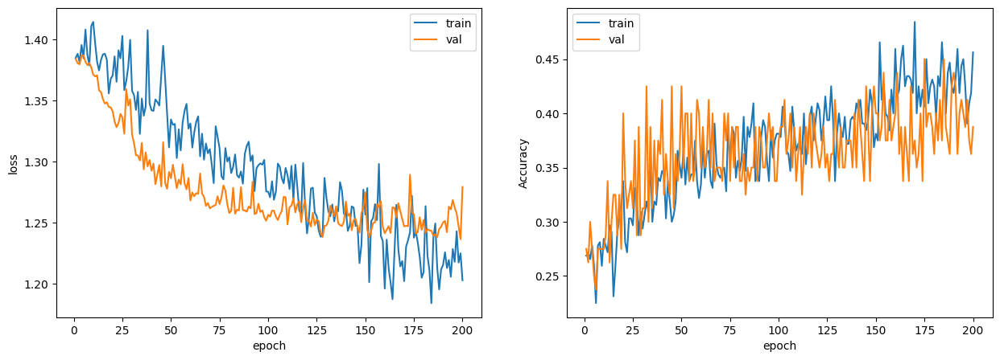

In [ ]:
train_acc_numpy = [tensor.cpu() for tensor in train_acc]
train_acc_numpy = np.array(train_acc_numpy)

plot_losses(train_loss, train_acc_numpy, val_loss, val_acc)


In [ ]:
teset_dataset = TensorDataset(torch.tensor(x_test.values, dtype=torch.float32), torch.tensor(y_test.values, dtype=torch.long))

test_loader = DataLoader(teset_dataset, batch_size=batch_size, shuffle=False)

preds = predict(model,test_loader)




Testing: 100%|██████████| 2/2 [00:00<00:00, 281.96it/s]


In [ ]:
conc_preds = torch.cat(preds, dim=0)
res = torch.argmax(conc_preds, dim=1)
res = res.cpu().numpy()
acc = accuracy_score(y_test, res)
print(f"Accuracy: {acc}")

Accuracy: 0.3


## Попробуем добавить разные шедулеры

In [ ]:
num_epochs = 150

batch_size = 64
dropout_prob = 0.5
hidden_size = 512

input_size = x_train.shape[1]
output_size = y_train.max().item() + 1

train_dataset = TensorDataset(torch.tensor(x_train_val.values, dtype=torch.float32), torch.tensor(y_train_val.values, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(x_val.values, dtype=torch.float32), torch.tensor(y_val.values, dtype=torch.long))


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

model = LSTMClassifier(input_size, hidden_size, output_size, dropout_prob).to(device)
criterion = nn.CrossEntropyLoss()

optimizer = optim.SGD(model.parameters(), lr=0.1, momentum=0.9)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)



train_loss, val_loss, train_acc, val_acc = train(model, optimizer, criterion, scheduler, train_loader, val_loader, num_epochs)


Validating epoch 1/150: 100%|██████████| 2/2 [00:00<00:00, 377.27it/s]
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:156: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


Epoch 1
 train loss: 1.41182382106781, train acc: 0.203125
 val loss: 1.3868643760681152, val acc: 0.275



Validating epoch 2/150: 100%|██████████| 2/2 [00:00<00:00, 384.59it/s]


Epoch 2
 train loss: 1.3865070819854737, train acc: 0.2750000059604645
 val loss: 1.385612154006958, val acc: 0.275



Validating epoch 3/150: 100%|██████████| 2/2 [00:00<00:00, 424.70it/s]


Epoch 3
 train loss: 1.3895848989486694, train acc: 0.265625
 val loss: 1.3791659832000733, val acc: 0.275



Validating epoch 4/150: 100%|██████████| 2/2 [00:00<00:00, 365.31it/s]


Epoch 4
 train loss: 1.386411690711975, train acc: 0.27812501788139343
 val loss: 1.3779204845428468, val acc: 0.2875



Validating epoch 5/150: 100%|██████████| 2/2 [00:00<00:00, 399.55it/s]


Epoch 5
 train loss: 1.37520751953125, train acc: 0.296875
 val loss: 1.3746038913726806, val acc: 0.2625



Validating epoch 6/150: 100%|██████████| 2/2 [00:00<00:00, 368.13it/s]


Epoch 6
 train loss: 1.385093092918396, train acc: 0.2750000059604645
 val loss: 1.3752265930175782, val acc: 0.275



Validating epoch 7/150: 100%|██████████| 2/2 [00:00<00:00, 265.80it/s]


Epoch 7
 train loss: 1.3931841135025025, train acc: 0.30937501788139343
 val loss: 1.3818723440170289, val acc: 0.275



Validating epoch 8/150: 100%|██████████| 2/2 [00:00<00:00, 326.00it/s]


Epoch 8
 train loss: 1.3659738063812257, train acc: 0.31562501192092896
 val loss: 1.3819031476974488, val acc: 0.3375



Validating epoch 9/150: 100%|██████████| 2/2 [00:00<00:00, 386.00it/s]


Epoch 9
 train loss: 1.400309944152832, train acc: 0.2593750059604645
 val loss: 1.3670684814453125, val acc: 0.2875



Validating epoch 10/150: 100%|██████████| 2/2 [00:00<00:00, 356.83it/s]


Epoch 10
 train loss: 1.3774875402450562, train acc: 0.296875
 val loss: 1.3617884635925293, val acc: 0.275



Validating epoch 11/150: 100%|██████████| 2/2 [00:00<00:00, 316.55it/s]


Epoch 11
 train loss: 1.3918989896774292, train acc: 0.26875001192092896
 val loss: 1.363602352142334, val acc: 0.2375



Validating epoch 12/150: 100%|██████████| 2/2 [00:00<00:00, 354.88it/s]


Epoch 12
 train loss: 1.4140544176101684, train acc: 0.26875001192092896
 val loss: 1.3548898458480836, val acc: 0.2625



Validating epoch 13/150: 100%|██████████| 2/2 [00:00<00:00, 359.19it/s]


Epoch 13
 train loss: 1.3750365734100343, train acc: 0.3125
 val loss: 1.3553133726119995, val acc: 0.275



Validating epoch 14/150: 100%|██████████| 2/2 [00:00<00:00, 425.00it/s]


Epoch 14
 train loss: 1.3709817409515381, train acc: 0.3125
 val loss: 1.3520309448242187, val acc: 0.2875



Validating epoch 15/150: 100%|██████████| 2/2 [00:00<00:00, 398.45it/s]


Epoch 15
 train loss: 1.3904795885086059, train acc: 0.28437501192092896
 val loss: 1.349090313911438, val acc: 0.3125



Validating epoch 16/150: 100%|██████████| 2/2 [00:00<00:00, 376.10it/s]


Epoch 16
 train loss: 1.375069522857666, train acc: 0.3062500059604645
 val loss: 1.359679651260376, val acc: 0.275



Validating epoch 17/150: 100%|██████████| 2/2 [00:00<00:00, 443.72it/s]


Epoch 17
 train loss: 1.3639052867889405, train acc: 0.265625
 val loss: 1.3545085668563843, val acc: 0.275



Validating epoch 18/150: 100%|██████████| 2/2 [00:00<00:00, 314.31it/s]


Epoch 18
 train loss: 1.3598690509796143, train acc: 0.3031249940395355
 val loss: 1.3553239345550536, val acc: 0.2875



Validating epoch 19/150: 100%|██████████| 2/2 [00:00<00:00, 362.61it/s]


Epoch 19
 train loss: 1.3603248596191406, train acc: 0.3125
 val loss: 1.3339932680130004, val acc: 0.35



Validating epoch 20/150: 100%|██████████| 2/2 [00:00<00:00, 350.43it/s]


Epoch 20
 train loss: 1.3298317909240722, train acc: 0.30937501788139343
 val loss: 1.332617712020874, val acc: 0.4375



Validating epoch 21/150: 100%|██████████| 2/2 [00:00<00:00, 267.33it/s]


Epoch 21
 train loss: 1.3761123895645142, train acc: 0.3125
 val loss: 1.3561868906021117, val acc: 0.3



Validating epoch 22/150: 100%|██████████| 2/2 [00:00<00:00, 369.46it/s]


Epoch 22
 train loss: 1.3869558572769165, train acc: 0.2750000059604645
 val loss: 1.3287543535232544, val acc: 0.35



Validating epoch 23/150: 100%|██████████| 2/2 [00:00<00:00, 333.28it/s]


Epoch 23
 train loss: 1.3673539638519288, train acc: 0.31562501192092896
 val loss: 1.3298632621765136, val acc: 0.2875



Validating epoch 24/150: 100%|██████████| 2/2 [00:00<00:00, 278.28it/s]


Epoch 24
 train loss: 1.3886181354522704, train acc: 0.26875001192092896
 val loss: 1.3336278200149536, val acc: 0.3



Validating epoch 25/150: 100%|██████████| 2/2 [00:00<00:00, 354.59it/s]


Epoch 25
 train loss: 1.3711257457733155, train acc: 0.3187499940395355
 val loss: 1.3152406692504883, val acc: 0.325



Validating epoch 26/150: 100%|██████████| 2/2 [00:00<00:00, 210.51it/s]


Epoch 26
 train loss: 1.3498273611068725, train acc: 0.3218750059604645
 val loss: 1.312668228149414, val acc: 0.35



Validating epoch 27/150: 100%|██████████| 2/2 [00:00<00:00, 295.20it/s]


Epoch 27
 train loss: 1.3564926624298095, train acc: 0.30000001192092896
 val loss: 1.307075810432434, val acc: 0.3875



Validating epoch 28/150: 100%|██████████| 2/2 [00:00<00:00, 340.20it/s]


Epoch 28
 train loss: 1.3548670530319213, train acc: 0.3343749940395355
 val loss: 1.3069534778594971, val acc: 0.4375



Validating epoch 29/150: 100%|██████████| 2/2 [00:00<00:00, 271.01it/s]


Epoch 29
 train loss: 1.3594833374023438, train acc: 0.3218750059604645
 val loss: 1.3186272859573365, val acc: 0.3



Validating epoch 30/150: 100%|██████████| 2/2 [00:00<00:00, 218.62it/s]


Epoch 30
 train loss: 1.3877780199050904, train acc: 0.2906250059604645
 val loss: 1.3032705783843994, val acc: 0.375



Validating epoch 31/150: 100%|██████████| 2/2 [00:00<00:00, 346.36it/s]


Epoch 31
 train loss: 1.3551701307296753, train acc: 0.3062500059604645
 val loss: 1.3161401510238648, val acc: 0.2875



Validating epoch 32/150: 100%|██████████| 2/2 [00:00<00:00, 401.66it/s]


Epoch 32
 train loss: 1.351386594772339, train acc: 0.3375000059604645
 val loss: 1.300915741920471, val acc: 0.3875



Validating epoch 33/150: 100%|██████████| 2/2 [00:00<00:00, 175.04it/s]


Epoch 33
 train loss: 1.3710601806640625, train acc: 0.3125
 val loss: 1.2956570625305175, val acc: 0.4



Validating epoch 34/150: 100%|██████████| 2/2 [00:00<00:00, 173.04it/s]


Epoch 34
 train loss: 1.3289353609085084, train acc: 0.3375000059604645
 val loss: 1.2938572883605957, val acc: 0.35



Validating epoch 35/150: 100%|██████████| 2/2 [00:00<00:00, 215.55it/s]


Epoch 35
 train loss: 1.3438148736953734, train acc: 0.33125001192092896
 val loss: 1.2929579973220826, val acc: 0.3875



Validating epoch 36/150: 100%|██████████| 2/2 [00:00<00:00, 203.09it/s]


Epoch 36
 train loss: 1.3374852418899537, train acc: 0.3499999940395355
 val loss: 1.2970275402069091, val acc: 0.325



Validating epoch 37/150: 100%|██████████| 2/2 [00:00<00:00, 213.65it/s]


Epoch 37
 train loss: 1.3506840944290162, train acc: 0.3125
 val loss: 1.308584713935852, val acc: 0.3875



Validating epoch 38/150: 100%|██████████| 2/2 [00:00<00:00, 386.66it/s]


Epoch 38
 train loss: 1.3241839408874512, train acc: 0.3531250059604645
 val loss: 1.3051788568496705, val acc: 0.3375



Validating epoch 39/150: 100%|██████████| 2/2 [00:00<00:00, 316.17it/s]


Epoch 39
 train loss: 1.3515328884124755, train acc: 0.34062501788139343
 val loss: 1.3117485046386719, val acc: 0.4125



Validating epoch 40/150: 100%|██████████| 2/2 [00:00<00:00, 338.92it/s]


Epoch 40
 train loss: 1.3231055736541748, train acc: 0.3687500059604645
 val loss: 1.319313144683838, val acc: 0.3125



Validating epoch 41/150: 100%|██████████| 2/2 [00:00<00:00, 359.15it/s]


Epoch 41
 train loss: 1.3501322746276856, train acc: 0.35625001788139343
 val loss: 1.3213556051254272, val acc: 0.3375



Validating epoch 42/150: 100%|██████████| 2/2 [00:00<00:00, 248.64it/s]


Epoch 42
 train loss: 1.3793771743774415, train acc: 0.3125
 val loss: 1.328733205795288, val acc: 0.3875



Validating epoch 43/150: 100%|██████████| 2/2 [00:00<00:00, 385.83it/s]


Epoch 43
 train loss: 1.3705865621566773, train acc: 0.31562501192092896
 val loss: 1.3364325046539307, val acc: 0.3



Validating epoch 44/150: 100%|██████████| 2/2 [00:00<00:00, 377.24it/s]


Epoch 44
 train loss: 1.3641071319580078, train acc: 0.3125
 val loss: 1.296026611328125, val acc: 0.325



Validating epoch 45/150: 100%|██████████| 2/2 [00:00<00:00, 305.60it/s]


Epoch 45
 train loss: 1.3664165019989014, train acc: 0.34375
 val loss: 1.29380464553833, val acc: 0.4



Validating epoch 46/150: 100%|██████████| 2/2 [00:00<00:00, 371.57it/s]


Epoch 46
 train loss: 1.3475292682647706, train acc: 0.3343749940395355
 val loss: 1.2887600421905518, val acc: 0.3625



Validating epoch 47/150: 100%|██████████| 2/2 [00:00<00:00, 408.82it/s]


Epoch 47
 train loss: 1.3423715114593506, train acc: 0.3499999940395355
 val loss: 1.283892774581909, val acc: 0.4375



Validating epoch 48/150: 100%|██████████| 2/2 [00:00<00:00, 386.29it/s]


Epoch 48
 train loss: 1.3339405298233031, train acc: 0.30937501788139343
 val loss: 1.2812789916992187, val acc: 0.375



Validating epoch 49/150: 100%|██████████| 2/2 [00:00<00:00, 232.06it/s]


Epoch 49
 train loss: 1.3276758909225463, train acc: 0.3375000059604645
 val loss: 1.283161211013794, val acc: 0.3375



Validating epoch 50/150: 100%|██████████| 2/2 [00:00<00:00, 223.99it/s]


Epoch 50
 train loss: 1.327458953857422, train acc: 0.34062501788139343
 val loss: 1.2822277545928955, val acc: 0.4



Validating epoch 51/150: 100%|██████████| 2/2 [00:00<00:00, 392.43it/s]


Epoch 51
 train loss: 1.311908984184265, train acc: 0.3531250059604645
 val loss: 1.2804339408874512, val acc: 0.3375



Validating epoch 52/150: 100%|██████████| 2/2 [00:00<00:00, 366.78it/s]


Epoch 52
 train loss: 1.3342081785202027, train acc: 0.34687501192092896
 val loss: 1.2740509748458861, val acc: 0.3625



Validating epoch 53/150: 100%|██████████| 2/2 [00:00<00:00, 374.24it/s]


Epoch 53
 train loss: 1.3366857290267944, train acc: 0.33125001192092896
 val loss: 1.28007652759552, val acc: 0.4



Validating epoch 54/150: 100%|██████████| 2/2 [00:00<00:00, 319.36it/s]


Epoch 54
 train loss: 1.3388893604278564, train acc: 0.3187499940395355
 val loss: 1.281761646270752, val acc: 0.3875



Validating epoch 55/150: 100%|██████████| 2/2 [00:00<00:00, 422.39it/s]


Epoch 55
 train loss: 1.3330237865447998, train acc: 0.359375
 val loss: 1.293594980239868, val acc: 0.3875



Validating epoch 56/150: 100%|██████████| 2/2 [00:00<00:00, 217.69it/s]


Epoch 56
 train loss: 1.341464066505432, train acc: 0.3375000059604645
 val loss: 1.279716181755066, val acc: 0.35



Validating epoch 57/150: 100%|██████████| 2/2 [00:00<00:00, 253.49it/s]


Epoch 57
 train loss: 1.3422783136367797, train acc: 0.34375
 val loss: 1.2869085550308228, val acc: 0.4125



Validating epoch 58/150: 100%|██████████| 2/2 [00:00<00:00, 332.25it/s]


Epoch 58
 train loss: 1.3628436088562013, train acc: 0.29375001788139343
 val loss: 1.2960896015167236, val acc: 0.325



Validating epoch 59/150: 100%|██████████| 2/2 [00:00<00:00, 389.17it/s]


Epoch 59
 train loss: 1.309998106956482, train acc: 0.35625001788139343
 val loss: 1.2857243537902832, val acc: 0.3625



Validating epoch 60/150: 100%|██████████| 2/2 [00:00<00:00, 248.27it/s]


Epoch 60
 train loss: 1.321009874343872, train acc: 0.3218750059604645
 val loss: 1.2735182523727417, val acc: 0.35



Validating epoch 61/150: 100%|██████████| 2/2 [00:00<00:00, 245.78it/s]


Epoch 61
 train loss: 1.306673264503479, train acc: 0.359375
 val loss: 1.2689858436584474, val acc: 0.3625



Validating epoch 62/150: 100%|██████████| 2/2 [00:00<00:00, 247.50it/s]


Epoch 62
 train loss: 1.292417335510254, train acc: 0.3531250059604645
 val loss: 1.271397590637207, val acc: 0.3625



Validating epoch 63/150: 100%|██████████| 2/2 [00:00<00:00, 398.64it/s]


Epoch 63
 train loss: 1.3091986894607544, train acc: 0.3812499940395355
 val loss: 1.264548659324646, val acc: 0.325



Validating epoch 64/150: 100%|██████████| 2/2 [00:00<00:00, 373.84it/s]


Epoch 64
 train loss: 1.3100836753845215, train acc: 0.3687500059604645
 val loss: 1.2668139934539795, val acc: 0.4125



Validating epoch 65/150: 100%|██████████| 2/2 [00:00<00:00, 392.89it/s]


Epoch 65
 train loss: 1.311223316192627, train acc: 0.37187501788139343
 val loss: 1.2640309572219848, val acc: 0.3625



Validating epoch 66/150: 100%|██████████| 2/2 [00:00<00:00, 376.19it/s]


Epoch 66
 train loss: 1.3079746961593628, train acc: 0.375
 val loss: 1.2648979902267456, val acc: 0.3625



Validating epoch 67/150: 100%|██████████| 2/2 [00:00<00:00, 357.75it/s]


Epoch 67
 train loss: 1.3056589603424071, train acc: 0.35625001788139343
 val loss: 1.2630584955215454, val acc: 0.3625



Validating epoch 68/150: 100%|██████████| 2/2 [00:00<00:00, 363.65it/s]


Epoch 68
 train loss: 1.2999172449111938, train acc: 0.3499999940395355
 val loss: 1.2662560939788818, val acc: 0.3375



Validating epoch 69/150: 100%|██████████| 2/2 [00:00<00:00, 278.96it/s]


Epoch 69
 train loss: 1.3220015525817872, train acc: 0.34062501788139343
 val loss: 1.2641757011413575, val acc: 0.35



Validating epoch 70/150: 100%|██████████| 2/2 [00:00<00:00, 277.58it/s]


Epoch 70
 train loss: 1.3062960386276246, train acc: 0.3812499940395355
 val loss: 1.2630860328674316, val acc: 0.4



Validating epoch 71/150: 100%|██████████| 2/2 [00:00<00:00, 246.07it/s]


Epoch 71
 train loss: 1.2910640239715576, train acc: 0.34687501192092896
 val loss: 1.2768214464187622, val acc: 0.425



Validating epoch 72/150: 100%|██████████| 2/2 [00:00<00:00, 306.83it/s]


Epoch 72
 train loss: 1.3230573415756226, train acc: 0.34062501788139343
 val loss: 1.2699775457382203, val acc: 0.35



Validating epoch 73/150: 100%|██████████| 2/2 [00:00<00:00, 155.73it/s]


Epoch 73
 train loss: 1.3172034740447998, train acc: 0.3687500059604645
 val loss: 1.268950057029724, val acc: 0.3875



Validating epoch 74/150: 100%|██████████| 2/2 [00:00<00:00, 398.85it/s]


Epoch 74
 train loss: 1.308697724342346, train acc: 0.3531250059604645
 val loss: 1.2774084091186524, val acc: 0.3375



Validating epoch 75/150: 100%|██████████| 2/2 [00:00<00:00, 224.75it/s]


Epoch 75
 train loss: 1.3001976490020752, train acc: 0.35625001788139343
 val loss: 1.2668191909790039, val acc: 0.375



Validating epoch 76/150: 100%|██████████| 2/2 [00:00<00:00, 224.17it/s]


Epoch 76
 train loss: 1.3300816774368287, train acc: 0.33125001192092896
 val loss: 1.2693464279174804, val acc: 0.3375



Validating epoch 77/150: 100%|██████████| 2/2 [00:00<00:00, 367.84it/s]


Epoch 77
 train loss: 1.3518786907196045, train acc: 0.3531250059604645
 val loss: 1.2710924386978149, val acc: 0.3875



Validating epoch 78/150: 100%|██████████| 2/2 [00:00<00:00, 294.38it/s]


Epoch 78
 train loss: 1.2999185800552369, train acc: 0.3687500059604645
 val loss: 1.262300705909729, val acc: 0.35



Validating epoch 79/150: 100%|██████████| 2/2 [00:00<00:00, 370.06it/s]


Epoch 79
 train loss: 1.3089346647262574, train acc: 0.35625001788139343
 val loss: 1.2675642013549804, val acc: 0.375



Validating epoch 80/150: 100%|██████████| 2/2 [00:00<00:00, 389.62it/s]


Epoch 80
 train loss: 1.312831711769104, train acc: 0.34687501192092896
 val loss: 1.2603992700576783, val acc: 0.3



Validating epoch 81/150: 100%|██████████| 2/2 [00:00<00:00, 404.78it/s]


Epoch 81
 train loss: 1.2814473628997802, train acc: 0.375
 val loss: 1.262101411819458, val acc: 0.3625



Validating epoch 82/150: 100%|██████████| 2/2 [00:00<00:00, 216.96it/s]


Epoch 82
 train loss: 1.3256502389907836, train acc: 0.35625001788139343
 val loss: 1.2613391160964966, val acc: 0.3875



Validating epoch 83/150: 100%|██████████| 2/2 [00:00<00:00, 303.98it/s]


Epoch 83
 train loss: 1.2981364727020264, train acc: 0.3687500059604645
 val loss: 1.2609400033950806, val acc: 0.3125



Validating epoch 84/150: 100%|██████████| 2/2 [00:00<00:00, 311.32it/s]


Epoch 84
 train loss: 1.3875030279159546, train acc: 0.3125
 val loss: 1.2759640693664551, val acc: 0.3875



Validating epoch 85/150: 100%|██████████| 2/2 [00:00<00:00, 157.77it/s]


Epoch 85
 train loss: 1.3372058629989625, train acc: 0.3656249940395355
 val loss: 1.299128794670105, val acc: 0.3375



Validating epoch 86/150: 100%|██████████| 2/2 [00:00<00:00, 280.26it/s]


Epoch 86
 train loss: 1.3016952276229858, train acc: 0.375
 val loss: 1.2865564346313476, val acc: 0.4



Validating epoch 87/150: 100%|██████████| 2/2 [00:00<00:00, 239.59it/s]


Epoch 87
 train loss: 1.286703634262085, train acc: 0.3656249940395355
 val loss: 1.2530842781066895, val acc: 0.3375



Validating epoch 88/150: 100%|██████████| 2/2 [00:00<00:00, 320.05it/s]


Epoch 88
 train loss: 1.288181233406067, train acc: 0.3687500059604645
 val loss: 1.2671385765075684, val acc: 0.4375



Validating epoch 89/150: 100%|██████████| 2/2 [00:00<00:00, 382.22it/s]


Epoch 89
 train loss: 1.2804176092147828, train acc: 0.3656249940395355
 val loss: 1.2683178186416626, val acc: 0.4



Validating epoch 90/150: 100%|██████████| 2/2 [00:00<00:00, 342.98it/s]


Epoch 90
 train loss: 1.2908291339874267, train acc: 0.3375000059604645
 val loss: 1.2592714786529542, val acc: 0.3625



Validating epoch 91/150: 100%|██████████| 2/2 [00:00<00:00, 173.60it/s]


Epoch 91
 train loss: 1.273464608192444, train acc: 0.33125001192092896
 val loss: 1.2545934200286866, val acc: 0.4



Validating epoch 92/150: 100%|██████████| 2/2 [00:00<00:00, 345.94it/s]


Epoch 92
 train loss: 1.2878488779067994, train acc: 0.3687500059604645
 val loss: 1.254461145401001, val acc: 0.4125



Validating epoch 93/150: 100%|██████████| 2/2 [00:00<00:00, 331.26it/s]


Epoch 93
 train loss: 1.282414722442627, train acc: 0.3656249940395355
 val loss: 1.2522806882858277, val acc: 0.375



Validating epoch 94/150: 100%|██████████| 2/2 [00:00<00:00, 332.89it/s]


Epoch 94
 train loss: 1.2929533958435058, train acc: 0.375
 val loss: 1.2513692378997803, val acc: 0.3625



Validating epoch 95/150: 100%|██████████| 2/2 [00:00<00:00, 329.48it/s]


Epoch 95
 train loss: 1.2677672147750854, train acc: 0.37187501788139343
 val loss: 1.2499085426330567, val acc: 0.375



Validating epoch 96/150: 100%|██████████| 2/2 [00:00<00:00, 269.70it/s]


Epoch 96
 train loss: 1.2725658416748047, train acc: 0.3843750059604645
 val loss: 1.2621575832366942, val acc: 0.3875



Validating epoch 97/150: 100%|██████████| 2/2 [00:00<00:00, 393.17it/s]


Epoch 97
 train loss: 1.2851938009262085, train acc: 0.3656249940395355
 val loss: 1.2524654150009156, val acc: 0.375



Validating epoch 98/150: 100%|██████████| 2/2 [00:00<00:00, 349.96it/s]


Epoch 98
 train loss: 1.2799997568130492, train acc: 0.3843750059604645
 val loss: 1.2630653142929078, val acc: 0.3875



Validating epoch 99/150: 100%|██████████| 2/2 [00:00<00:00, 364.17it/s]


Epoch 99
 train loss: 1.2943620920181274, train acc: 0.3656249940395355
 val loss: 1.2509239673614503, val acc: 0.35



Validating epoch 100/150: 100%|██████████| 2/2 [00:00<00:00, 321.46it/s]


Epoch 100
 train loss: 1.2792762041091919, train acc: 0.3687500059604645
 val loss: 1.2543912649154663, val acc: 0.375



Validating epoch 101/150: 100%|██████████| 2/2 [00:00<00:00, 376.71it/s]


Epoch 101
 train loss: 1.2784933567047119, train acc: 0.40625
 val loss: 1.2508881568908692, val acc: 0.3625



Validating epoch 102/150: 100%|██████████| 2/2 [00:00<00:00, 213.25it/s]


Epoch 102
 train loss: 1.2827831506729126, train acc: 0.39375001192092896
 val loss: 1.2522181510925292, val acc: 0.3625



Validating epoch 103/150: 100%|██████████| 2/2 [00:00<00:00, 401.35it/s]


Epoch 103
 train loss: 1.2897968530654906, train acc: 0.3812499940395355
 val loss: 1.2661046504974365, val acc: 0.4



Validating epoch 104/150: 100%|██████████| 2/2 [00:00<00:00, 379.39it/s]


Epoch 104
 train loss: 1.2624815464019776, train acc: 0.45000001788139343
 val loss: 1.2512944698333741, val acc: 0.3625



Validating epoch 105/150: 100%|██████████| 2/2 [00:00<00:00, 362.12it/s]


Epoch 105
 train loss: 1.270082688331604, train acc: 0.390625
 val loss: 1.2535486221313477, val acc: 0.375



Validating epoch 106/150: 100%|██████████| 2/2 [00:00<00:00, 392.21it/s]


Epoch 106
 train loss: 1.2422881603240967, train acc: 0.4437499940395355
 val loss: 1.2527776956558228, val acc: 0.35



Validating epoch 107/150: 100%|██████████| 2/2 [00:00<00:00, 371.05it/s]


Epoch 107
 train loss: 1.2604913473129273, train acc: 0.40625
 val loss: 1.2471686840057372, val acc: 0.3625



Validating epoch 108/150: 100%|██████████| 2/2 [00:00<00:00, 341.04it/s]


Epoch 108
 train loss: 1.2707348585128784, train acc: 0.4000000059604645
 val loss: 1.2747476816177368, val acc: 0.3375



Validating epoch 109/150: 100%|██████████| 2/2 [00:00<00:00, 157.18it/s]


Epoch 109
 train loss: 1.2738851070404054, train acc: 0.3656249940395355
 val loss: 1.258327555656433, val acc: 0.375



Validating epoch 110/150: 100%|██████████| 2/2 [00:00<00:00, 340.94it/s]


Epoch 110
 train loss: 1.2451634407043457, train acc: 0.3843750059604645
 val loss: 1.2570332765579224, val acc: 0.4



Validating epoch 111/150: 100%|██████████| 2/2 [00:00<00:00, 357.48it/s]


Epoch 111
 train loss: 1.263330912590027, train acc: 0.40625
 val loss: 1.2596951961517333, val acc: 0.4



Validating epoch 112/150: 100%|██████████| 2/2 [00:00<00:00, 376.61it/s]


Epoch 112
 train loss: 1.3095725774765015, train acc: 0.37187501788139343
 val loss: 1.285692572593689, val acc: 0.3875



Validating epoch 113/150: 100%|██████████| 2/2 [00:00<00:00, 340.03it/s]


Epoch 113
 train loss: 1.2735419511795043, train acc: 0.390625
 val loss: 1.2602582931518556, val acc: 0.4



Validating epoch 114/150: 100%|██████████| 2/2 [00:00<00:00, 286.16it/s]


Epoch 114
 train loss: 1.3157280683517456, train acc: 0.3968749940395355
 val loss: 1.2912393808364868, val acc: 0.3375



Validating epoch 115/150: 100%|██████████| 2/2 [00:00<00:00, 220.92it/s]


Epoch 115
 train loss: 1.2845903873443603, train acc: 0.37187501788139343
 val loss: 1.2518267393112184, val acc: 0.375



Validating epoch 116/150: 100%|██████████| 2/2 [00:00<00:00, 377.19it/s]


Epoch 116
 train loss: 1.2896052837371825, train acc: 0.3812499940395355
 val loss: 1.2522333860397339, val acc: 0.3625



Validating epoch 117/150: 100%|██████████| 2/2 [00:00<00:00, 377.22it/s]


Epoch 117
 train loss: 1.289732074737549, train acc: 0.3656249940395355
 val loss: 1.2587847232818603, val acc: 0.425



Validating epoch 118/150: 100%|██████████| 2/2 [00:00<00:00, 349.10it/s]


Epoch 118
 train loss: 1.3115809917449952, train acc: 0.36250001192092896
 val loss: 1.2619946241378783, val acc: 0.3875



Validating epoch 119/150: 100%|██████████| 2/2 [00:00<00:00, 374.44it/s]


Epoch 119
 train loss: 1.2739752054214477, train acc: 0.359375
 val loss: 1.2822718381881715, val acc: 0.4125



Validating epoch 120/150: 100%|██████████| 2/2 [00:00<00:00, 381.56it/s]


Epoch 120
 train loss: 1.255728268623352, train acc: 0.40937501192092896
 val loss: 1.2767698287963867, val acc: 0.35



Validating epoch 121/150: 100%|██████████| 2/2 [00:00<00:00, 362.66it/s]


Epoch 121
 train loss: 1.274127197265625, train acc: 0.39375001192092896
 val loss: 1.2656182289123534, val acc: 0.3875



Validating epoch 122/150: 100%|██████████| 2/2 [00:00<00:00, 428.16it/s]


Epoch 122
 train loss: 1.2744083881378174, train acc: 0.40312501788139343
 val loss: 1.2544780254364014, val acc: 0.3875



Validating epoch 123/150: 100%|██████████| 2/2 [00:00<00:00, 331.91it/s]


Epoch 123
 train loss: 1.27285315990448, train acc: 0.37812501192092896
 val loss: 1.271394395828247, val acc: 0.375



Validating epoch 124/150: 100%|██████████| 2/2 [00:00<00:00, 361.52it/s]


Epoch 124
 train loss: 1.2582958459854126, train acc: 0.39375001192092896
 val loss: 1.2573288917541503, val acc: 0.35



Validating epoch 125/150: 100%|██████████| 2/2 [00:00<00:00, 237.73it/s]


Epoch 125
 train loss: 1.287748122215271, train acc: 0.36250001192092896
 val loss: 1.2648162126541138, val acc: 0.3875



Validating epoch 126/150: 100%|██████████| 2/2 [00:00<00:00, 341.39it/s]


Epoch 126
 train loss: 1.2439535140991211, train acc: 0.40937501192092896
 val loss: 1.2668241024017335, val acc: 0.4



Validating epoch 127/150: 100%|██████████| 2/2 [00:00<00:00, 331.83it/s]


Epoch 127
 train loss: 1.2747561931610107, train acc: 0.40312501788139343
 val loss: 1.2459839820861816, val acc: 0.3625



Validating epoch 128/150: 100%|██████████| 2/2 [00:00<00:00, 307.68it/s]


Epoch 128
 train loss: 1.2766899108886718, train acc: 0.3687500059604645
 val loss: 1.288640570640564, val acc: 0.35



Validating epoch 129/150: 100%|██████████| 2/2 [00:00<00:00, 285.54it/s]


Epoch 129
 train loss: 1.2638079881668092, train acc: 0.39375001192092896
 val loss: 1.2598981142044068, val acc: 0.4



Validating epoch 130/150: 100%|██████████| 2/2 [00:00<00:00, 203.42it/s]


Epoch 130
 train loss: 1.2499650239944458, train acc: 0.421875
 val loss: 1.257532811164856, val acc: 0.4125



Validating epoch 131/150: 100%|██████████| 2/2 [00:00<00:00, 353.37it/s]


Epoch 131
 train loss: 1.2540707111358642, train acc: 0.40625
 val loss: 1.2487261533737182, val acc: 0.4



Validating epoch 132/150: 100%|██████████| 2/2 [00:00<00:00, 362.81it/s]


Epoch 132
 train loss: 1.2194273710250854, train acc: 0.4281249940395355
 val loss: 1.247827696800232, val acc: 0.375



Validating epoch 133/150: 100%|██████████| 2/2 [00:00<00:00, 381.60it/s]


Epoch 133
 train loss: 1.2559898853302003, train acc: 0.3968749940395355
 val loss: 1.2461330890655518, val acc: 0.35



Validating epoch 134/150: 100%|██████████| 2/2 [00:00<00:00, 366.81it/s]


Epoch 134
 train loss: 1.2467623233795166, train acc: 0.3968749940395355
 val loss: 1.2520660638809205, val acc: 0.3875



Validating epoch 135/150: 100%|██████████| 2/2 [00:00<00:00, 406.42it/s]


Epoch 135
 train loss: 1.2332770109176636, train acc: 0.4000000059604645
 val loss: 1.2721012115478516, val acc: 0.375



Validating epoch 136/150: 100%|██████████| 2/2 [00:00<00:00, 356.26it/s]


Epoch 136
 train loss: 1.270773720741272, train acc: 0.38750001788139343
 val loss: 1.2444904088973998, val acc: 0.3625



Validating epoch 137/150: 100%|██████████| 2/2 [00:00<00:00, 353.35it/s]


Epoch 137
 train loss: 1.2502159595489502, train acc: 0.41875001788139343
 val loss: 1.2474649667739868, val acc: 0.4



Validating epoch 138/150: 100%|██████████| 2/2 [00:00<00:00, 326.66it/s]


Epoch 138
 train loss: 1.2823101043701173, train acc: 0.3812499940395355
 val loss: 1.2505860090255738, val acc: 0.3625



Validating epoch 139/150: 100%|██████████| 2/2 [00:00<00:00, 337.34it/s]


Epoch 139
 train loss: 1.2734955310821534, train acc: 0.37812501192092896
 val loss: 1.2518537759780883, val acc: 0.375



Validating epoch 140/150: 100%|██████████| 2/2 [00:00<00:00, 356.80it/s]


Epoch 140
 train loss: 1.2702959537506104, train acc: 0.3843750059604645
 val loss: 1.2510900020599365, val acc: 0.3875



Validating epoch 141/150: 100%|██████████| 2/2 [00:00<00:00, 385.45it/s]


Epoch 141
 train loss: 1.2529650688171388, train acc: 0.390625
 val loss: 1.2422534227371216, val acc: 0.4125



Validating epoch 142/150: 100%|██████████| 2/2 [00:00<00:00, 270.35it/s]


Epoch 142
 train loss: 1.2549084186553956, train acc: 0.390625
 val loss: 1.2449689626693725, val acc: 0.4125



Validating epoch 143/150: 100%|██████████| 2/2 [00:00<00:00, 279.28it/s]


Epoch 143
 train loss: 1.2335205793380737, train acc: 0.40625
 val loss: 1.2423271656036377, val acc: 0.375



Validating epoch 144/150: 100%|██████████| 2/2 [00:00<00:00, 327.53it/s]


Epoch 144
 train loss: 1.2256246566772462, train acc: 0.421875
 val loss: 1.2502097129821776, val acc: 0.4375



Validating epoch 145/150: 100%|██████████| 2/2 [00:00<00:00, 346.82it/s]


Epoch 145
 train loss: 1.2399431705474853, train acc: 0.43437501788139343
 val loss: 1.238760805130005, val acc: 0.375



Validating epoch 146/150: 100%|██████████| 2/2 [00:00<00:00, 347.21it/s]


Epoch 146
 train loss: 1.2417780876159668, train acc: 0.4124999940395355
 val loss: 1.2408114433288575, val acc: 0.4



Validating epoch 147/150: 100%|██████████| 2/2 [00:00<00:00, 361.13it/s]


Epoch 147
 train loss: 1.2606580972671508, train acc: 0.3968749940395355
 val loss: 1.2430123567581177, val acc: 0.4



Validating epoch 148/150: 100%|██████████| 2/2 [00:00<00:00, 370.29it/s]


Epoch 148
 train loss: 1.2459563255310058, train acc: 0.4312500059604645
 val loss: 1.2483452796936034, val acc: 0.3625



Validating epoch 149/150: 100%|██████████| 2/2 [00:00<00:00, 356.23it/s]


Epoch 149
 train loss: 1.2320340394973754, train acc: 0.37812501192092896
 val loss: 1.251435351371765, val acc: 0.3875



Validating epoch 150/150: 100%|██████████| 2/2 [00:00<00:00, 401.83it/s]

Epoch 150
 train loss: 1.2444166183471679, train acc: 0.4281249940395355
 val loss: 1.2454669713973998, val acc: 0.4



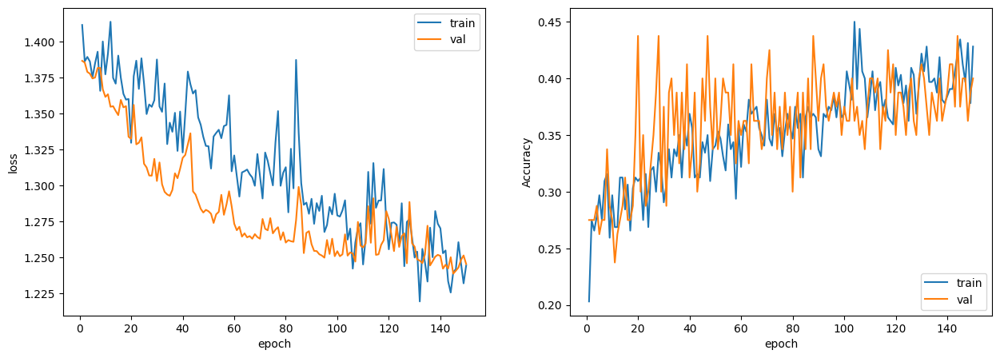

In [ ]:
train_acc_numpy = [tensor.cpu() for tensor in train_acc]
train_acc_numpy = np.array(train_acc_numpy)

plot_losses(train_loss, train_acc_numpy, val_loss, val_acc)


In [ ]:

preds = predict(model,test_loader)

conc_preds = torch.cat(preds, dim=0)
res = torch.argmax(conc_preds, dim=1)
res = res.cpu().numpy()



Testing: 100%|██████████| 2/2 [00:00<00:00, 165.51it/s]


In [ ]:
acc = accuracy_score(y_test, res)
print(f"Accuracy: {acc}")

Accuracy: 0.29


### Lambda LR

In [ ]:
num_epochs = 100

batch_size = 64
dropout_prob = 0.5
hidden_size = 512

input_size = x_train.shape[1]
output_size = y_train.max().item() + 1

train_dataset = TensorDataset(torch.tensor(x_train_val.values, dtype=torch.float32), torch.tensor(y_train_val.values, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(x_val.values, dtype=torch.float32), torch.tensor(y_val.values, dtype=torch.long))


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

model = LSTMClassifier(input_size, hidden_size, output_size, dropout_prob).to(device)
criterion = nn.CrossEntropyLoss()

optimizer = optim.SGD(model.parameters(), lr=0.1, momentum=0.9)
lambda1 = lambda epoch: 0.65 ** epoch
scheduler = optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lambda1)



train_loss, val_loss, train_acc, val_acc = train(model, optimizer, criterion, scheduler, train_loader, val_loader, num_epochs)


Validating epoch 1/100: 100%|██████████| 2/2 [00:00<00:00, 463.95it/s]
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:156: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


Epoch 1
 train loss: 1.3974762201309203, train acc: 0.19375000894069672
 val loss: 1.3866657972335816, val acc: 0.2875



Validating epoch 2/100: 100%|██████████| 2/2 [00:00<00:00, 363.00it/s]


Epoch 2
 train loss: 1.3889599800109864, train acc: 0.2750000059604645
 val loss: 1.3823413372039794, val acc: 0.275



Validating epoch 3/100: 100%|██████████| 2/2 [00:00<00:00, 331.04it/s]


Epoch 3
 train loss: 1.3831475734710694, train acc: 0.2750000059604645
 val loss: 1.3810476064682007, val acc: 0.2875



Validating epoch 4/100: 100%|██████████| 2/2 [00:00<00:00, 448.76it/s]


Epoch 4
 train loss: 1.3806734800338745, train acc: 0.265625
 val loss: 1.3796871185302735, val acc: 0.275



Validating epoch 5/100: 100%|██████████| 2/2 [00:00<00:00, 387.75it/s]


Epoch 5
 train loss: 1.3860338926315308, train acc: 0.265625
 val loss: 1.3787134170532227, val acc: 0.2875



Validating epoch 6/100: 100%|██████████| 2/2 [00:00<00:00, 324.89it/s]


Epoch 6
 train loss: 1.3819261550903321, train acc: 0.2750000059604645
 val loss: 1.3766028165817261, val acc: 0.275



Validating epoch 7/100: 100%|██████████| 2/2 [00:00<00:00, 404.27it/s]


Epoch 7
 train loss: 1.377335524559021, train acc: 0.26875001192092896
 val loss: 1.378008770942688, val acc: 0.2625



Validating epoch 8/100: 100%|██████████| 2/2 [00:00<00:00, 375.21it/s]


Epoch 8
 train loss: 1.3759354829788208, train acc: 0.31562501192092896
 val loss: 1.3739277124404907, val acc: 0.2625



Validating epoch 9/100: 100%|██████████| 2/2 [00:00<00:00, 388.38it/s]


Epoch 9
 train loss: 1.3778862953186035, train acc: 0.3031249940395355
 val loss: 1.3735987901687623, val acc: 0.275



Validating epoch 10/100: 100%|██████████| 2/2 [00:00<00:00, 378.21it/s]


Epoch 10
 train loss: 1.3810929298400878, train acc: 0.2593750059604645
 val loss: 1.3716523885726928, val acc: 0.3



Validating epoch 11/100: 100%|██████████| 2/2 [00:00<00:00, 373.77it/s]


Epoch 11
 train loss: 1.3850165843963622, train acc: 0.2874999940395355
 val loss: 1.3714690446853637, val acc: 0.2375



Validating epoch 12/100: 100%|██████████| 2/2 [00:00<00:00, 419.03it/s]


Epoch 12
 train loss: 1.3875104665756226, train acc: 0.2562499940395355
 val loss: 1.3691775798797607, val acc: 0.3



Validating epoch 13/100: 100%|██████████| 2/2 [00:00<00:00, 319.48it/s]


Epoch 13
 train loss: 1.3789639234542848, train acc: 0.265625
 val loss: 1.3667705059051514, val acc: 0.275



Validating epoch 14/100: 100%|██████████| 2/2 [00:00<00:00, 354.95it/s]


Epoch 14
 train loss: 1.3705241680145264, train acc: 0.32500001788139343
 val loss: 1.3681472778320312, val acc: 0.2625



Validating epoch 15/100: 100%|██████████| 2/2 [00:00<00:00, 418.18it/s]


Epoch 15
 train loss: 1.3792186975479126, train acc: 0.2906250059604645
 val loss: 1.366497015953064, val acc: 0.2375



Validating epoch 16/100: 100%|██████████| 2/2 [00:00<00:00, 362.56it/s]


Epoch 16
 train loss: 1.3630395412445069, train acc: 0.3218750059604645
 val loss: 1.3630818605422974, val acc: 0.325



Validating epoch 17/100: 100%|██████████| 2/2 [00:00<00:00, 352.77it/s]


Epoch 17
 train loss: 1.3691384553909303, train acc: 0.328125
 val loss: 1.3598968982696533, val acc: 0.25



Validating epoch 18/100: 100%|██████████| 2/2 [00:00<00:00, 395.33it/s]


Epoch 18
 train loss: 1.3646214246749877, train acc: 0.2906250059604645
 val loss: 1.3601057529449463, val acc: 0.2625



Validating epoch 19/100: 100%|██████████| 2/2 [00:00<00:00, 377.36it/s]


Epoch 19
 train loss: 1.3804609537124635, train acc: 0.2750000059604645
 val loss: 1.3624760150909423, val acc: 0.275



Validating epoch 20/100: 100%|██████████| 2/2 [00:00<00:00, 393.57it/s]


Epoch 20
 train loss: 1.3682780027389527, train acc: 0.2906250059604645
 val loss: 1.3584413528442383, val acc: 0.325



Validating epoch 21/100: 100%|██████████| 2/2 [00:00<00:00, 342.55it/s]


Epoch 21
 train loss: 1.3648820400238038, train acc: 0.3062500059604645
 val loss: 1.3521329879760742, val acc: 0.3



Validating epoch 22/100: 100%|██████████| 2/2 [00:00<00:00, 420.19it/s]


Epoch 22
 train loss: 1.3708267211914062, train acc: 0.30937501788139343
 val loss: 1.3536656618118286, val acc: 0.25



Validating epoch 23/100: 100%|██████████| 2/2 [00:00<00:00, 398.53it/s]


Epoch 23
 train loss: 1.3586401224136353, train acc: 0.30000001192092896
 val loss: 1.3509445667266846, val acc: 0.3



Validating epoch 24/100: 100%|██████████| 2/2 [00:00<00:00, 417.45it/s]


Epoch 24
 train loss: 1.3625784158706664, train acc: 0.3375000059604645
 val loss: 1.3564998626708984, val acc: 0.2875



Validating epoch 25/100: 100%|██████████| 2/2 [00:00<00:00, 404.39it/s]


Epoch 25
 train loss: 1.3505441427230835, train acc: 0.32500001788139343
 val loss: 1.3414811611175537, val acc: 0.275



Validating epoch 26/100: 100%|██████████| 2/2 [00:00<00:00, 469.00it/s]


Epoch 26
 train loss: 1.3452046871185304, train acc: 0.34375
 val loss: 1.3406156063079835, val acc: 0.3125



Validating epoch 27/100: 100%|██████████| 2/2 [00:00<00:00, 391.41it/s]


Epoch 27
 train loss: 1.3522500276565552, train acc: 0.3375000059604645
 val loss: 1.346253752708435, val acc: 0.2625



Validating epoch 28/100: 100%|██████████| 2/2 [00:00<00:00, 418.43it/s]


Epoch 28
 train loss: 1.3696178436279296, train acc: 0.31562501192092896
 val loss: 1.3365965604782104, val acc: 0.3875



Validating epoch 29/100: 100%|██████████| 2/2 [00:00<00:00, 383.02it/s]


Epoch 29
 train loss: 1.3590676307678222, train acc: 0.3125
 val loss: 1.3511701107025147, val acc: 0.3125



Validating epoch 30/100: 100%|██████████| 2/2 [00:00<00:00, 258.26it/s]


Epoch 30
 train loss: 1.3682992935180665, train acc: 0.3187499940395355
 val loss: 1.3461366891860962, val acc: 0.275



Validating epoch 31/100: 100%|██████████| 2/2 [00:00<00:00, 417.24it/s]


Epoch 31
 train loss: 1.3803982257843017, train acc: 0.29375001788139343
 val loss: 1.3278640985488892, val acc: 0.3375



Validating epoch 32/100: 100%|██████████| 2/2 [00:00<00:00, 399.84it/s]


Epoch 32
 train loss: 1.3695014238357544, train acc: 0.29375001788139343
 val loss: 1.3279658079147338, val acc: 0.4



Validating epoch 33/100: 100%|██████████| 2/2 [00:00<00:00, 317.01it/s]


Epoch 33
 train loss: 1.3570779323577882, train acc: 0.30937501788139343
 val loss: 1.32479248046875, val acc: 0.325



Validating epoch 34/100: 100%|██████████| 2/2 [00:00<00:00, 417.99it/s]


Epoch 34
 train loss: 1.3491448163986206, train acc: 0.34375
 val loss: 1.328838849067688, val acc: 0.2875



Validating epoch 35/100: 100%|██████████| 2/2 [00:00<00:00, 409.48it/s]


Epoch 35
 train loss: 1.3436444520950317, train acc: 0.328125
 val loss: 1.3225815057754517, val acc: 0.35



Validating epoch 36/100: 100%|██████████| 2/2 [00:00<00:00, 302.30it/s]


Epoch 36
 train loss: 1.3415899276733398, train acc: 0.3187499940395355
 val loss: 1.3193589210510255, val acc: 0.375



Validating epoch 37/100: 100%|██████████| 2/2 [00:00<00:00, 457.99it/s]


Epoch 37
 train loss: 1.3326744318008423, train acc: 0.359375
 val loss: 1.3190974950790406, val acc: 0.3



Validating epoch 38/100: 100%|██████████| 2/2 [00:00<00:00, 373.14it/s]


Epoch 38
 train loss: 1.352963662147522, train acc: 0.3187499940395355
 val loss: 1.314689326286316, val acc: 0.35



Validating epoch 39/100: 100%|██████████| 2/2 [00:00<00:00, 366.46it/s]


Epoch 39
 train loss: 1.3469981670379638, train acc: 0.34687501192092896
 val loss: 1.313222050666809, val acc: 0.3



Validating epoch 40/100: 100%|██████████| 2/2 [00:00<00:00, 392.17it/s]


Epoch 40
 train loss: 1.3421842575073242, train acc: 0.328125
 val loss: 1.3112274169921876, val acc: 0.35



Validating epoch 41/100: 100%|██████████| 2/2 [00:00<00:00, 374.32it/s]


Epoch 41
 train loss: 1.3682843685150146, train acc: 0.26875001192092896
 val loss: 1.3081187963485719, val acc: 0.3125



Validating epoch 42/100: 100%|██████████| 2/2 [00:00<00:00, 387.75it/s]


Epoch 42
 train loss: 1.3565409421920775, train acc: 0.3218750059604645
 val loss: 1.3099256992340087, val acc: 0.3625



Validating epoch 43/100: 100%|██████████| 2/2 [00:00<00:00, 335.30it/s]


Epoch 43
 train loss: 1.324684166908264, train acc: 0.3375000059604645
 val loss: 1.310443353652954, val acc: 0.3



Validating epoch 44/100: 100%|██████████| 2/2 [00:00<00:00, 375.72it/s]


Epoch 44
 train loss: 1.3582543849945068, train acc: 0.3031249940395355
 val loss: 1.3067847728729247, val acc: 0.3375



Validating epoch 45/100: 100%|██████████| 2/2 [00:00<00:00, 405.99it/s]


Epoch 45
 train loss: 1.340627384185791, train acc: 0.34062501788139343
 val loss: 1.3024535179138184, val acc: 0.3625



Validating epoch 46/100: 100%|██████████| 2/2 [00:00<00:00, 386.91it/s]


Epoch 46
 train loss: 1.3398007154464722, train acc: 0.32500001788139343
 val loss: 1.294740128517151, val acc: 0.3625



Validating epoch 47/100: 100%|██████████| 2/2 [00:00<00:00, 411.13it/s]


Epoch 47
 train loss: 1.3336550712585449, train acc: 0.328125
 val loss: 1.3030096292495728, val acc: 0.325



Validating epoch 48/100: 100%|██████████| 2/2 [00:00<00:00, 443.02it/s]


Epoch 48
 train loss: 1.3242981910705567, train acc: 0.34062501788139343
 val loss: 1.2921988725662232, val acc: 0.4



Validating epoch 49/100: 100%|██████████| 2/2 [00:00<00:00, 357.30it/s]


Epoch 49
 train loss: 1.341911792755127, train acc: 0.30000001192092896
 val loss: 1.289546275138855, val acc: 0.3375



Validating epoch 50/100: 100%|██████████| 2/2 [00:00<00:00, 196.81it/s]


Epoch 50
 train loss: 1.3401632070541383, train acc: 0.35625001788139343
 val loss: 1.2919551134109497, val acc: 0.325



Validating epoch 51/100: 100%|██████████| 2/2 [00:00<00:00, 318.46it/s]


Epoch 51
 train loss: 1.3419165849685668, train acc: 0.34375
 val loss: 1.288680362701416, val acc: 0.4125



Validating epoch 52/100: 100%|██████████| 2/2 [00:00<00:00, 381.47it/s]


Epoch 52
 train loss: 1.3278831481933593, train acc: 0.359375
 val loss: 1.29036283493042, val acc: 0.3625



Validating epoch 53/100: 100%|██████████| 2/2 [00:00<00:00, 360.21it/s]


Epoch 53
 train loss: 1.3220623254776, train acc: 0.3499999940395355
 val loss: 1.2909425258636475, val acc: 0.3625



Validating epoch 54/100: 100%|██████████| 2/2 [00:00<00:00, 352.26it/s]


Epoch 54
 train loss: 1.3417614698410034, train acc: 0.34062501788139343
 val loss: 1.2850516080856322, val acc: 0.45



Validating epoch 55/100: 100%|██████████| 2/2 [00:00<00:00, 335.36it/s]


Epoch 55
 train loss: 1.3636438131332398, train acc: 0.30937501788139343
 val loss: 1.2939499139785766, val acc: 0.3375



Validating epoch 56/100: 100%|██████████| 2/2 [00:00<00:00, 371.69it/s]


Epoch 56
 train loss: 1.3197911024093627, train acc: 0.34687501192092896
 val loss: 1.284225058555603, val acc: 0.3875



Validating epoch 57/100: 100%|██████████| 2/2 [00:00<00:00, 416.89it/s]


Epoch 57
 train loss: 1.3280900716781616, train acc: 0.3125
 val loss: 1.2809399604797362, val acc: 0.3625



Validating epoch 58/100: 100%|██████████| 2/2 [00:00<00:00, 256.13it/s]


Epoch 58
 train loss: 1.303497838973999, train acc: 0.3812499940395355
 val loss: 1.2858006000518798, val acc: 0.3875



Validating epoch 59/100: 100%|██████████| 2/2 [00:00<00:00, 343.88it/s]


Epoch 59
 train loss: 1.3268800020217895, train acc: 0.3687500059604645
 val loss: 1.2787099361419678, val acc: 0.35



Validating epoch 60/100: 100%|██████████| 2/2 [00:00<00:00, 331.85it/s]


Epoch 60
 train loss: 1.3403915882110595, train acc: 0.33125001192092896
 val loss: 1.2895808458328246, val acc: 0.2875



Validating epoch 61/100: 100%|██████████| 2/2 [00:00<00:00, 319.08it/s]


Epoch 61
 train loss: 1.3559053421020508, train acc: 0.33125001192092896
 val loss: 1.2803296804428101, val acc: 0.375



Validating epoch 62/100: 100%|██████████| 2/2 [00:00<00:00, 375.51it/s]


Epoch 62
 train loss: 1.307787823677063, train acc: 0.3687500059604645
 val loss: 1.2832653999328614, val acc: 0.3375



Validating epoch 63/100: 100%|██████████| 2/2 [00:00<00:00, 307.40it/s]


Epoch 63
 train loss: 1.3321388721466065, train acc: 0.3187499940395355
 val loss: 1.2797012090682984, val acc: 0.35



Validating epoch 64/100: 100%|██████████| 2/2 [00:00<00:00, 369.48it/s]


Epoch 64
 train loss: 1.3229334115982057, train acc: 0.35625001788139343
 val loss: 1.2831973552703857, val acc: 0.375



Validating epoch 65/100: 100%|██████████| 2/2 [00:00<00:00, 264.25it/s]


Epoch 65
 train loss: 1.31600980758667, train acc: 0.375
 val loss: 1.2739872217178345, val acc: 0.4625



Validating epoch 66/100: 100%|██████████| 2/2 [00:00<00:00, 291.62it/s]


Epoch 66
 train loss: 1.320949125289917, train acc: 0.34375
 val loss: 1.2755717039108276, val acc: 0.3875



Validating epoch 67/100: 100%|██████████| 2/2 [00:00<00:00, 327.04it/s]


Epoch 67
 train loss: 1.3103696584701539, train acc: 0.34687501192092896
 val loss: 1.2718042612075806, val acc: 0.3375



Validating epoch 68/100: 100%|██████████| 2/2 [00:00<00:00, 107.09it/s]


Epoch 68
 train loss: 1.3299871683120728, train acc: 0.3531250059604645
 val loss: 1.2815975189208983, val acc: 0.3375



Validating epoch 69/100: 100%|██████████| 2/2 [00:00<00:00, 254.79it/s]


Epoch 69
 train loss: 1.3214738607406615, train acc: 0.3531250059604645
 val loss: 1.2674855232238769, val acc: 0.35



Validating epoch 70/100: 100%|██████████| 2/2 [00:00<00:00, 340.89it/s]


Epoch 70
 train loss: 1.3259671688079835, train acc: 0.3812499940395355
 val loss: 1.2738259792327882, val acc: 0.3625



Validating epoch 71/100: 100%|██████████| 2/2 [00:00<00:00, 365.26it/s]


Epoch 71
 train loss: 1.3203739166259765, train acc: 0.36250001192092896
 val loss: 1.2662657976150513, val acc: 0.375



Validating epoch 72/100: 100%|██████████| 2/2 [00:00<00:00, 276.55it/s]


Epoch 72
 train loss: 1.31741201877594, train acc: 0.3656249940395355
 val loss: 1.2715115070343017, val acc: 0.35



Validating epoch 73/100: 100%|██████████| 2/2 [00:00<00:00, 340.14it/s]


Epoch 73
 train loss: 1.3105812311172484, train acc: 0.359375
 val loss: 1.279758358001709, val acc: 0.35



Validating epoch 74/100: 100%|██████████| 2/2 [00:00<00:00, 371.60it/s]


Epoch 74
 train loss: 1.3297544240951538, train acc: 0.3531250059604645
 val loss: 1.2682105779647828, val acc: 0.3375



Validating epoch 75/100: 100%|██████████| 2/2 [00:00<00:00, 350.94it/s]


Epoch 75
 train loss: 1.3350502014160157, train acc: 0.3531250059604645
 val loss: 1.2710482597351074, val acc: 0.3875



Validating epoch 76/100: 100%|██████████| 2/2 [00:00<00:00, 250.29it/s]


Epoch 76
 train loss: 1.3251463174819946, train acc: 0.3343749940395355
 val loss: 1.2736813068389892, val acc: 0.3875



Validating epoch 77/100: 100%|██████████| 2/2 [00:00<00:00, 280.57it/s]


Epoch 77
 train loss: 1.3097639560699463, train acc: 0.390625
 val loss: 1.2807625532150269, val acc: 0.375



Validating epoch 78/100: 100%|██████████| 2/2 [00:00<00:00, 309.95it/s]


Epoch 78
 train loss: 1.3209915161132812, train acc: 0.3499999940395355
 val loss: 1.2838716506958008, val acc: 0.3375



Validating epoch 79/100: 100%|██████████| 2/2 [00:00<00:00, 321.81it/s]

Epoch 79


 train loss: 1.3334100008010865, train acc: 0.3343749940395355
 val loss: 1.269943404197693, val acc: 0.35



Validating epoch 80/100: 100%|██████████| 2/2 [00:00<00:00, 302.10it/s]


Epoch 80
 train loss: 1.3102782487869262, train acc: 0.34687501192092896
 val loss: 1.26673321723938, val acc: 0.3625



Validating epoch 81/100: 100%|██████████| 2/2 [00:00<00:00, 365.15it/s]


Epoch 81
 train loss: 1.3330722093582152, train acc: 0.3375000059604645
 val loss: 1.2684081554412843, val acc: 0.3625



Validating epoch 82/100: 100%|██████████| 2/2 [00:00<00:00, 357.39it/s]


Epoch 82
 train loss: 1.320350670814514, train acc: 0.3499999940395355
 val loss: 1.2658671855926513, val acc: 0.3625



Validating epoch 83/100: 100%|██████████| 2/2 [00:00<00:00, 327.39it/s]


Epoch 83
 train loss: 1.3009137868881226, train acc: 0.3843750059604645
 val loss: 1.2790162801742553, val acc: 0.35



Validating epoch 84/100: 100%|██████████| 2/2 [00:00<00:00, 354.28it/s]


Epoch 84
 train loss: 1.3276525497436524, train acc: 0.3343749940395355
 val loss: 1.2668907403945924, val acc: 0.3625



Validating epoch 85/100: 100%|██████████| 2/2 [00:00<00:00, 315.36it/s]


Epoch 85
 train loss: 1.2831221342086792, train acc: 0.3968749940395355
 val loss: 1.2764277935028077, val acc: 0.375



Validating epoch 86/100: 100%|██████████| 2/2 [00:00<00:00, 385.44it/s]


Epoch 86
 train loss: 1.3007932424545288, train acc: 0.3375000059604645
 val loss: 1.2706544637680053, val acc: 0.3875



Validating epoch 87/100: 100%|██████████| 2/2 [00:00<00:00, 361.41it/s]


Epoch 87
 train loss: 1.3384400606155396, train acc: 0.33125001192092896
 val loss: 1.2659974813461303, val acc: 0.325



Validating epoch 88/100: 100%|██████████| 2/2 [00:00<00:00, 159.32it/s]


Epoch 88
 train loss: 1.3155287265777589, train acc: 0.34687501192092896
 val loss: 1.285267448425293, val acc: 0.3



Validating epoch 89/100: 100%|██████████| 2/2 [00:00<00:00, 343.57it/s]


Epoch 89
 train loss: 1.2935009002685547, train acc: 0.34687501192092896
 val loss: 1.2671266078948975, val acc: 0.3875



Validating epoch 90/100: 100%|██████████| 2/2 [00:00<00:00, 340.18it/s]


Epoch 90
 train loss: 1.3088404178619384, train acc: 0.36250001192092896
 val loss: 1.267651867866516, val acc: 0.3875



Validating epoch 91/100: 100%|██████████| 2/2 [00:00<00:00, 317.64it/s]


Epoch 91
 train loss: 1.2737088203430176, train acc: 0.39375001192092896
 val loss: 1.2588441848754883, val acc: 0.3375



Validating epoch 92/100: 100%|██████████| 2/2 [00:00<00:00, 344.93it/s]


Epoch 92
 train loss: 1.281886625289917, train acc: 0.35625001788139343
 val loss: 1.2647874355316162, val acc: 0.3875



Validating epoch 93/100: 100%|██████████| 2/2 [00:00<00:00, 329.02it/s]


Epoch 93
 train loss: 1.3171370029449463, train acc: 0.34687501192092896
 val loss: 1.2617847681045533, val acc: 0.3875



Validating epoch 94/100: 100%|██████████| 2/2 [00:00<00:00, 213.22it/s]


Epoch 94
 train loss: 1.3156165599822998, train acc: 0.37812501192092896
 val loss: 1.2611075639724731, val acc: 0.3625



Validating epoch 95/100: 100%|██████████| 2/2 [00:00<00:00, 322.70it/s]


Epoch 95
 train loss: 1.3064753055572509, train acc: 0.34375
 val loss: 1.2817694187164306, val acc: 0.3625



Validating epoch 96/100: 100%|██████████| 2/2 [00:00<00:00, 308.87it/s]


Epoch 96
 train loss: 1.304000186920166, train acc: 0.34687501192092896
 val loss: 1.2667666912078857, val acc: 0.4



Validating epoch 97/100: 100%|██████████| 2/2 [00:00<00:00, 368.58it/s]


Epoch 97
 train loss: 1.3152007341384888, train acc: 0.36250001192092896
 val loss: 1.277529525756836, val acc: 0.3375



Validating epoch 98/100: 100%|██████████| 2/2 [00:00<00:00, 352.88it/s]


Epoch 98
 train loss: 1.3177647352218629, train acc: 0.32500001788139343
 val loss: 1.2626255989074706, val acc: 0.425



Validating epoch 99/100: 100%|██████████| 2/2 [00:00<00:00, 367.16it/s]


Epoch 99
 train loss: 1.3025938749313355, train acc: 0.3656249940395355
 val loss: 1.2602919101715089, val acc: 0.325



Validating epoch 100/100: 100%|██████████| 2/2 [00:00<00:00, 309.86it/s]

Epoch 100


 train loss: 1.3102771997451783, train acc: 0.3343749940395355
 val loss: 1.2666964769363402, val acc: 0.375



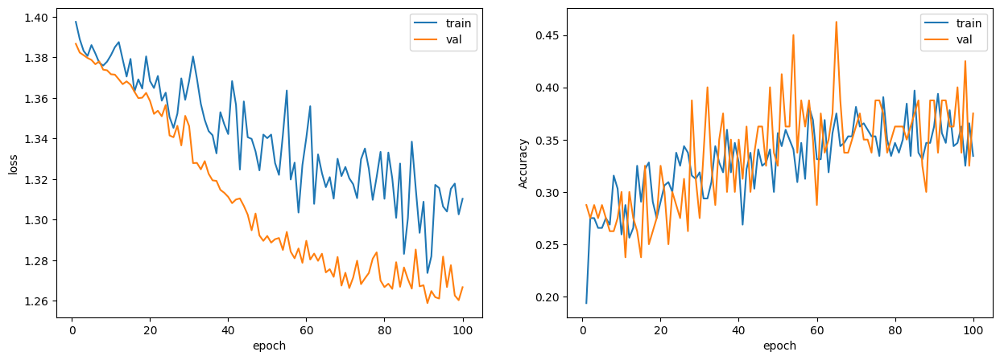

In [ ]:
train_acc_numpy = [tensor.cpu() for tensor in train_acc]
train_acc_numpy = np.array(train_acc_numpy)

plot_losses(train_loss, train_acc_numpy, val_loss, val_acc)


In [ ]:

preds = predict(model,test_loader)

conc_preds = torch.cat(preds, dim=0)
res = torch.argmax(conc_preds, dim=1)
res = res.cpu().numpy()



Testing: 100%|██████████| 2/2 [00:00<00:00, 245.28it/s]


In [ ]:
acc = accuracy_score(y_test, res)
print(f"Accuracy: {acc}")

Accuracy: 0.3


In [ ]:
num_epochs = 150

batch_size = 64
dropout_prob = 0.5
hidden_size = 512

input_size = x_train.shape[1]
output_size = y_train.max().item() + 1

train_dataset = TensorDataset(torch.tensor(x_train_val.values, dtype=torch.float32), torch.tensor(y_train_val.values, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(x_val.values, dtype=torch.float32), torch.tensor(y_val.values, dtype=torch.long))


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

model = LSTMClassifier(input_size, hidden_size, output_size, dropout_prob).to(device)
criterion = nn.CrossEntropyLoss()

optimizer = optim.SGD(model.parameters(), lr=0.15, momentum=0.9)
lambda1 = lambda epoch: 0.67 ** epoch
scheduler = optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lambda1)



train_loss, val_loss, train_acc, val_acc = train(model, optimizer, criterion, scheduler, train_loader, val_loader, num_epochs)


Validating epoch 1/150: 100%|██████████| 2/2 [00:00<00:00, 251.76it/s]
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:156: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


Epoch 1
 train loss: 1.3891542434692383, train acc: 0.21562500298023224
 val loss: 1.3868937969207764, val acc: 0.275



Validating epoch 2/150: 100%|██████████| 2/2 [00:00<00:00, 281.63it/s]


Epoch 2
 train loss: 1.3884194850921632, train acc: 0.29375001788139343
 val loss: 1.3819305181503296, val acc: 0.2625



Validating epoch 3/150: 100%|██████████| 2/2 [00:00<00:00, 337.98it/s]


Epoch 3
 train loss: 1.380557942390442, train acc: 0.2593750059604645
 val loss: 1.379506516456604, val acc: 0.275



Validating epoch 4/150: 100%|██████████| 2/2 [00:00<00:00, 323.25it/s]


Epoch 4
 train loss: 1.3890955448150635, train acc: 0.2562499940395355
 val loss: 1.3802363872528076, val acc: 0.2875



Validating epoch 5/150: 100%|██████████| 2/2 [00:00<00:00, 355.75it/s]


Epoch 5
 train loss: 1.388374400138855, train acc: 0.23749999701976776
 val loss: 1.3751464128494262, val acc: 0.3



Validating epoch 6/150: 100%|██████████| 2/2 [00:00<00:00, 346.92it/s]


Epoch 6
 train loss: 1.3751688480377198, train acc: 0.3125
 val loss: 1.3738101720809937, val acc: 0.2875



Validating epoch 7/150: 100%|██████████| 2/2 [00:00<00:00, 233.82it/s]


Epoch 7
 train loss: 1.388911747932434, train acc: 0.2906250059604645
 val loss: 1.3755293369293213, val acc: 0.275



Validating epoch 8/150: 100%|██████████| 2/2 [00:00<00:00, 302.25it/s]


Epoch 8
 train loss: 1.378869366645813, train acc: 0.2906250059604645
 val loss: 1.3793726205825805, val acc: 0.2625



Validating epoch 9/150: 100%|██████████| 2/2 [00:00<00:00, 312.13it/s]


Epoch 9
 train loss: 1.3967917203903197, train acc: 0.265625
 val loss: 1.3664549589157104, val acc: 0.25



Validating epoch 10/150: 100%|██████████| 2/2 [00:00<00:00, 268.02it/s]


Epoch 10
 train loss: 1.3921752452850342, train acc: 0.2750000059604645
 val loss: 1.3697952032089233, val acc: 0.2875



Validating epoch 11/150: 100%|██████████| 2/2 [00:00<00:00, 396.85it/s]


Epoch 11
 train loss: 1.3957177639007567, train acc: 0.2750000059604645
 val loss: 1.3623957872390746, val acc: 0.275



Validating epoch 12/150: 100%|██████████| 2/2 [00:00<00:00, 322.96it/s]


Epoch 12
 train loss: 1.3905144691467286, train acc: 0.2718749940395355
 val loss: 1.3627120494842528, val acc: 0.3



Validating epoch 13/150: 100%|██████████| 2/2 [00:00<00:00, 421.33it/s]


Epoch 13
 train loss: 1.3794893026351929, train acc: 0.3218750059604645
 val loss: 1.370954728126526, val acc: 0.2875



Validating epoch 14/150: 100%|██████████| 2/2 [00:00<00:00, 363.52it/s]


Epoch 14
 train loss: 1.3683091878890992, train acc: 0.26875001192092896
 val loss: 1.3649365901947021, val acc: 0.2375



Validating epoch 15/150: 100%|██████████| 2/2 [00:00<00:00, 409.78it/s]


Epoch 15
 train loss: 1.3747154474258423, train acc: 0.2906250059604645
 val loss: 1.353044867515564, val acc: 0.275



Validating epoch 16/150: 100%|██████████| 2/2 [00:00<00:00, 363.27it/s]


Epoch 16
 train loss: 1.3876228094100953, train acc: 0.2750000059604645
 val loss: 1.3430569648742676, val acc: 0.325



Validating epoch 17/150: 100%|██████████| 2/2 [00:00<00:00, 389.57it/s]


Epoch 17
 train loss: 1.3737064361572267, train acc: 0.296875
 val loss: 1.3450649738311768, val acc: 0.3



Validating epoch 18/150: 100%|██████████| 2/2 [00:00<00:00, 404.97it/s]


Epoch 18
 train loss: 1.3594535827636718, train acc: 0.3062500059604645
 val loss: 1.3432138681411743, val acc: 0.3875



Validating epoch 19/150: 100%|██████████| 2/2 [00:00<00:00, 388.45it/s]


Epoch 19
 train loss: 1.3605676651000977, train acc: 0.3218750059604645
 val loss: 1.3639643669128418, val acc: 0.275



Validating epoch 20/150: 100%|██████████| 2/2 [00:00<00:00, 360.57it/s]


Epoch 20
 train loss: 1.3639316320419312, train acc: 0.3218750059604645
 val loss: 1.3358999252319337, val acc: 0.35



Validating epoch 21/150: 100%|██████████| 2/2 [00:00<00:00, 395.45it/s]


Epoch 21
 train loss: 1.3870998859405517, train acc: 0.2750000059604645
 val loss: 1.3278681993484498, val acc: 0.3375



Validating epoch 22/150: 100%|██████████| 2/2 [00:00<00:00, 396.32it/s]


Epoch 22
 train loss: 1.3763956308364869, train acc: 0.3187499940395355
 val loss: 1.3326107740402222, val acc: 0.3375



Validating epoch 23/150: 100%|██████████| 2/2 [00:00<00:00, 370.28it/s]


Epoch 23
 train loss: 1.3595975399017335, train acc: 0.3187499940395355
 val loss: 1.340214776992798, val acc: 0.2875



Validating epoch 24/150: 100%|██████████| 2/2 [00:00<00:00, 263.08it/s]


Epoch 24
 train loss: 1.347727608680725, train acc: 0.3062500059604645
 val loss: 1.3240097284317016, val acc: 0.3125



Validating epoch 25/150: 100%|██████████| 2/2 [00:00<00:00, 369.98it/s]


Epoch 25
 train loss: 1.3577036142349244, train acc: 0.3218750059604645
 val loss: 1.3167466878890992, val acc: 0.325



Validating epoch 26/150: 100%|██████████| 2/2 [00:00<00:00, 208.26it/s]


Epoch 26
 train loss: 1.3586652517318725, train acc: 0.3062500059604645
 val loss: 1.3166749954223633, val acc: 0.3125



Validating epoch 27/150: 100%|██████████| 2/2 [00:00<00:00, 348.76it/s]


Epoch 27
 train loss: 1.3582273721694946, train acc: 0.3187499940395355
 val loss: 1.3114824771881104, val acc: 0.325



Validating epoch 28/150: 100%|██████████| 2/2 [00:00<00:00, 354.23it/s]


Epoch 28
 train loss: 1.3594043016433717, train acc: 0.31562501192092896
 val loss: 1.3209473609924316, val acc: 0.3



Validating epoch 29/150: 100%|██████████| 2/2 [00:00<00:00, 336.15it/s]


Epoch 29
 train loss: 1.376352310180664, train acc: 0.2750000059604645
 val loss: 1.3104142904281617, val acc: 0.35



Validating epoch 30/150: 100%|██████████| 2/2 [00:00<00:00, 368.63it/s]


Epoch 30
 train loss: 1.3792423725128173, train acc: 0.328125
 val loss: 1.337113046646118, val acc: 0.3125



Validating epoch 31/150: 100%|██████████| 2/2 [00:00<00:00, 397.53it/s]


Epoch 31
 train loss: 1.3636853218078613, train acc: 0.3062500059604645
 val loss: 1.3279044151306152, val acc: 0.3375



Validating epoch 32/150: 100%|██████████| 2/2 [00:00<00:00, 366.00it/s]


Epoch 32
 train loss: 1.4094437837600708, train acc: 0.28437501192092896
 val loss: 1.354189682006836, val acc: 0.3125



Validating epoch 33/150: 100%|██████████| 2/2 [00:00<00:00, 187.09it/s]


Epoch 33
 train loss: 1.3662281513214112, train acc: 0.30937501788139343
 val loss: 1.308204174041748, val acc: 0.3875



Validating epoch 34/150: 100%|██████████| 2/2 [00:00<00:00, 350.39it/s]


Epoch 34
 train loss: 1.3564077615737915, train acc: 0.296875
 val loss: 1.3058878898620605, val acc: 0.375



Validating epoch 35/150: 100%|██████████| 2/2 [00:00<00:00, 211.40it/s]


Epoch 35
 train loss: 1.369737195968628, train acc: 0.328125
 val loss: 1.3000955820083617, val acc: 0.35



Validating epoch 36/150: 100%|██████████| 2/2 [00:00<00:00, 324.50it/s]


Epoch 36
 train loss: 1.3605350255966187, train acc: 0.26875001192092896
 val loss: 1.3192741632461549, val acc: 0.35



Validating epoch 37/150: 100%|██████████| 2/2 [00:00<00:00, 239.51it/s]


Epoch 37
 train loss: 1.3579382181167603, train acc: 0.3531250059604645
 val loss: 1.3036407232284546, val acc: 0.35



Validating epoch 38/150: 100%|██████████| 2/2 [00:00<00:00, 333.24it/s]


Epoch 38
 train loss: 1.3384015321731568, train acc: 0.3499999940395355
 val loss: 1.2984917640686036, val acc: 0.425



Validating epoch 39/150: 100%|██████████| 2/2 [00:00<00:00, 406.21it/s]


Epoch 39
 train loss: 1.3146881341934205, train acc: 0.34062501788139343
 val loss: 1.3070398092269897, val acc: 0.3



Validating epoch 40/150: 100%|██████████| 2/2 [00:00<00:00, 383.85it/s]


Epoch 40
 train loss: 1.332770872116089, train acc: 0.30937501788139343
 val loss: 1.2933881998062133, val acc: 0.35



Validating epoch 41/150: 100%|██████████| 2/2 [00:00<00:00, 379.97it/s]


Epoch 41
 train loss: 1.3437194347381591, train acc: 0.30937501788139343
 val loss: 1.2858784437179565, val acc: 0.35



Validating epoch 42/150: 100%|██████████| 2/2 [00:00<00:00, 381.13it/s]


Epoch 42
 train loss: 1.3346123933792113, train acc: 0.3031249940395355
 val loss: 1.2840405702590942, val acc: 0.3625



Validating epoch 43/150: 100%|██████████| 2/2 [00:00<00:00, 354.64it/s]


Epoch 43
 train loss: 1.3353420734405517, train acc: 0.3531250059604645
 val loss: 1.280252456665039, val acc: 0.3625



Validating epoch 44/150: 100%|██████████| 2/2 [00:00<00:00, 256.08it/s]


Epoch 44
 train loss: 1.335137939453125, train acc: 0.32500001788139343
 val loss: 1.2810993671417237, val acc: 0.35



Validating epoch 45/150: 100%|██████████| 2/2 [00:00<00:00, 232.42it/s]


Epoch 45
 train loss: 1.323682928085327, train acc: 0.34687501192092896
 val loss: 1.2791854381561278, val acc: 0.4125



Validating epoch 46/150: 100%|██████████| 2/2 [00:00<00:00, 235.11it/s]


Epoch 46
 train loss: 1.3201561212539672, train acc: 0.34062501788139343
 val loss: 1.2802969455718993, val acc: 0.375



Validating epoch 47/150: 100%|██████████| 2/2 [00:00<00:00, 387.11it/s]


Epoch 47
 train loss: 1.3233384370803833, train acc: 0.3218750059604645
 val loss: 1.2791549682617187, val acc: 0.325



Validating epoch 48/150: 100%|██████████| 2/2 [00:00<00:00, 246.21it/s]


Epoch 48
 train loss: 1.3280771732330323, train acc: 0.34375
 val loss: 1.2912160873413085, val acc: 0.3375



Validating epoch 49/150: 100%|██████████| 2/2 [00:00<00:00, 401.98it/s]


Epoch 49
 train loss: 1.3321407079696654, train acc: 0.3343749940395355
 val loss: 1.2726398229598999, val acc: 0.3375



Validating epoch 50/150: 100%|██████████| 2/2 [00:00<00:00, 406.68it/s]


Epoch 50
 train loss: 1.3377731323242188, train acc: 0.3531250059604645
 val loss: 1.2986647367477417, val acc: 0.3375



Validating epoch 51/150: 100%|██████████| 2/2 [00:00<00:00, 376.78it/s]


Epoch 51
 train loss: 1.3206768035888672, train acc: 0.3187499940395355
 val loss: 1.2896002292633058, val acc: 0.4



Validating epoch 52/150: 100%|██████████| 2/2 [00:00<00:00, 175.20it/s]


Epoch 52
 train loss: 1.3300895690917969, train acc: 0.3187499940395355
 val loss: 1.291352677345276, val acc: 0.3375



Validating epoch 53/150: 100%|██████████| 2/2 [00:00<00:00, 342.25it/s]


Epoch 53
 train loss: 1.3162972450256347, train acc: 0.3375000059604645
 val loss: 1.280373740196228, val acc: 0.3625



Validating epoch 54/150: 100%|██████████| 2/2 [00:00<00:00, 321.87it/s]


Epoch 54
 train loss: 1.329805564880371, train acc: 0.359375
 val loss: 1.2817830085754394, val acc: 0.35



Validating epoch 55/150: 100%|██████████| 2/2 [00:00<00:00, 319.52it/s]


Epoch 55
 train loss: 1.3287414073944093, train acc: 0.3031249940395355
 val loss: 1.2704021692276002, val acc: 0.35



Validating epoch 56/150: 100%|██████████| 2/2 [00:00<00:00, 324.26it/s]


Epoch 56
 train loss: 1.324679470062256, train acc: 0.3062500059604645
 val loss: 1.274700117111206, val acc: 0.3375



Validating epoch 57/150: 100%|██████████| 2/2 [00:00<00:00, 291.71it/s]


Epoch 57
 train loss: 1.326322865486145, train acc: 0.38750001788139343
 val loss: 1.2683420181274414, val acc: 0.3625



Validating epoch 58/150: 100%|██████████| 2/2 [00:00<00:00, 222.04it/s]


Epoch 58
 train loss: 1.3144170999526978, train acc: 0.3656249940395355
 val loss: 1.2646492958068847, val acc: 0.3875



Validating epoch 59/150: 100%|██████████| 2/2 [00:00<00:00, 364.90it/s]


Epoch 59
 train loss: 1.3184873580932617, train acc: 0.359375
 val loss: 1.266921615600586, val acc: 0.3625



Validating epoch 60/150: 100%|██████████| 2/2 [00:00<00:00, 225.90it/s]


Epoch 60
 train loss: 1.3342159986495972, train acc: 0.359375
 val loss: 1.2730278968811035, val acc: 0.3625



Validating epoch 61/150: 100%|██████████| 2/2 [00:00<00:00, 263.88it/s]


Epoch 61
 train loss: 1.3244361639022828, train acc: 0.33125001192092896
 val loss: 1.281943440437317, val acc: 0.3625



Validating epoch 62/150: 100%|██████████| 2/2 [00:00<00:00, 202.04it/s]


Epoch 62
 train loss: 1.321131157875061, train acc: 0.3499999940395355
 val loss: 1.2725153684616088, val acc: 0.325



Validating epoch 63/150: 100%|██████████| 2/2 [00:00<00:00, 329.99it/s]


Epoch 63
 train loss: 1.3283665180206299, train acc: 0.3656249940395355
 val loss: 1.2743735790252686, val acc: 0.375



Validating epoch 64/150: 100%|██████████| 2/2 [00:00<00:00, 228.52it/s]


Epoch 64
 train loss: 1.3375881910324097, train acc: 0.3187499940395355
 val loss: 1.2819447278976441, val acc: 0.425



Validating epoch 65/150: 100%|██████████| 2/2 [00:00<00:00, 234.69it/s]


Epoch 65
 train loss: 1.3267518281936646, train acc: 0.3218750059604645
 val loss: 1.2755411624908448, val acc: 0.325



Validating epoch 66/150: 100%|██████████| 2/2 [00:00<00:00, 226.86it/s]


Epoch 66
 train loss: 1.3280890226364135, train acc: 0.3656249940395355
 val loss: 1.2689628601074219, val acc: 0.3625



Validating epoch 67/150: 100%|██████████| 2/2 [00:00<00:00, 311.18it/s]


Epoch 67
 train loss: 1.333569598197937, train acc: 0.3343749940395355
 val loss: 1.2785572052001952, val acc: 0.375



Validating epoch 68/150: 100%|██████████| 2/2 [00:00<00:00, 313.35it/s]


Epoch 68
 train loss: 1.2887797117233277, train acc: 0.40625
 val loss: 1.281547975540161, val acc: 0.3125



Validating epoch 69/150: 100%|██████████| 2/2 [00:00<00:00, 207.71it/s]


Epoch 69
 train loss: 1.3194514989852906, train acc: 0.359375
 val loss: 1.2704355716705322, val acc: 0.4



Validating epoch 70/150: 100%|██████████| 2/2 [00:00<00:00, 325.20it/s]


Epoch 70
 train loss: 1.3198135375976563, train acc: 0.34062501788139343
 val loss: 1.277681255340576, val acc: 0.325



Validating epoch 71/150: 100%|██████████| 2/2 [00:00<00:00, 299.35it/s]


Epoch 71
 train loss: 1.2967702150344849, train acc: 0.37812501192092896
 val loss: 1.2732105016708375, val acc: 0.3875



Validating epoch 72/150: 100%|██████████| 2/2 [00:00<00:00, 274.11it/s]


Epoch 72
 train loss: 1.3121241569519042, train acc: 0.359375
 val loss: 1.273010754585266, val acc: 0.35



Validating epoch 73/150: 100%|██████████| 2/2 [00:00<00:00, 353.79it/s]


Epoch 73
 train loss: 1.3090939044952392, train acc: 0.3531250059604645
 val loss: 1.2633792161941528, val acc: 0.375



Validating epoch 74/150: 100%|██████████| 2/2 [00:00<00:00, 403.30it/s]


Epoch 74
 train loss: 1.3121291399002075, train acc: 0.36250001192092896
 val loss: 1.2659661293029785, val acc: 0.375



Validating epoch 75/150: 100%|██████████| 2/2 [00:00<00:00, 386.16it/s]


Epoch 75
 train loss: 1.3219728231430055, train acc: 0.34687501192092896
 val loss: 1.264806604385376, val acc: 0.3875



Validating epoch 76/150: 100%|██████████| 2/2 [00:00<00:00, 445.66it/s]


Epoch 76
 train loss: 1.317199444770813, train acc: 0.3375000059604645
 val loss: 1.2615547180175781, val acc: 0.3375



Validating epoch 77/150: 100%|██████████| 2/2 [00:00<00:00, 356.55it/s]


Epoch 77
 train loss: 1.3413613319396973, train acc: 0.3375000059604645
 val loss: 1.2618453979492188, val acc: 0.325



Validating epoch 78/150: 100%|██████████| 2/2 [00:00<00:00, 406.17it/s]


Epoch 78
 train loss: 1.3200957536697389, train acc: 0.34375
 val loss: 1.2642325639724732, val acc: 0.375



Validating epoch 79/150: 100%|██████████| 2/2 [00:00<00:00, 401.18it/s]


Epoch 79
 train loss: 1.2973762512207032, train acc: 0.37812501192092896
 val loss: 1.2658726692199707, val acc: 0.3875



Validating epoch 80/150: 100%|██████████| 2/2 [00:00<00:00, 252.46it/s]


Epoch 80
 train loss: 1.3132185697555543, train acc: 0.36250001192092896
 val loss: 1.2751094102859497, val acc: 0.325



Validating epoch 81/150: 100%|██████████| 2/2 [00:00<00:00, 331.15it/s]


Epoch 81
 train loss: 1.2934364557266236, train acc: 0.359375
 val loss: 1.2701242685317993, val acc: 0.4



Validating epoch 82/150: 100%|██████████| 2/2 [00:00<00:00, 332.62it/s]


Epoch 82
 train loss: 1.297051763534546, train acc: 0.37812501192092896
 val loss: 1.2702884674072266, val acc: 0.4



Validating epoch 83/150: 100%|██████████| 2/2 [00:00<00:00, 356.75it/s]


Epoch 83
 train loss: 1.303981351852417, train acc: 0.3687500059604645
 val loss: 1.2711427211761475, val acc: 0.4125



Validating epoch 84/150: 100%|██████████| 2/2 [00:00<00:00, 360.66it/s]


Epoch 84
 train loss: 1.2960659503936767, train acc: 0.3656249940395355
 val loss: 1.2766442775726319, val acc: 0.3375



Validating epoch 85/150: 100%|██████████| 2/2 [00:00<00:00, 368.12it/s]


Epoch 85
 train loss: 1.2974053382873536, train acc: 0.37187501788139343
 val loss: 1.264254879951477, val acc: 0.35



Validating epoch 86/150: 100%|██████████| 2/2 [00:00<00:00, 348.10it/s]


Epoch 86
 train loss: 1.307801604270935, train acc: 0.38750001788139343
 val loss: 1.2629525423049928, val acc: 0.35



Validating epoch 87/150: 100%|██████████| 2/2 [00:00<00:00, 325.95it/s]


Epoch 87
 train loss: 1.310304594039917, train acc: 0.34062501788139343
 val loss: 1.2621921062469483, val acc: 0.4



Validating epoch 88/150: 100%|██████████| 2/2 [00:00<00:00, 342.95it/s]


Epoch 88
 train loss: 1.29601891040802, train acc: 0.36250001192092896
 val loss: 1.2637932300567627, val acc: 0.3625



Validating epoch 89/150: 100%|██████████| 2/2 [00:00<00:00, 366.86it/s]


Epoch 89
 train loss: 1.3050304651260376, train acc: 0.3499999940395355
 val loss: 1.2736632585525514, val acc: 0.4125



Validating epoch 90/150: 100%|██████████| 2/2 [00:00<00:00, 360.07it/s]


Epoch 90
 train loss: 1.2751469373703004, train acc: 0.3812499940395355
 val loss: 1.2607876777648925, val acc: 0.4



Validating epoch 91/150: 100%|██████████| 2/2 [00:00<00:00, 372.91it/s]


Epoch 91
 train loss: 1.3218772649765014, train acc: 0.36250001192092896
 val loss: 1.2721746921539308, val acc: 0.35



Validating epoch 92/150: 100%|██████████| 2/2 [00:00<00:00, 334.43it/s]


Epoch 92
 train loss: 1.3306446075439453, train acc: 0.34375
 val loss: 1.2593183755874633, val acc: 0.3375



Validating epoch 93/150: 100%|██████████| 2/2 [00:00<00:00, 349.60it/s]


Epoch 93
 train loss: 1.2789677143096925, train acc: 0.3812499940395355
 val loss: 1.2622635126113892, val acc: 0.3625



Validating epoch 94/150: 100%|██████████| 2/2 [00:00<00:00, 358.24it/s]


Epoch 94
 train loss: 1.2657934188842774, train acc: 0.40312501788139343
 val loss: 1.2668344736099244, val acc: 0.375



Validating epoch 95/150: 100%|██████████| 2/2 [00:00<00:00, 312.41it/s]


Epoch 95
 train loss: 1.282006025314331, train acc: 0.359375
 val loss: 1.2544400453567506, val acc: 0.3625



Validating epoch 96/150: 100%|██████████| 2/2 [00:00<00:00, 282.43it/s]


Epoch 96
 train loss: 1.2914836883544922, train acc: 0.35625001788139343
 val loss: 1.2516288995742797, val acc: 0.3875



Validating epoch 97/150: 100%|██████████| 2/2 [00:00<00:00, 323.29it/s]


Epoch 97
 train loss: 1.3091100454330444, train acc: 0.36250001192092896
 val loss: 1.2643569469451905, val acc: 0.375



Validating epoch 98/150: 100%|██████████| 2/2 [00:00<00:00, 321.97it/s]


Epoch 98
 train loss: 1.3011991262435914, train acc: 0.37187501788139343
 val loss: 1.2631722927093505, val acc: 0.3875



Validating epoch 99/150: 100%|██████████| 2/2 [00:00<00:00, 368.84it/s]


Epoch 99
 train loss: 1.3054534912109375, train acc: 0.3968749940395355
 val loss: 1.2762873888015747, val acc: 0.4125



Validating epoch 100/150: 100%|██████████| 2/2 [00:00<00:00, 374.99it/s]


Epoch 100
 train loss: 1.2954716205596923, train acc: 0.3687500059604645
 val loss: 1.261901330947876, val acc: 0.35



Validating epoch 101/150: 100%|██████████| 2/2 [00:00<00:00, 356.40it/s]


Epoch 101
 train loss: 1.3002473354339599, train acc: 0.3656249940395355
 val loss: 1.2590023040771485, val acc: 0.3625



Validating epoch 102/150: 100%|██████████| 2/2 [00:00<00:00, 353.80it/s]


Epoch 102
 train loss: 1.283866810798645, train acc: 0.37187501788139343
 val loss: 1.2523475170135498, val acc: 0.375



Validating epoch 103/150: 100%|██████████| 2/2 [00:00<00:00, 366.30it/s]


Epoch 103
 train loss: 1.259356474876404, train acc: 0.4468750059604645
 val loss: 1.2570621967315674, val acc: 0.375



Validating epoch 104/150: 100%|██████████| 2/2 [00:00<00:00, 290.83it/s]


Epoch 104
 train loss: 1.2826188802719116, train acc: 0.39375001192092896
 val loss: 1.269425368309021, val acc: 0.35



Validating epoch 105/150: 100%|██████████| 2/2 [00:00<00:00, 298.03it/s]


Epoch 105
 train loss: 1.2720256805419923, train acc: 0.3843750059604645
 val loss: 1.2502070903778075, val acc: 0.3625



Validating epoch 106/150: 100%|██████████| 2/2 [00:00<00:00, 304.06it/s]


Epoch 106
 train loss: 1.2707114219665527, train acc: 0.3531250059604645
 val loss: 1.2487420082092284, val acc: 0.375



Validating epoch 107/150: 100%|██████████| 2/2 [00:00<00:00, 269.14it/s]


Epoch 107
 train loss: 1.2761229991912841, train acc: 0.39375001192092896
 val loss: 1.247746729850769, val acc: 0.375



Validating epoch 108/150: 100%|██████████| 2/2 [00:00<00:00, 357.14it/s]


Epoch 108
 train loss: 1.2918771505355835, train acc: 0.37187501788139343
 val loss: 1.2493747234344483, val acc: 0.3625



Validating epoch 109/150: 100%|██████████| 2/2 [00:00<00:00, 441.41it/s]


Epoch 109
 train loss: 1.2802277326583862, train acc: 0.38750001788139343
 val loss: 1.249423122406006, val acc: 0.375



Validating epoch 110/150: 100%|██████████| 2/2 [00:00<00:00, 318.72it/s]


Epoch 110
 train loss: 1.285525369644165, train acc: 0.3968749940395355
 val loss: 1.2525297403335571, val acc: 0.3875



Validating epoch 111/150: 100%|██████████| 2/2 [00:00<00:00, 291.00it/s]


Epoch 111
 train loss: 1.2764372825622559, train acc: 0.4156250059604645
 val loss: 1.2479127407073975, val acc: 0.3875



Validating epoch 112/150: 100%|██████████| 2/2 [00:00<00:00, 365.77it/s]


Epoch 112
 train loss: 1.265351152420044, train acc: 0.3968749940395355
 val loss: 1.2631489038467407, val acc: 0.4125



Validating epoch 113/150: 100%|██████████| 2/2 [00:00<00:00, 347.53it/s]


Epoch 113
 train loss: 1.2755137920379638, train acc: 0.41875001788139343
 val loss: 1.2548141002655029, val acc: 0.3875



Validating epoch 114/150: 100%|██████████| 2/2 [00:00<00:00, 367.41it/s]


Epoch 114
 train loss: 1.2444082736968993, train acc: 0.40625
 val loss: 1.2567832946777344, val acc: 0.425



Validating epoch 115/150: 100%|██████████| 2/2 [00:00<00:00, 366.22it/s]


Epoch 115
 train loss: 1.3139684915542602, train acc: 0.3343749940395355
 val loss: 1.2537957191467286, val acc: 0.4125



Validating epoch 116/150: 100%|██████████| 2/2 [00:00<00:00, 269.39it/s]


Epoch 116
 train loss: 1.260963463783264, train acc: 0.40937501192092896
 val loss: 1.2551151275634767, val acc: 0.35



Validating epoch 117/150: 100%|██████████| 2/2 [00:00<00:00, 288.69it/s]


Epoch 117
 train loss: 1.2942351579666138, train acc: 0.3812499940395355
 val loss: 1.2717220783233643, val acc: 0.3875



Validating epoch 118/150: 100%|██████████| 2/2 [00:00<00:00, 352.70it/s]


Epoch 118
 train loss: 1.2716688632965087, train acc: 0.4156250059604645
 val loss: 1.250418758392334, val acc: 0.3375



Validating epoch 119/150: 100%|██████████| 2/2 [00:00<00:00, 197.40it/s]


Epoch 119
 train loss: 1.28948175907135, train acc: 0.3656249940395355
 val loss: 1.251734447479248, val acc: 0.3875



Validating epoch 120/150: 100%|██████████| 2/2 [00:00<00:00, 257.06it/s]


Epoch 120
 train loss: 1.2681287288665772, train acc: 0.3968749940395355
 val loss: 1.2420279026031493, val acc: 0.3875



Validating epoch 121/150: 100%|██████████| 2/2 [00:00<00:00, 410.10it/s]


Epoch 121
 train loss: 1.2981251239776612, train acc: 0.37187501788139343
 val loss: 1.2454667329788207, val acc: 0.3625



Validating epoch 122/150: 100%|██████████| 2/2 [00:00<00:00, 402.31it/s]


Epoch 122
 train loss: 1.2462892293930055, train acc: 0.4156250059604645
 val loss: 1.2529318809509278, val acc: 0.3875



Validating epoch 123/150: 100%|██████████| 2/2 [00:00<00:00, 293.23it/s]


Epoch 123
 train loss: 1.2851080894470215, train acc: 0.3812499940395355
 val loss: 1.2583992958068848, val acc: 0.4125



Validating epoch 124/150: 100%|██████████| 2/2 [00:00<00:00, 308.57it/s]


Epoch 124
 train loss: 1.2669274091720581, train acc: 0.40937501192092896
 val loss: 1.248620080947876, val acc: 0.375



Validating epoch 125/150: 100%|██████████| 2/2 [00:00<00:00, 360.15it/s]


Epoch 125
 train loss: 1.250590944290161, train acc: 0.3968749940395355
 val loss: 1.2516801595687865, val acc: 0.4125



Validating epoch 126/150: 100%|██████████| 2/2 [00:00<00:00, 325.87it/s]


Epoch 126
 train loss: 1.2590769529342651, train acc: 0.375
 val loss: 1.2568003177642821, val acc: 0.4375



Validating epoch 127/150: 100%|██████████| 2/2 [00:00<00:00, 370.01it/s]


Epoch 127
 train loss: 1.289325475692749, train acc: 0.36250001192092896
 val loss: 1.2432446718215941, val acc: 0.375



Validating epoch 128/150: 100%|██████████| 2/2 [00:00<00:00, 365.09it/s]


Epoch 128
 train loss: 1.266482424736023, train acc: 0.40625
 val loss: 1.2544005393981934, val acc: 0.3875



Validating epoch 129/150: 100%|██████████| 2/2 [00:00<00:00, 460.46it/s]


Epoch 129
 train loss: 1.2850643157958985, train acc: 0.3531250059604645
 val loss: 1.2523717880249023, val acc: 0.3875



Validating epoch 130/150: 100%|██████████| 2/2 [00:00<00:00, 361.77it/s]


Epoch 130
 train loss: 1.2712575674057007, train acc: 0.37187501788139343
 val loss: 1.2506241083145142, val acc: 0.3625



Validating epoch 131/150: 100%|██████████| 2/2 [00:00<00:00, 362.22it/s]


Epoch 131
 train loss: 1.2474385499954224, train acc: 0.375
 val loss: 1.2582472085952758, val acc: 0.4



Validating epoch 132/150: 100%|██████████| 2/2 [00:00<00:00, 375.40it/s]


Epoch 132
 train loss: 1.2430162191390992, train acc: 0.3687500059604645
 val loss: 1.250265884399414, val acc: 0.375



Validating epoch 133/150: 100%|██████████| 2/2 [00:00<00:00, 372.69it/s]


Epoch 133
 train loss: 1.3033309936523438, train acc: 0.40312501788139343
 val loss: 1.25409677028656, val acc: 0.4375



Validating epoch 134/150: 100%|██████████| 2/2 [00:00<00:00, 371.33it/s]


Epoch 134
 train loss: 1.2947419881820679, train acc: 0.3687500059604645
 val loss: 1.2722565174102782, val acc: 0.3875



Validating epoch 135/150: 100%|██████████| 2/2 [00:00<00:00, 315.88it/s]


Epoch 135
 train loss: 1.222480797767639, train acc: 0.45000001788139343
 val loss: 1.2607181310653686, val acc: 0.375



Validating epoch 136/150: 100%|██████████| 2/2 [00:00<00:00, 315.04it/s]


Epoch 136
 train loss: 1.254233717918396, train acc: 0.41875001788139343
 val loss: 1.271010732650757, val acc: 0.4125



Validating epoch 137/150: 100%|██████████| 2/2 [00:00<00:00, 330.96it/s]


Epoch 137
 train loss: 1.2721417903900147, train acc: 0.3812499940395355
 val loss: 1.2556106328964234, val acc: 0.425



Validating epoch 138/150: 100%|██████████| 2/2 [00:00<00:00, 378.67it/s]


Epoch 138
 train loss: 1.2556989669799805, train acc: 0.375
 val loss: 1.256279182434082, val acc: 0.425



Validating epoch 139/150: 100%|██████████| 2/2 [00:00<00:00, 333.58it/s]


Epoch 139
 train loss: 1.2658580541610718, train acc: 0.4124999940395355
 val loss: 1.2383514881134032, val acc: 0.3625



Validating epoch 140/150: 100%|██████████| 2/2 [00:00<00:00, 348.65it/s]


Epoch 140
 train loss: 1.2191269159317017, train acc: 0.41875001788139343
 val loss: 1.2480047702789308, val acc: 0.4375



Validating epoch 141/150: 100%|██████████| 2/2 [00:00<00:00, 190.65it/s]


Epoch 141
 train loss: 1.2439181089401246, train acc: 0.40312501788139343
 val loss: 1.2413299322128295, val acc: 0.35



Validating epoch 142/150: 100%|██████████| 2/2 [00:00<00:00, 336.06it/s]


Epoch 142
 train loss: 1.2385166883468628, train acc: 0.4156250059604645
 val loss: 1.2506531476974487, val acc: 0.4125



Validating epoch 143/150: 100%|██████████| 2/2 [00:00<00:00, 309.34it/s]


Epoch 143
 train loss: 1.2381941556930542, train acc: 0.42500001192092896
 val loss: 1.2422974109649658, val acc: 0.3875



Validating epoch 144/150: 100%|██████████| 2/2 [00:00<00:00, 361.52it/s]


Epoch 144
 train loss: 1.2690659523010255, train acc: 0.39375001192092896
 val loss: 1.2589487791061402, val acc: 0.375



Validating epoch 145/150: 100%|██████████| 2/2 [00:00<00:00, 352.86it/s]


Epoch 145
 train loss: 1.2414903402328492, train acc: 0.4156250059604645
 val loss: 1.2442391872406007, val acc: 0.3875



Validating epoch 146/150: 100%|██████████| 2/2 [00:00<00:00, 268.37it/s]


Epoch 146
 train loss: 1.2664853572845458, train acc: 0.37812501192092896
 val loss: 1.2506837844848633, val acc: 0.425



Validating epoch 147/150: 100%|██████████| 2/2 [00:00<00:00, 382.33it/s]


Epoch 147
 train loss: 1.2615533351898194, train acc: 0.37187501788139343
 val loss: 1.2468707084655761, val acc: 0.375



Validating epoch 148/150: 100%|██████████| 2/2 [00:00<00:00, 363.44it/s]


Epoch 148
 train loss: 1.2333065271377563, train acc: 0.4281249940395355
 val loss: 1.2399107933044433, val acc: 0.4



Validating epoch 149/150: 100%|██████████| 2/2 [00:00<00:00, 269.46it/s]


Epoch 149
 train loss: 1.2338088274002075, train acc: 0.421875
 val loss: 1.2389678955078125, val acc: 0.4



Validating epoch 150/150: 100%|██████████| 2/2 [00:00<00:00, 267.81it/s]

Epoch 150
 train loss: 1.2351556062698363, train acc: 0.4375
 val loss: 1.2386260032653809, val acc: 0.3875



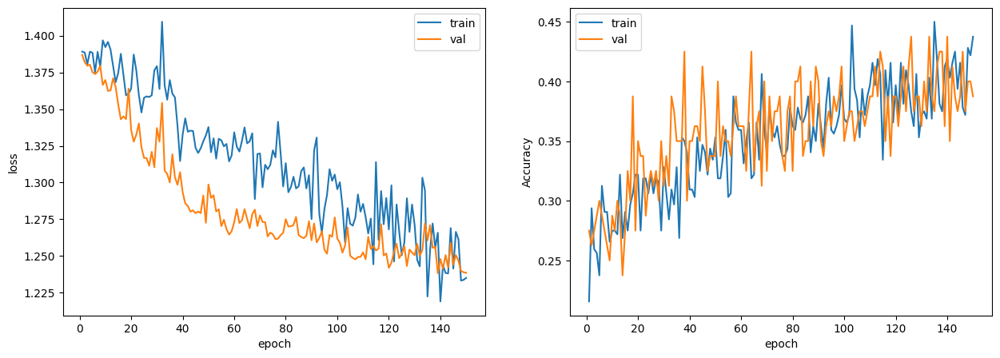

In [ ]:
train_acc_numpy = [tensor.cpu() for tensor in train_acc]
train_acc_numpy = np.array(train_acc_numpy)

plot_losses(train_loss, train_acc_numpy, val_loss, val_acc)


In [ ]:
preds = predict(model,test_loader)

conc_preds = torch.cat(preds, dim=0)
res = torch.argmax(conc_preds, dim=1)
res = res.cpu().numpy()



Testing: 100%|██████████| 2/2 [00:00<00:00, 262.40it/s]


In [ ]:
acc = accuracy_score(y_test, res)
print(f"Accuracy: {acc}")

Accuracy: 0.4


### Exponential

In [ ]:
num_epochs = 150

batch_size = 64
dropout_prob = 0.5
hidden_size = 512

input_size = x_train.shape[1]
output_size = y_train.max().item() + 1

train_dataset = TensorDataset(torch.tensor(x_train_val.values, dtype=torch.float32), torch.tensor(y_train_val.values, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(x_val.values, dtype=torch.float32), torch.tensor(y_val.values, dtype=torch.long))


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

model = LSTMClassifier(input_size, hidden_size, output_size, dropout_prob).to(device)
criterion = nn.CrossEntropyLoss()

optimizer = optim.SGD(model.parameters(), lr=0.15, momentum=0.9)

scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.6)



train_loss, val_loss, train_acc, val_acc = train(model, optimizer, criterion, scheduler, train_loader, val_loader, num_epochs)


Validating epoch 1/150: 100%|██████████| 2/2 [00:00<00:00, 353.38it/s]
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:156: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


Epoch 1
 train loss: 1.3961948871612548, train acc: 0.24687500298023224
 val loss: 1.3849100351333619, val acc: 0.275



Validating epoch 2/150: 100%|██████████| 2/2 [00:00<00:00, 422.32it/s]


Epoch 2
 train loss: 1.3803675651550293, train acc: 0.29375001788139343
 val loss: 1.3827191829681396, val acc: 0.275



Validating epoch 3/150: 100%|██████████| 2/2 [00:00<00:00, 410.08it/s]


Epoch 3
 train loss: 1.386583113670349, train acc: 0.29375001788139343
 val loss: 1.381744122505188, val acc: 0.275



Validating epoch 4/150: 100%|██████████| 2/2 [00:00<00:00, 408.09it/s]


Epoch 4
 train loss: 1.3875740051269532, train acc: 0.3062500059604645
 val loss: 1.3814006805419923, val acc: 0.275



Validating epoch 5/150: 100%|██████████| 2/2 [00:00<00:00, 385.51it/s]


Epoch 5
 train loss: 1.3813778638839722, train acc: 0.3031249940395355
 val loss: 1.3772738456726075, val acc: 0.275



Validating epoch 6/150: 100%|██████████| 2/2 [00:00<00:00, 459.10it/s]


Epoch 6
 train loss: 1.3844814538955688, train acc: 0.28437501192092896
 val loss: 1.3753413915634156, val acc: 0.275



Validating epoch 7/150: 100%|██████████| 2/2 [00:00<00:00, 254.43it/s]


Epoch 7
 train loss: 1.3793167352676392, train acc: 0.2906250059604645
 val loss: 1.3740679264068603, val acc: 0.275



Validating epoch 8/150: 100%|██████████| 2/2 [00:00<00:00, 297.63it/s]


Epoch 8
 train loss: 1.380293846130371, train acc: 0.2562499940395355
 val loss: 1.3779201269149781, val acc: 0.2625



Validating epoch 9/150: 100%|██████████| 2/2 [00:00<00:00, 366.63it/s]


Epoch 9
 train loss: 1.3819091081619264, train acc: 0.28125
 val loss: 1.3719825506210328, val acc: 0.3375



Validating epoch 10/150: 100%|██████████| 2/2 [00:00<00:00, 414.70it/s]


Epoch 10
 train loss: 1.3887153625488282, train acc: 0.30000001192092896
 val loss: 1.3693133115768432, val acc: 0.3125



Validating epoch 11/150: 100%|██████████| 2/2 [00:00<00:00, 302.76it/s]


Epoch 11
 train loss: 1.3880106925964355, train acc: 0.2562499940395355
 val loss: 1.3767531156539916, val acc: 0.275



Validating epoch 12/150: 100%|██████████| 2/2 [00:00<00:00, 327.53it/s]


Epoch 12
 train loss: 1.3619030714035034, train acc: 0.3062500059604645
 val loss: 1.3654377460479736, val acc: 0.35



Validating epoch 13/150: 100%|██████████| 2/2 [00:00<00:00, 417.95it/s]


Epoch 13
 train loss: 1.3792415618896485, train acc: 0.29375001788139343
 val loss: 1.3637751340866089, val acc: 0.275



Validating epoch 14/150: 100%|██████████| 2/2 [00:00<00:00, 345.59it/s]


Epoch 14
 train loss: 1.370236611366272, train acc: 0.3218750059604645
 val loss: 1.3751894235610962, val acc: 0.2625



Validating epoch 15/150: 100%|██████████| 2/2 [00:00<00:00, 297.36it/s]


Epoch 15
 train loss: 1.372455644607544, train acc: 0.3125
 val loss: 1.3654484748840332, val acc: 0.275



Validating epoch 16/150: 100%|██████████| 2/2 [00:00<00:00, 297.84it/s]


Epoch 16
 train loss: 1.3733993291854858, train acc: 0.3062500059604645
 val loss: 1.358271026611328, val acc: 0.3125



Validating epoch 17/150: 100%|██████████| 2/2 [00:00<00:00, 348.62it/s]


Epoch 17
 train loss: 1.3724162340164185, train acc: 0.3031249940395355
 val loss: 1.3614578008651734, val acc: 0.3



Validating epoch 18/150: 100%|██████████| 2/2 [00:00<00:00, 315.18it/s]


Epoch 18
 train loss: 1.3572808027267456, train acc: 0.3031249940395355
 val loss: 1.3516860961914063, val acc: 0.3875



Validating epoch 19/150: 100%|██████████| 2/2 [00:00<00:00, 204.65it/s]


Epoch 19
 train loss: 1.3797964334487915, train acc: 0.29375001788139343
 val loss: 1.3510602474212647, val acc: 0.3



Validating epoch 20/150: 100%|██████████| 2/2 [00:00<00:00, 280.41it/s]


Epoch 20
 train loss: 1.3706510543823243, train acc: 0.296875
 val loss: 1.3439093112945557, val acc: 0.2875



Validating epoch 21/150: 100%|██████████| 2/2 [00:00<00:00, 313.91it/s]


Epoch 21
 train loss: 1.368332815170288, train acc: 0.2874999940395355
 val loss: 1.341346836090088, val acc: 0.325



Validating epoch 22/150: 100%|██████████| 2/2 [00:00<00:00, 328.26it/s]


Epoch 22
 train loss: 1.3860299587249756, train acc: 0.26250001788139343
 val loss: 1.3424714803695679, val acc: 0.275



Validating epoch 23/150: 100%|██████████| 2/2 [00:00<00:00, 338.51it/s]


Epoch 23
 train loss: 1.3706279754638673, train acc: 0.3031249940395355
 val loss: 1.3371329307556152, val acc: 0.3375



Validating epoch 24/150: 100%|██████████| 2/2 [00:00<00:00, 332.62it/s]


Epoch 24
 train loss: 1.3523298501968384, train acc: 0.3218750059604645
 val loss: 1.3424717664718628, val acc: 0.3



Validating epoch 25/150: 100%|██████████| 2/2 [00:00<00:00, 321.49it/s]


Epoch 25
 train loss: 1.3845517873764037, train acc: 0.2874999940395355
 val loss: 1.332341980934143, val acc: 0.275



Validating epoch 26/150: 100%|██████████| 2/2 [00:00<00:00, 219.56it/s]


Epoch 26
 train loss: 1.354100513458252, train acc: 0.3218750059604645
 val loss: 1.329472279548645, val acc: 0.3375



Validating epoch 27/150: 100%|██████████| 2/2 [00:00<00:00, 315.61it/s]


Epoch 27
 train loss: 1.3624319553375244, train acc: 0.28437501192092896
 val loss: 1.3308845996856689, val acc: 0.4375



Validating epoch 28/150: 100%|██████████| 2/2 [00:00<00:00, 402.27it/s]


Epoch 28
 train loss: 1.3500816345214843, train acc: 0.3343749940395355
 val loss: 1.3436273097991944, val acc: 0.2875



Validating epoch 29/150: 100%|██████████| 2/2 [00:00<00:00, 364.85it/s]


Epoch 29
 train loss: 1.3671894550323487, train acc: 0.31562501192092896
 val loss: 1.3229430675506593, val acc: 0.3375



Validating epoch 30/150: 100%|██████████| 2/2 [00:00<00:00, 369.98it/s]


Epoch 30
 train loss: 1.3290525197982788, train acc: 0.3499999940395355
 val loss: 1.3363564968109132, val acc: 0.3125



Validating epoch 31/150: 100%|██████████| 2/2 [00:00<00:00, 366.36it/s]


Epoch 31
 train loss: 1.3589064836502076, train acc: 0.29375001788139343
 val loss: 1.3228307247161866, val acc: 0.3125



Validating epoch 32/150: 100%|██████████| 2/2 [00:00<00:00, 350.55it/s]


Epoch 32
 train loss: 1.3588893175125123, train acc: 0.31562501192092896
 val loss: 1.3174646377563477, val acc: 0.3625



Validating epoch 33/150: 100%|██████████| 2/2 [00:00<00:00, 380.32it/s]


Epoch 33
 train loss: 1.3606205463409424, train acc: 0.29375001788139343
 val loss: 1.32066650390625, val acc: 0.3625



Validating epoch 34/150: 100%|██████████| 2/2 [00:00<00:00, 419.85it/s]


Epoch 34
 train loss: 1.3350303173065186, train acc: 0.3843750059604645
 val loss: 1.3135322332382202, val acc: 0.3125



Validating epoch 35/150: 100%|██████████| 2/2 [00:00<00:00, 306.83it/s]


Epoch 35
 train loss: 1.334855079650879, train acc: 0.3125
 val loss: 1.3047598361968995, val acc: 0.3375



Validating epoch 36/150: 100%|██████████| 2/2 [00:00<00:00, 375.97it/s]


Epoch 36
 train loss: 1.3525481462478637, train acc: 0.328125
 val loss: 1.3081149578094482, val acc: 0.3375



Validating epoch 37/150: 100%|██████████| 2/2 [00:00<00:00, 354.80it/s]


Epoch 37
 train loss: 1.3514517307281495, train acc: 0.3218750059604645
 val loss: 1.3056222915649414, val acc: 0.3



Validating epoch 38/150: 100%|██████████| 2/2 [00:00<00:00, 387.59it/s]


Epoch 38
 train loss: 1.3607560396194458, train acc: 0.328125
 val loss: 1.2950809240341186, val acc: 0.35



Validating epoch 39/150: 100%|██████████| 2/2 [00:00<00:00, 354.10it/s]


Epoch 39
 train loss: 1.3679739475250243, train acc: 0.32500001788139343
 val loss: 1.296263837814331, val acc: 0.3125



Validating epoch 40/150: 100%|██████████| 2/2 [00:00<00:00, 362.53it/s]


Epoch 40
 train loss: 1.3451077222824097, train acc: 0.34375
 val loss: 1.2978926181793213, val acc: 0.375



Validating epoch 41/150: 100%|██████████| 2/2 [00:00<00:00, 333.40it/s]


Epoch 41
 train loss: 1.3296263217926025, train acc: 0.31562501192092896
 val loss: 1.302606463432312, val acc: 0.3375



Validating epoch 42/150: 100%|██████████| 2/2 [00:00<00:00, 343.96it/s]


Epoch 42
 train loss: 1.3395373344421386, train acc: 0.359375
 val loss: 1.2944812774658203, val acc: 0.35



Validating epoch 43/150: 100%|██████████| 2/2 [00:00<00:00, 330.60it/s]


Epoch 43
 train loss: 1.340816593170166, train acc: 0.3531250059604645
 val loss: 1.3017043828964234, val acc: 0.375



Validating epoch 44/150: 100%|██████████| 2/2 [00:00<00:00, 373.56it/s]


Epoch 44
 train loss: 1.3634758710861206, train acc: 0.30937501788139343
 val loss: 1.2937231302261352, val acc: 0.375



Validating epoch 45/150: 100%|██████████| 2/2 [00:00<00:00, 357.17it/s]


Epoch 45
 train loss: 1.3469095468521117, train acc: 0.3499999940395355
 val loss: 1.308867383003235, val acc: 0.35



Validating epoch 46/150: 100%|██████████| 2/2 [00:00<00:00, 367.55it/s]


Epoch 46
 train loss: 1.3737291097640991, train acc: 0.328125
 val loss: 1.294751238822937, val acc: 0.3875



Validating epoch 47/150: 100%|██████████| 2/2 [00:00<00:00, 359.95it/s]


Epoch 47
 train loss: 1.3314896106719971, train acc: 0.32500001788139343
 val loss: 1.3024007558822632, val acc: 0.35



Validating epoch 48/150: 100%|██████████| 2/2 [00:00<00:00, 375.21it/s]


Epoch 48
 train loss: 1.3279263019561767, train acc: 0.3187499940395355
 val loss: 1.2978693485260009, val acc: 0.3625



Validating epoch 49/150: 100%|██████████| 2/2 [00:00<00:00, 316.71it/s]


Epoch 49
 train loss: 1.3561851978302002, train acc: 0.29375001788139343
 val loss: 1.2965282201766968, val acc: 0.35



Validating epoch 50/150: 100%|██████████| 2/2 [00:00<00:00, 126.03it/s]


Epoch 50
 train loss: 1.3564797401428224, train acc: 0.30000001192092896
 val loss: 1.2937576293945312, val acc: 0.3625



Validating epoch 51/150: 100%|██████████| 2/2 [00:00<00:00, 177.97it/s]


Epoch 51
 train loss: 1.3767521381378174, train acc: 0.3218750059604645
 val loss: 1.3081535577774048, val acc: 0.3625



Validating epoch 52/150: 100%|██████████| 2/2 [00:00<00:00, 319.32it/s]


Epoch 52
 train loss: 1.3275119543075562, train acc: 0.296875
 val loss: 1.306631588935852, val acc: 0.3375



Validating epoch 53/150: 100%|██████████| 2/2 [00:00<00:00, 289.46it/s]


Epoch 53
 train loss: 1.330238676071167, train acc: 0.33125001192092896
 val loss: 1.2811732530593871, val acc: 0.325



Validating epoch 54/150: 100%|██████████| 2/2 [00:00<00:00, 108.31it/s]


Epoch 54
 train loss: 1.330982494354248, train acc: 0.3499999940395355
 val loss: 1.2848137617111206, val acc: 0.35



Validating epoch 55/150: 100%|██████████| 2/2 [00:00<00:00, 274.75it/s]


Epoch 55
 train loss: 1.3284113883972168, train acc: 0.34375
 val loss: 1.2844049692153932, val acc: 0.3875



Validating epoch 56/150: 100%|██████████| 2/2 [00:00<00:00, 384.13it/s]


Epoch 56
 train loss: 1.3218515157699584, train acc: 0.359375
 val loss: 1.2875909805297852, val acc: 0.35



Validating epoch 57/150: 100%|██████████| 2/2 [00:00<00:00, 352.52it/s]


Epoch 57
 train loss: 1.3437676429748535, train acc: 0.32500001788139343
 val loss: 1.2763739109039307, val acc: 0.425



Validating epoch 58/150: 100%|██████████| 2/2 [00:00<00:00, 366.89it/s]


Epoch 58
 train loss: 1.3632070779800416, train acc: 0.3656249940395355
 val loss: 1.2876141548156739, val acc: 0.325



Validating epoch 59/150: 100%|██████████| 2/2 [00:00<00:00, 349.73it/s]

Epoch 59


 train loss: 1.3140422105789185, train acc: 0.3656249940395355
 val loss: 1.282679843902588, val acc: 0.325



Validating epoch 60/150: 100%|██████████| 2/2 [00:00<00:00, 362.08it/s]


Epoch 60
 train loss: 1.3214055061340333, train acc: 0.3531250059604645
 val loss: 1.2761728763580322, val acc: 0.425



Validating epoch 61/150: 100%|██████████| 2/2 [00:00<00:00, 365.90it/s]


Epoch 61
 train loss: 1.3193329095840454, train acc: 0.34062501788139343
 val loss: 1.2801077365875244, val acc: 0.375



Validating epoch 62/150: 100%|██████████| 2/2 [00:00<00:00, 388.06it/s]


Epoch 62
 train loss: 1.3133138418197632, train acc: 0.34687501192092896
 val loss: 1.2689626216888428, val acc: 0.3875



Validating epoch 63/150: 100%|██████████| 2/2 [00:00<00:00, 367.20it/s]


Epoch 63
 train loss: 1.2983297109603882, train acc: 0.3843750059604645
 val loss: 1.2722044229507445, val acc: 0.3625



Validating epoch 64/150: 100%|██████████| 2/2 [00:00<00:00, 364.09it/s]


Epoch 64
 train loss: 1.3203007459640503, train acc: 0.35625001788139343
 val loss: 1.268452000617981, val acc: 0.3875



Validating epoch 65/150: 100%|██████████| 2/2 [00:00<00:00, 389.64it/s]


Epoch 65
 train loss: 1.3043511390686036, train acc: 0.3656249940395355
 val loss: 1.2687326431274415, val acc: 0.3625



Validating epoch 66/150: 100%|██████████| 2/2 [00:00<00:00, 381.01it/s]


Epoch 66
 train loss: 1.3147818326950074, train acc: 0.35625001788139343
 val loss: 1.2649279832839966, val acc: 0.3375



Validating epoch 67/150: 100%|██████████| 2/2 [00:00<00:00, 384.09it/s]


Epoch 67
 train loss: 1.3109341144561768, train acc: 0.3531250059604645
 val loss: 1.2684065341949462, val acc: 0.4



Validating epoch 68/150: 100%|██████████| 2/2 [00:00<00:00, 313.51it/s]


Epoch 68
 train loss: 1.3233995199203492, train acc: 0.359375
 val loss: 1.2687597274780273, val acc: 0.375



Validating epoch 69/150: 100%|██████████| 2/2 [00:00<00:00, 335.99it/s]


Epoch 69
 train loss: 1.3535351037979126, train acc: 0.3375000059604645
 val loss: 1.2758432865142821, val acc: 0.35



Validating epoch 70/150: 100%|██████████| 2/2 [00:00<00:00, 345.35it/s]


Epoch 70
 train loss: 1.3329814195632934, train acc: 0.34687501192092896
 val loss: 1.2693777084350586, val acc: 0.375



Validating epoch 71/150: 100%|██████████| 2/2 [00:00<00:00, 288.06it/s]


Epoch 71
 train loss: 1.3182069063186646, train acc: 0.34375
 val loss: 1.2635730504989624, val acc: 0.3625



Validating epoch 72/150: 100%|██████████| 2/2 [00:00<00:00, 356.93it/s]


Epoch 72
 train loss: 1.3080886602401733, train acc: 0.37187501788139343
 val loss: 1.2846080780029296, val acc: 0.35



Validating epoch 73/150: 100%|██████████| 2/2 [00:00<00:00, 378.82it/s]


Epoch 73
 train loss: 1.3170104503631592, train acc: 0.3343749940395355
 val loss: 1.27671639919281, val acc: 0.4125



Validating epoch 74/150: 100%|██████████| 2/2 [00:00<00:00, 302.27it/s]


Epoch 74
 train loss: 1.3519679307937622, train acc: 0.3812499940395355
 val loss: 1.281128716468811, val acc: 0.3625



Validating epoch 75/150: 100%|██████████| 2/2 [00:00<00:00, 370.54it/s]


Epoch 75
 train loss: 1.3161511898040772, train acc: 0.3687500059604645
 val loss: 1.2799942016601562, val acc: 0.3375



Validating epoch 76/150: 100%|██████████| 2/2 [00:00<00:00, 375.48it/s]


Epoch 76
 train loss: 1.3308165788650512, train acc: 0.359375
 val loss: 1.2806822299957275, val acc: 0.3875



Validating epoch 77/150: 100%|██████████| 2/2 [00:00<00:00, 355.39it/s]


Epoch 77
 train loss: 1.3169952869415282, train acc: 0.3218750059604645
 val loss: 1.2940351486206054, val acc: 0.325



Validating epoch 78/150: 100%|██████████| 2/2 [00:00<00:00, 327.39it/s]


Epoch 78
 train loss: 1.289502215385437, train acc: 0.3499999940395355
 val loss: 1.2653908729553223, val acc: 0.375



Validating epoch 79/150: 100%|██████████| 2/2 [00:00<00:00, 360.37it/s]


Epoch 79
 train loss: 1.3196595191955567, train acc: 0.35625001788139343
 val loss: 1.2714738130569458, val acc: 0.375



Validating epoch 80/150: 100%|██████████| 2/2 [00:00<00:00, 342.04it/s]


Epoch 80
 train loss: 1.3094775915145873, train acc: 0.33125001192092896
 val loss: 1.2717478036880494, val acc: 0.375



Validating epoch 81/150: 100%|██████████| 2/2 [00:00<00:00, 312.44it/s]


Epoch 81
 train loss: 1.3038071393966675, train acc: 0.37187501788139343
 val loss: 1.2764112949371338, val acc: 0.375



Validating epoch 82/150: 100%|██████████| 2/2 [00:00<00:00, 266.03it/s]


Epoch 82
 train loss: 1.3059250116348267, train acc: 0.37187501788139343
 val loss: 1.2664942741394043, val acc: 0.4



Validating epoch 83/150: 100%|██████████| 2/2 [00:00<00:00, 331.11it/s]


Epoch 83
 train loss: 1.3347224712371826, train acc: 0.37812501192092896
 val loss: 1.2658059358596803, val acc: 0.4



Validating epoch 84/150: 100%|██████████| 2/2 [00:00<00:00, 192.58it/s]


Epoch 84
 train loss: 1.313695502281189, train acc: 0.36250001192092896
 val loss: 1.27037193775177, val acc: 0.4



Validating epoch 85/150: 100%|██████████| 2/2 [00:00<00:00, 370.62it/s]


Epoch 85
 train loss: 1.28547043800354, train acc: 0.3531250059604645
 val loss: 1.2746757507324218, val acc: 0.35



Validating epoch 86/150: 100%|██████████| 2/2 [00:00<00:00, 373.91it/s]


Epoch 86
 train loss: 1.3123642683029175, train acc: 0.3375000059604645
 val loss: 1.2665366172790526, val acc: 0.3875



Validating epoch 87/150: 100%|██████████| 2/2 [00:00<00:00, 342.50it/s]


Epoch 87
 train loss: 1.3014514923095704, train acc: 0.375
 val loss: 1.2691025733947754, val acc: 0.3625



Validating epoch 88/150: 100%|██████████| 2/2 [00:00<00:00, 270.94it/s]


Epoch 88
 train loss: 1.3040754556655885, train acc: 0.3687500059604645
 val loss: 1.2596658229827882, val acc: 0.3625



Validating epoch 89/150: 100%|██████████| 2/2 [00:00<00:00, 330.57it/s]


Epoch 89
 train loss: 1.3094314098358155, train acc: 0.3656249940395355
 val loss: 1.2577784538269043, val acc: 0.35



Validating epoch 90/150: 100%|██████████| 2/2 [00:00<00:00, 329.09it/s]


Epoch 90
 train loss: 1.2754765272140502, train acc: 0.38750001788139343
 val loss: 1.262799572944641, val acc: 0.35



Validating epoch 91/150: 100%|██████████| 2/2 [00:00<00:00, 299.75it/s]


Epoch 91
 train loss: 1.3165951490402221, train acc: 0.36250001192092896
 val loss: 1.2602209568023681, val acc: 0.3625



Validating epoch 92/150: 100%|██████████| 2/2 [00:00<00:00, 334.82it/s]


Epoch 92
 train loss: 1.2865473985671998, train acc: 0.3843750059604645
 val loss: 1.26502685546875, val acc: 0.375



Validating epoch 93/150: 100%|██████████| 2/2 [00:00<00:00, 424.37it/s]


Epoch 93
 train loss: 1.3114590406417848, train acc: 0.32500001788139343
 val loss: 1.2594261169433594, val acc: 0.375



Validating epoch 94/150: 100%|██████████| 2/2 [00:00<00:00, 298.98it/s]


Epoch 94
 train loss: 1.3086109161376953, train acc: 0.35625001788139343
 val loss: 1.2611655712127685, val acc: 0.3625



Validating epoch 95/150: 100%|██████████| 2/2 [00:00<00:00, 342.84it/s]


Epoch 95
 train loss: 1.3116101264953612, train acc: 0.359375
 val loss: 1.2729722499847411, val acc: 0.4



Validating epoch 96/150: 100%|██████████| 2/2 [00:00<00:00, 350.62it/s]


Epoch 96
 train loss: 1.2957674741744996, train acc: 0.3687500059604645
 val loss: 1.2781908750534057, val acc: 0.3375



Validating epoch 97/150: 100%|██████████| 2/2 [00:00<00:00, 390.77it/s]


Epoch 97
 train loss: 1.3021766901016236, train acc: 0.36250001192092896
 val loss: 1.272632074356079, val acc: 0.3625



Validating epoch 98/150: 100%|██████████| 2/2 [00:00<00:00, 525.83it/s]


Epoch 98
 train loss: 1.3042601108551026, train acc: 0.3499999940395355
 val loss: 1.2606237173080443, val acc: 0.3375



Validating epoch 99/150: 100%|██████████| 2/2 [00:00<00:00, 261.51it/s]


Epoch 99
 train loss: 1.2847294092178345, train acc: 0.40625
 val loss: 1.253699278831482, val acc: 0.3375



Validating epoch 100/150: 100%|██████████| 2/2 [00:00<00:00, 364.85it/s]


Epoch 100
 train loss: 1.2864193439483642, train acc: 0.37812501192092896
 val loss: 1.259557032585144, val acc: 0.3875



Validating epoch 101/150: 100%|██████████| 2/2 [00:00<00:00, 425.60it/s]


Epoch 101
 train loss: 1.264969491958618, train acc: 0.375
 val loss: 1.2623226404190064, val acc: 0.3625



Validating epoch 102/150: 100%|██████████| 2/2 [00:00<00:00, 262.78it/s]


Epoch 102
 train loss: 1.2818140029907226, train acc: 0.390625
 val loss: 1.2533183336257934, val acc: 0.3375



Validating epoch 103/150: 100%|██████████| 2/2 [00:00<00:00, 361.59it/s]


Epoch 103
 train loss: 1.2708103656768799, train acc: 0.3843750059604645
 val loss: 1.270444655418396, val acc: 0.4



Validating epoch 104/150: 100%|██████████| 2/2 [00:00<00:00, 375.93it/s]


Epoch 104
 train loss: 1.2851532220840454, train acc: 0.3843750059604645
 val loss: 1.2581217765808106, val acc: 0.35



Validating epoch 105/150: 100%|██████████| 2/2 [00:00<00:00, 344.95it/s]


Epoch 105
 train loss: 1.2874367475509643, train acc: 0.35625001788139343
 val loss: 1.25356285572052, val acc: 0.35



Validating epoch 106/150: 100%|██████████| 2/2 [00:00<00:00, 298.28it/s]


Epoch 106
 train loss: 1.2745343446731567, train acc: 0.359375
 val loss: 1.249710488319397, val acc: 0.3625



Validating epoch 107/150: 100%|██████████| 2/2 [00:00<00:00, 313.12it/s]


Epoch 107
 train loss: 1.3019437074661255, train acc: 0.359375
 val loss: 1.2568995475769043, val acc: 0.3625



Validating epoch 108/150: 100%|██████████| 2/2 [00:00<00:00, 250.79it/s]


Epoch 108
 train loss: 1.3062151670455933, train acc: 0.3499999940395355
 val loss: 1.25710027217865, val acc: 0.425



Validating epoch 109/150: 100%|██████████| 2/2 [00:00<00:00, 345.05it/s]


Epoch 109
 train loss: 1.2854120254516601, train acc: 0.3812499940395355
 val loss: 1.2596532583236695, val acc: 0.3875



Validating epoch 110/150: 100%|██████████| 2/2 [00:00<00:00, 267.45it/s]


Epoch 110
 train loss: 1.2798126935958862, train acc: 0.38750001788139343
 val loss: 1.2574679136276246, val acc: 0.375



Validating epoch 111/150: 100%|██████████| 2/2 [00:00<00:00, 366.04it/s]


Epoch 111
 train loss: 1.2798222780227662, train acc: 0.37812501192092896
 val loss: 1.2595930099487305, val acc: 0.3625



Validating epoch 112/150: 100%|██████████| 2/2 [00:00<00:00, 355.86it/s]


Epoch 112
 train loss: 1.2902416706085205, train acc: 0.3656249940395355
 val loss: 1.2522663593292236, val acc: 0.375



Validating epoch 113/150: 100%|██████████| 2/2 [00:00<00:00, 194.88it/s]


Epoch 113
 train loss: 1.2722774982452392, train acc: 0.37187501788139343
 val loss: 1.2613471269607544, val acc: 0.3875



Validating epoch 114/150: 100%|██████████| 2/2 [00:00<00:00, 245.40it/s]


Epoch 114
 train loss: 1.291579580307007, train acc: 0.375
 val loss: 1.2610477209091187, val acc: 0.35



Validating epoch 115/150: 100%|██████████| 2/2 [00:00<00:00, 362.16it/s]


Epoch 115
 train loss: 1.2571711778640746, train acc: 0.37812501192092896
 val loss: 1.2587620496749878, val acc: 0.3375



Validating epoch 116/150: 100%|██████████| 2/2 [00:00<00:00, 337.88it/s]


Epoch 116
 train loss: 1.278958296775818, train acc: 0.3968749940395355
 val loss: 1.2564599990844727, val acc: 0.3875



Validating epoch 117/150: 100%|██████████| 2/2 [00:00<00:00, 354.82it/s]


Epoch 117
 train loss: 1.2699536085128784, train acc: 0.40937501192092896
 val loss: 1.2529454946517944, val acc: 0.35



Validating epoch 118/150: 100%|██████████| 2/2 [00:00<00:00, 374.06it/s]


Epoch 118
 train loss: 1.2838207721710204, train acc: 0.390625
 val loss: 1.259135365486145, val acc: 0.3875



Validating epoch 119/150: 100%|██████████| 2/2 [00:00<00:00, 371.49it/s]


Epoch 119
 train loss: 1.2944524526596068, train acc: 0.3499999940395355
 val loss: 1.2571789503097535, val acc: 0.4125



Validating epoch 120/150: 100%|██████████| 2/2 [00:00<00:00, 311.80it/s]


Epoch 120
 train loss: 1.2793550968170166, train acc: 0.3843750059604645
 val loss: 1.2636092185974122, val acc: 0.3625



Validating epoch 121/150: 100%|██████████| 2/2 [00:00<00:00, 378.05it/s]


Epoch 121
 train loss: 1.2441848278045655, train acc: 0.38750001788139343
 val loss: 1.2559938907623291, val acc: 0.3875



Validating epoch 122/150: 100%|██████████| 2/2 [00:00<00:00, 323.93it/s]


Epoch 122
 train loss: 1.269218134880066, train acc: 0.3531250059604645
 val loss: 1.263519287109375, val acc: 0.375



Validating epoch 123/150: 100%|██████████| 2/2 [00:00<00:00, 286.59it/s]


Epoch 123
 train loss: 1.2498861312866212, train acc: 0.40312501788139343
 val loss: 1.2538193702697753, val acc: 0.4375



Validating epoch 124/150: 100%|██████████| 2/2 [00:00<00:00, 332.84it/s]


Epoch 124
 train loss: 1.271202301979065, train acc: 0.4156250059604645
 val loss: 1.248727560043335, val acc: 0.3625



Validating epoch 125/150: 100%|██████████| 2/2 [00:00<00:00, 366.04it/s]


Epoch 125
 train loss: 1.272589921951294, train acc: 0.375
 val loss: 1.2481498003005982, val acc: 0.3625



Validating epoch 126/150: 100%|██████████| 2/2 [00:00<00:00, 364.09it/s]


Epoch 126
 train loss: 1.2680685758590697, train acc: 0.39375001192092896
 val loss: 1.249846053123474, val acc: 0.35



Validating epoch 127/150: 100%|██████████| 2/2 [00:00<00:00, 368.31it/s]


Epoch 127
 train loss: 1.2514186143875121, train acc: 0.40937501192092896
 val loss: 1.2580425500869752, val acc: 0.4125



Validating epoch 128/150: 100%|██████████| 2/2 [00:00<00:00, 403.12it/s]


Epoch 128
 train loss: 1.2656583070755005, train acc: 0.38750001788139343
 val loss: 1.2598084926605224, val acc: 0.35



Validating epoch 129/150: 100%|██████████| 2/2 [00:00<00:00, 387.05it/s]


Epoch 129
 train loss: 1.2946832180023193, train acc: 0.39375001192092896
 val loss: 1.2593122720718384, val acc: 0.3875



Validating epoch 130/150: 100%|██████████| 2/2 [00:00<00:00, 398.58it/s]


Epoch 130
 train loss: 1.2478153944015502, train acc: 0.3968749940395355
 val loss: 1.2439035177230835, val acc: 0.35



Validating epoch 131/150: 100%|██████████| 2/2 [00:00<00:00, 379.71it/s]


Epoch 131
 train loss: 1.2681787252426147, train acc: 0.39375001192092896
 val loss: 1.2559564590454102, val acc: 0.4



Validating epoch 132/150: 100%|██████████| 2/2 [00:00<00:00, 392.06it/s]


Epoch 132
 train loss: 1.2861129283905028, train acc: 0.4124999940395355
 val loss: 1.2487573385238648, val acc: 0.3375



Validating epoch 133/150: 100%|██████████| 2/2 [00:00<00:00, 364.80it/s]


Epoch 133
 train loss: 1.242801260948181, train acc: 0.39375001192092896
 val loss: 1.2784515380859376, val acc: 0.4



Validating epoch 134/150: 100%|██████████| 2/2 [00:00<00:00, 366.59it/s]


Epoch 134
 train loss: 1.2638881206512451, train acc: 0.40625
 val loss: 1.2599339723587035, val acc: 0.4



Validating epoch 135/150: 100%|██████████| 2/2 [00:00<00:00, 359.90it/s]


Epoch 135
 train loss: 1.296624755859375, train acc: 0.390625
 val loss: 1.298470401763916, val acc: 0.375



Validating epoch 136/150: 100%|██████████| 2/2 [00:00<00:00, 379.92it/s]


Epoch 136
 train loss: 1.3232699871063232, train acc: 0.3499999940395355
 val loss: 1.2813109874725341, val acc: 0.3875



Validating epoch 137/150: 100%|██████████| 2/2 [00:00<00:00, 393.00it/s]


Epoch 137
 train loss: 1.3075048923492432, train acc: 0.36250001192092896
 val loss: 1.2554630756378173, val acc: 0.375



Validating epoch 138/150: 100%|██████████| 2/2 [00:00<00:00, 211.26it/s]


Epoch 138
 train loss: 1.2333086013793946, train acc: 0.40625
 val loss: 1.2626167058944702, val acc: 0.3875



Validating epoch 139/150: 100%|██████████| 2/2 [00:00<00:00, 389.84it/s]


Epoch 139
 train loss: 1.2896629095077514, train acc: 0.34375
 val loss: 1.2536200284957886, val acc: 0.3875



Validating epoch 140/150: 100%|██████████| 2/2 [00:00<00:00, 379.68it/s]


Epoch 140
 train loss: 1.2496755361557006, train acc: 0.375
 val loss: 1.2693581104278564, val acc: 0.4



Validating epoch 141/150: 100%|██████████| 2/2 [00:00<00:00, 393.92it/s]


Epoch 141
 train loss: 1.24149911403656, train acc: 0.4593749940395355
 val loss: 1.2515513896942139, val acc: 0.3625



Validating epoch 142/150: 100%|██████████| 2/2 [00:00<00:00, 379.75it/s]


Epoch 142
 train loss: 1.2353713989257813, train acc: 0.40625
 val loss: 1.2518506050109863, val acc: 0.3625



Validating epoch 143/150: 100%|██████████| 2/2 [00:00<00:00, 287.67it/s]


Epoch 143
 train loss: 1.2574577331542969, train acc: 0.4000000059604645
 val loss: 1.2456090688705443, val acc: 0.3625



Validating epoch 144/150: 100%|██████████| 2/2 [00:00<00:00, 229.89it/s]


Epoch 144
 train loss: 1.260092520713806, train acc: 0.39375001192092896
 val loss: 1.2413876056671143, val acc: 0.3375



Validating epoch 145/150: 100%|██████████| 2/2 [00:00<00:00, 218.50it/s]


Epoch 145
 train loss: 1.250762438774109, train acc: 0.3968749940395355
 val loss: 1.2429454803466797, val acc: 0.35



Validating epoch 146/150: 100%|██████████| 2/2 [00:00<00:00, 258.09it/s]


Epoch 146
 train loss: 1.2532950639724731, train acc: 0.41875001788139343
 val loss: 1.2457502126693725, val acc: 0.3875



Validating epoch 147/150: 100%|██████████| 2/2 [00:00<00:00, 352.17it/s]


Epoch 147
 train loss: 1.253659462928772, train acc: 0.38750001788139343
 val loss: 1.2497941732406617, val acc: 0.3625



Validating epoch 148/150: 100%|██████████| 2/2 [00:00<00:00, 365.42it/s]


Epoch 148
 train loss: 1.231397533416748, train acc: 0.4375
 val loss: 1.2426792144775392, val acc: 0.3875



Validating epoch 149/150: 100%|██████████| 2/2 [00:00<00:00, 381.08it/s]


Epoch 149
 train loss: 1.2379325866699218, train acc: 0.421875
 val loss: 1.2517159938812257, val acc: 0.375



Validating epoch 150/150: 100%|██████████| 2/2 [00:00<00:00, 370.06it/s]

Epoch 150
 train loss: 1.293662714958191, train acc: 0.3843750059604645
 val loss: 1.2425264835357666, val acc: 0.375



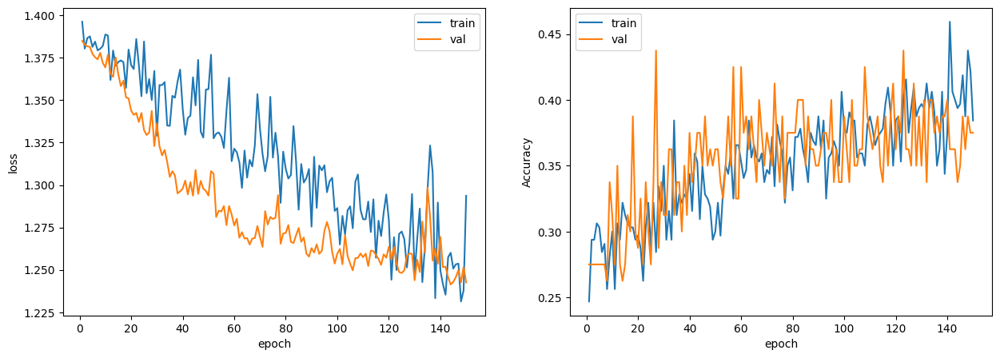

In [ ]:
train_acc_numpy = [tensor.cpu() for tensor in train_acc]
train_acc_numpy = np.array(train_acc_numpy)

plot_losses(train_loss, train_acc_numpy, val_loss, val_acc)


In [ ]:
preds = predict(model,test_loader)

conc_preds = torch.cat(preds, dim=0)
res = torch.argmax(conc_preds, dim=1)
res = res.cpu().numpy()

Testing: 100%|██████████| 2/2 [00:00<00:00, 286.65it/s]


In [ ]:
acc = accuracy_score(y_test, res)
print(f"Accuracy: {acc}")

Accuracy: 0.32


### Cyclic LR

In [ ]:
num_epochs = 150

batch_size = 64
dropout_prob = 0.5
hidden_size = 512

input_size = x_train.shape[1]
output_size = y_train.max().item() + 1

train_dataset = TensorDataset(torch.tensor(x_train_val.values, dtype=torch.float32), torch.tensor(y_train_val.values, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(x_val.values, dtype=torch.float32), torch.tensor(y_val.values, dtype=torch.long))


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

model = LSTMClassifier(input_size, hidden_size, output_size, dropout_prob).to(device)
criterion = nn.CrossEntropyLoss()

optimizer = optim.SGD(model.parameters(), lr=0.15, momentum=0.9)


scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, base_lr=0.15, max_lr=0.5,step_size_up=5,mode="triangular")



train_loss, val_loss, train_acc, val_acc = train(model, optimizer, criterion, scheduler, train_loader, val_loader, num_epochs)

Validating epoch 1/150: 100%|██████████| 2/2 [00:00<00:00, 179.21it/s]
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:156: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


Epoch 1
 train loss: 1.4052014350891113, train acc: 0.19375000894069672
 val loss: 1.38690185546875, val acc: 0.275



Validating epoch 2/150: 100%|██████████| 2/2 [00:00<00:00, 298.18it/s]


Epoch 2
 train loss: 1.396533727645874, train acc: 0.26875001192092896
 val loss: 1.3805452346801759, val acc: 0.275



Validating epoch 3/150: 100%|██████████| 2/2 [00:00<00:00, 317.74it/s]


Epoch 3
 train loss: 1.4040175914764403, train acc: 0.265625
 val loss: 1.3879164218902589, val acc: 0.275



Validating epoch 4/150: 100%|██████████| 2/2 [00:00<00:00, 292.03it/s]


Epoch 4
 train loss: 1.4134357690811157, train acc: 0.234375
 val loss: 1.3874804973602295, val acc: 0.225



Validating epoch 5/150: 100%|██████████| 2/2 [00:00<00:00, 343.13it/s]


Epoch 5
 train loss: 1.4155634641647339, train acc: 0.29375001788139343
 val loss: 1.3867640018463134, val acc: 0.325



Validating epoch 6/150: 100%|██████████| 2/2 [00:00<00:00, 293.98it/s]


Epoch 6
 train loss: 1.3908175706863404, train acc: 0.265625
 val loss: 1.3893655061721801, val acc: 0.2875



Validating epoch 7/150: 100%|██████████| 2/2 [00:00<00:00, 274.57it/s]


Epoch 7
 train loss: 1.3873205661773682, train acc: 0.29375001788139343
 val loss: 1.400922131538391, val acc: 0.275



Validating epoch 8/150: 100%|██████████| 2/2 [00:00<00:00, 379.39it/s]


Epoch 8
 train loss: 1.4372683048248291, train acc: 0.28437501192092896
 val loss: 1.3738452672958374, val acc: 0.3375



Validating epoch 9/150: 100%|██████████| 2/2 [00:00<00:00, 306.40it/s]


Epoch 9
 train loss: 1.4138646841049194, train acc: 0.2750000059604645
 val loss: 1.3750320672988892, val acc: 0.2625



Validating epoch 10/150: 100%|██████████| 2/2 [00:00<00:00, 370.06it/s]


Epoch 10
 train loss: 1.412166714668274, train acc: 0.28125
 val loss: 1.3668262004852294, val acc: 0.3



Validating epoch 11/150: 100%|██████████| 2/2 [00:00<00:00, 391.00it/s]


Epoch 11
 train loss: 1.4335801362991334, train acc: 0.24062500894069672
 val loss: 1.4213469982147218, val acc: 0.275



Validating epoch 12/150: 100%|██████████| 2/2 [00:00<00:00, 365.61it/s]


Epoch 12
 train loss: 1.4173301935195923, train acc: 0.29375001788139343
 val loss: 1.3404633045196532, val acc: 0.275



Validating epoch 13/150: 100%|██████████| 2/2 [00:00<00:00, 376.69it/s]


Epoch 13
 train loss: 1.4257031679153442, train acc: 0.2874999940395355
 val loss: 1.4201701641082765, val acc: 0.2375



Validating epoch 14/150: 100%|██████████| 2/2 [00:00<00:00, 289.89it/s]


Epoch 14
 train loss: 1.4123745679855346, train acc: 0.296875
 val loss: 1.3825409412384033, val acc: 0.2625



Validating epoch 15/150: 100%|██████████| 2/2 [00:00<00:00, 394.26it/s]


Epoch 15
 train loss: 1.3742538213729858, train acc: 0.31562501192092896
 val loss: 1.3567891597747803, val acc: 0.275



Validating epoch 16/150: 100%|██████████| 2/2 [00:00<00:00, 334.70it/s]


Epoch 16
 train loss: 1.3613828659057616, train acc: 0.28437501192092896
 val loss: 1.4171242713928223, val acc: 0.3



Validating epoch 17/150: 100%|██████████| 2/2 [00:00<00:00, 406.41it/s]


Epoch 17
 train loss: 1.451342487335205, train acc: 0.26875001192092896
 val loss: 1.34504075050354, val acc: 0.2875



Validating epoch 18/150: 100%|██████████| 2/2 [00:00<00:00, 332.56it/s]


Epoch 18
 train loss: 1.3637620687484742, train acc: 0.33125001192092896
 val loss: 1.3308903694152832, val acc: 0.3



Validating epoch 19/150: 100%|██████████| 2/2 [00:00<00:00, 407.97it/s]


Epoch 19
 train loss: 1.3633143901824951, train acc: 0.30937501788139343
 val loss: 1.3160151720046998, val acc: 0.325



Validating epoch 20/150: 100%|██████████| 2/2 [00:00<00:00, 355.45it/s]


Epoch 20
 train loss: 1.3673686981201172, train acc: 0.30937501788139343
 val loss: 1.3432433605194092, val acc: 0.3625



Validating epoch 21/150: 100%|██████████| 2/2 [00:00<00:00, 379.13it/s]


Epoch 21
 train loss: 1.4217020750045777, train acc: 0.25
 val loss: 1.317016315460205, val acc: 0.3375



Validating epoch 22/150: 100%|██████████| 2/2 [00:00<00:00, 421.22it/s]


Epoch 22
 train loss: 1.399046039581299, train acc: 0.26875001192092896
 val loss: 1.3636762142181396, val acc: 0.275



Validating epoch 23/150: 100%|██████████| 2/2 [00:00<00:00, 415.85it/s]


Epoch 23
 train loss: 1.3593236684799195, train acc: 0.3218750059604645
 val loss: 1.3172486066818236, val acc: 0.375



Validating epoch 24/150: 100%|██████████| 2/2 [00:00<00:00, 439.31it/s]


Epoch 24
 train loss: 1.3595252752304077, train acc: 0.3031249940395355
 val loss: 1.310638189315796, val acc: 0.35



Validating epoch 25/150: 100%|██████████| 2/2 [00:00<00:00, 390.86it/s]


Epoch 25
 train loss: 1.3827003955841064, train acc: 0.296875
 val loss: 1.3088371992111205, val acc: 0.4125



Validating epoch 26/150: 100%|██████████| 2/2 [00:00<00:00, 395.19it/s]


Epoch 26
 train loss: 1.357178282737732, train acc: 0.32500001788139343
 val loss: 1.3572529554367065, val acc: 0.325



Validating epoch 27/150: 100%|██████████| 2/2 [00:00<00:00, 283.04it/s]


Epoch 27
 train loss: 1.4087933540344237, train acc: 0.265625
 val loss: 1.3664863109588623, val acc: 0.2875



Validating epoch 28/150: 100%|██████████| 2/2 [00:00<00:00, 321.60it/s]


Epoch 28
 train loss: 1.3757752180099487, train acc: 0.31562501192092896
 val loss: 1.3178187608718872, val acc: 0.2875



Validating epoch 29/150: 100%|██████████| 2/2 [00:00<00:00, 347.41it/s]


Epoch 29
 train loss: 1.3686607599258422, train acc: 0.3218750059604645
 val loss: 1.321897292137146, val acc: 0.35



Validating epoch 30/150: 100%|██████████| 2/2 [00:00<00:00, 397.26it/s]


Epoch 30
 train loss: 1.3422753810882568, train acc: 0.3375000059604645
 val loss: 1.2953783750534058, val acc: 0.375



Validating epoch 31/150: 100%|██████████| 2/2 [00:00<00:00, 427.08it/s]


Epoch 31
 train loss: 1.3129951238632203, train acc: 0.34375
 val loss: 1.3017378807067872, val acc: 0.3875



Validating epoch 32/150: 100%|██████████| 2/2 [00:00<00:00, 432.76it/s]


Epoch 32
 train loss: 1.3566319942474365, train acc: 0.32500001788139343
 val loss: 1.3049841165542602, val acc: 0.35



Validating epoch 33/150: 100%|██████████| 2/2 [00:00<00:00, 271.10it/s]


Epoch 33
 train loss: 1.3421725988388062, train acc: 0.34375
 val loss: 1.299341869354248, val acc: 0.325



Validating epoch 34/150: 100%|██████████| 2/2 [00:00<00:00, 403.80it/s]


Epoch 34
 train loss: 1.3522104978561402, train acc: 0.3375000059604645
 val loss: 1.2843214511871337, val acc: 0.3625



Validating epoch 35/150: 100%|██████████| 2/2 [00:00<00:00, 389.88it/s]


Epoch 35
 train loss: 1.3548130989074707, train acc: 0.3125
 val loss: 1.3044496059417725, val acc: 0.3375



Validating epoch 36/150: 100%|██████████| 2/2 [00:00<00:00, 433.45it/s]


Epoch 36
 train loss: 1.3464166164398192, train acc: 0.34062501788139343
 val loss: 1.2876291036605836, val acc: 0.3625



Validating epoch 37/150: 100%|██████████| 2/2 [00:00<00:00, 365.09it/s]


Epoch 37
 train loss: 1.350261926651001, train acc: 0.30937501788139343
 val loss: 1.2912578344345094, val acc: 0.3875



Validating epoch 38/150: 100%|██████████| 2/2 [00:00<00:00, 329.84it/s]


Epoch 38
 train loss: 1.3184216022491455, train acc: 0.3656249940395355
 val loss: 1.342931294441223, val acc: 0.275



Validating epoch 39/150: 100%|██████████| 2/2 [00:00<00:00, 276.30it/s]


Epoch 39
 train loss: 1.387644147872925, train acc: 0.27812501788139343
 val loss: 1.304019856452942, val acc: 0.325



Validating epoch 40/150: 100%|██████████| 2/2 [00:00<00:00, 334.25it/s]


Epoch 40
 train loss: 1.3403793334960938, train acc: 0.3343749940395355
 val loss: 1.2992563009262086, val acc: 0.3625



Validating epoch 41/150: 100%|██████████| 2/2 [00:00<00:00, 366.51it/s]


Epoch 41
 train loss: 1.3290587663650513, train acc: 0.31562501192092896
 val loss: 1.2893964767456054, val acc: 0.35



Validating epoch 42/150: 100%|██████████| 2/2 [00:00<00:00, 425.17it/s]


Epoch 42
 train loss: 1.3150272130966187, train acc: 0.31562501192092896
 val loss: 1.289202833175659, val acc: 0.3625



Validating epoch 43/150: 100%|██████████| 2/2 [00:00<00:00, 329.53it/s]


Epoch 43
 train loss: 1.30040442943573, train acc: 0.3687500059604645
 val loss: 1.2837284088134766, val acc: 0.3875



Validating epoch 44/150: 100%|██████████| 2/2 [00:00<00:00, 411.11it/s]


Epoch 44
 train loss: 1.32674081325531, train acc: 0.32500001788139343
 val loss: 1.283165454864502, val acc: 0.3625



Validating epoch 45/150: 100%|██████████| 2/2 [00:00<00:00, 378.02it/s]


Epoch 45
 train loss: 1.3265759468078613, train acc: 0.32500001788139343
 val loss: 1.2682059764862061, val acc: 0.3



Validating epoch 46/150: 100%|██████████| 2/2 [00:00<00:00, 353.34it/s]


Epoch 46
 train loss: 1.3160685300827026, train acc: 0.34375
 val loss: 1.2721279859542847, val acc: 0.4



Validating epoch 47/150: 100%|██████████| 2/2 [00:00<00:00, 307.51it/s]


Epoch 47
 train loss: 1.3411509990692139, train acc: 0.3218750059604645
 val loss: 1.3155113697052, val acc: 0.325



Validating epoch 48/150: 100%|██████████| 2/2 [00:00<00:00, 255.70it/s]


Epoch 48
 train loss: 1.3240483045578002, train acc: 0.34687501192092896
 val loss: 1.2819783449172975, val acc: 0.3875



Validating epoch 49/150: 100%|██████████| 2/2 [00:00<00:00, 349.07it/s]


Epoch 49
 train loss: 1.3139962911605836, train acc: 0.36250001192092896
 val loss: 1.2822615146636962, val acc: 0.3875



Validating epoch 50/150: 100%|██████████| 2/2 [00:00<00:00, 329.42it/s]


Epoch 50
 train loss: 1.3144731283187867, train acc: 0.39375001192092896
 val loss: 1.2785011291503907, val acc: 0.3375



Validating epoch 51/150: 100%|██████████| 2/2 [00:00<00:00, 344.73it/s]


Epoch 51
 train loss: 1.3150439023971559, train acc: 0.34687501192092896
 val loss: 1.2718288898468018, val acc: 0.4



Validating epoch 52/150: 100%|██████████| 2/2 [00:00<00:00, 342.80it/s]


Epoch 52
 train loss: 1.2933863878250123, train acc: 0.3812499940395355
 val loss: 1.2701532602310182, val acc: 0.35



Validating epoch 53/150: 100%|██████████| 2/2 [00:00<00:00, 355.13it/s]


Epoch 53
 train loss: 1.3090972900390625, train acc: 0.359375
 val loss: 1.2642095327377318, val acc: 0.375



Validating epoch 54/150: 100%|██████████| 2/2 [00:00<00:00, 213.95it/s]


Epoch 54
 train loss: 1.3049292325973512, train acc: 0.3656249940395355
 val loss: 1.263532543182373, val acc: 0.375



Validating epoch 55/150: 100%|██████████| 2/2 [00:00<00:00, 344.53it/s]


Epoch 55
 train loss: 1.2993105411529542, train acc: 0.38750001788139343
 val loss: 1.2751716136932374, val acc: 0.3625



Validating epoch 56/150: 100%|██████████| 2/2 [00:00<00:00, 199.31it/s]


Epoch 56
 train loss: 1.3128178119659424, train acc: 0.37187501788139343
 val loss: 1.264901089668274, val acc: 0.325



Validating epoch 57/150: 100%|██████████| 2/2 [00:00<00:00, 278.75it/s]


Epoch 57
 train loss: 1.3165286302566528, train acc: 0.3499999940395355
 val loss: 1.2665247201919556, val acc: 0.3875



Validating epoch 58/150: 100%|██████████| 2/2 [00:00<00:00, 201.05it/s]


Epoch 58
 train loss: 1.2964445352554321, train acc: 0.39375001192092896
 val loss: 1.2700170516967773, val acc: 0.3875



Validating epoch 59/150: 100%|██████████| 2/2 [00:00<00:00, 279.19it/s]


Epoch 59
 train loss: 1.3020002126693726, train acc: 0.3687500059604645
 val loss: 1.2752774238586426, val acc: 0.35



Validating epoch 60/150: 100%|██████████| 2/2 [00:00<00:00, 294.90it/s]


Epoch 60
 train loss: 1.2895582437515258, train acc: 0.3812499940395355
 val loss: 1.2607532262802124, val acc: 0.3625



Validating epoch 61/150: 100%|██████████| 2/2 [00:00<00:00, 356.95it/s]


Epoch 61
 train loss: 1.3078787326812744, train acc: 0.3812499940395355
 val loss: 1.258333420753479, val acc: 0.3875



Validating epoch 62/150: 100%|██████████| 2/2 [00:00<00:00, 350.90it/s]


Epoch 62
 train loss: 1.3082741975784302, train acc: 0.36250001192092896
 val loss: 1.2538814067840576, val acc: 0.325



Validating epoch 63/150: 100%|██████████| 2/2 [00:00<00:00, 321.53it/s]


Epoch 63
 train loss: 1.2760640859603882, train acc: 0.390625
 val loss: 1.2676000595092773, val acc: 0.3875



Validating epoch 64/150: 100%|██████████| 2/2 [00:00<00:00, 330.92it/s]


Epoch 64
 train loss: 1.2973934888839722, train acc: 0.37187501788139343
 val loss: 1.2600201606750487, val acc: 0.3875



Validating epoch 65/150: 100%|██████████| 2/2 [00:00<00:00, 331.29it/s]


Epoch 65
 train loss: 1.3013611316680909, train acc: 0.37187501788139343
 val loss: 1.2666908740997314, val acc: 0.375



Validating epoch 66/150: 100%|██████████| 2/2 [00:00<00:00, 267.93it/s]


Epoch 66
 train loss: 1.3011155366897582, train acc: 0.39375001192092896
 val loss: 1.2620543479919433, val acc: 0.35



Validating epoch 67/150: 100%|██████████| 2/2 [00:00<00:00, 437.00it/s]


Epoch 67
 train loss: 1.2861629247665405, train acc: 0.359375
 val loss: 1.258617091178894, val acc: 0.3375



Validating epoch 68/150: 100%|██████████| 2/2 [00:00<00:00, 371.46it/s]


Epoch 68
 train loss: 1.3400502920150756, train acc: 0.3218750059604645
 val loss: 1.2684736013412476, val acc: 0.35



Validating epoch 69/150: 100%|██████████| 2/2 [00:00<00:00, 274.18it/s]


Epoch 69
 train loss: 1.3183822870254516, train acc: 0.35625001788139343
 val loss: 1.2796642065048218, val acc: 0.35



Validating epoch 70/150: 100%|██████████| 2/2 [00:00<00:00, 353.99it/s]


Epoch 70
 train loss: 1.3328638315200805, train acc: 0.33125001192092896
 val loss: 1.270695447921753, val acc: 0.35



Validating epoch 71/150: 100%|██████████| 2/2 [00:00<00:00, 389.15it/s]


Epoch 71
 train loss: 1.34502375125885, train acc: 0.359375
 val loss: 1.2667516469955444, val acc: 0.3625



Validating epoch 72/150: 100%|██████████| 2/2 [00:00<00:00, 300.42it/s]


Epoch 72
 train loss: 1.3123815536499024, train acc: 0.3125
 val loss: 1.2751531839370727, val acc: 0.4



Validating epoch 73/150: 100%|██████████| 2/2 [00:00<00:00, 245.22it/s]


Epoch 73
 train loss: 1.288941216468811, train acc: 0.35625001788139343
 val loss: 1.2737528324127196, val acc: 0.3875



Validating epoch 74/150: 100%|██████████| 2/2 [00:00<00:00, 416.62it/s]


Epoch 74
 train loss: 1.28694429397583, train acc: 0.39375001192092896
 val loss: 1.2741662979125976, val acc: 0.425



Validating epoch 75/150: 100%|██████████| 2/2 [00:00<00:00, 343.01it/s]


Epoch 75
 train loss: 1.3128948211669922, train acc: 0.3656249940395355
 val loss: 1.2591458082199096, val acc: 0.325



Validating epoch 76/150: 100%|██████████| 2/2 [00:00<00:00, 370.23it/s]


Epoch 76
 train loss: 1.2727705478668212, train acc: 0.3687500059604645
 val loss: 1.2653316259384155, val acc: 0.3625



Validating epoch 77/150: 100%|██████████| 2/2 [00:00<00:00, 338.36it/s]


Epoch 77
 train loss: 1.2845006227493285, train acc: 0.3968749940395355
 val loss: 1.2563195943832397, val acc: 0.375



Validating epoch 78/150: 100%|██████████| 2/2 [00:00<00:00, 287.90it/s]


Epoch 78
 train loss: 1.2951807498931884, train acc: 0.4124999940395355
 val loss: 1.2519343614578247, val acc: 0.4



Validating epoch 79/150: 100%|██████████| 2/2 [00:00<00:00, 318.18it/s]


Epoch 79
 train loss: 1.2693987131118774, train acc: 0.40312501788139343
 val loss: 1.2660025835037232, val acc: 0.4



Validating epoch 80/150: 100%|██████████| 2/2 [00:00<00:00, 307.90it/s]


Epoch 80
 train loss: 1.2927111625671386, train acc: 0.35625001788139343
 val loss: 1.2582918167114259, val acc: 0.3875



Validating epoch 81/150: 100%|██████████| 2/2 [00:00<00:00, 369.35it/s]


Epoch 81
 train loss: 1.3175225973129272, train acc: 0.3812499940395355
 val loss: 1.2532304048538208, val acc: 0.3625



Validating epoch 82/150: 100%|██████████| 2/2 [00:00<00:00, 299.85it/s]


Epoch 82
 train loss: 1.2790505647659303, train acc: 0.3968749940395355
 val loss: 1.2538019657135009, val acc: 0.3875



Validating epoch 83/150: 100%|██████████| 2/2 [00:00<00:00, 351.22it/s]


Epoch 83
 train loss: 1.2678473472595215, train acc: 0.3687500059604645
 val loss: 1.2577965021133424, val acc: 0.3625



Validating epoch 84/150: 100%|██████████| 2/2 [00:00<00:00, 347.96it/s]


Epoch 84
 train loss: 1.2819511890411377, train acc: 0.4000000059604645
 val loss: 1.2616853713989258, val acc: 0.35



Validating epoch 85/150: 100%|██████████| 2/2 [00:00<00:00, 264.83it/s]


Epoch 85
 train loss: 1.2929695844650269, train acc: 0.35625001788139343
 val loss: 1.2727511882781983, val acc: 0.4



Validating epoch 86/150: 100%|██████████| 2/2 [00:00<00:00, 345.95it/s]


Epoch 86
 train loss: 1.2847806453704833, train acc: 0.40625
 val loss: 1.2748698234558105, val acc: 0.4



Validating epoch 87/150: 100%|██████████| 2/2 [00:00<00:00, 338.63it/s]


Epoch 87
 train loss: 1.292652702331543, train acc: 0.390625
 val loss: 1.2695183992385863, val acc: 0.35



Validating epoch 88/150: 100%|██████████| 2/2 [00:00<00:00, 389.97it/s]


Epoch 88
 train loss: 1.2732431888580322, train acc: 0.4000000059604645
 val loss: 1.2544722080230712, val acc: 0.3875



Validating epoch 89/150: 100%|██████████| 2/2 [00:00<00:00, 376.54it/s]


Epoch 89
 train loss: 1.2541491985321045, train acc: 0.3968749940395355
 val loss: 1.2852651596069335, val acc: 0.375



Validating epoch 90/150: 100%|██████████| 2/2 [00:00<00:00, 368.15it/s]


Epoch 90
 train loss: 1.277825164794922, train acc: 0.39375001192092896
 val loss: 1.2634520530700684, val acc: 0.375



Validating epoch 91/150: 100%|██████████| 2/2 [00:00<00:00, 378.09it/s]


Epoch 91
 train loss: 1.285456395149231, train acc: 0.34687501192092896
 val loss: 1.2631921291351318, val acc: 0.3875



Validating epoch 92/150: 100%|██████████| 2/2 [00:00<00:00, 366.54it/s]


Epoch 92
 train loss: 1.3139863014221191, train acc: 0.359375
 val loss: 1.2835193872451782, val acc: 0.3625



Validating epoch 93/150: 100%|██████████| 2/2 [00:00<00:00, 309.25it/s]


Epoch 93
 train loss: 1.3243548393249511, train acc: 0.375
 val loss: 1.2744962930679322, val acc: 0.4



Validating epoch 94/150: 100%|██████████| 2/2 [00:00<00:00, 344.57it/s]


Epoch 94
 train loss: 1.3254332065582275, train acc: 0.328125
 val loss: 1.2810312986373902, val acc: 0.3875



Validating epoch 95/150: 100%|██████████| 2/2 [00:00<00:00, 349.69it/s]


Epoch 95
 train loss: 1.2719993114471435, train acc: 0.3531250059604645
 val loss: 1.262896966934204, val acc: 0.4



Validating epoch 96/150: 100%|██████████| 2/2 [00:00<00:00, 258.80it/s]


Epoch 96
 train loss: 1.2675563097000122, train acc: 0.39375001192092896
 val loss: 1.252318549156189, val acc: 0.3875



Validating epoch 97/150: 100%|██████████| 2/2 [00:00<00:00, 335.76it/s]


Epoch 97
 train loss: 1.2539615631103516, train acc: 0.42500001192092896
 val loss: 1.254171371459961, val acc: 0.375



Validating epoch 98/150: 100%|██████████| 2/2 [00:00<00:00, 338.40it/s]


Epoch 98
 train loss: 1.25863676071167, train acc: 0.40625
 val loss: 1.244582438468933, val acc: 0.35



Validating epoch 99/150: 100%|██████████| 2/2 [00:00<00:00, 358.52it/s]


Epoch 99
 train loss: 1.2541273355484008, train acc: 0.3843750059604645
 val loss: 1.2461438655853272, val acc: 0.3875



Validating epoch 100/150: 100%|██████████| 2/2 [00:00<00:00, 367.34it/s]


Epoch 100
 train loss: 1.2834535598754884, train acc: 0.3812499940395355
 val loss: 1.2529329776763916, val acc: 0.425



Validating epoch 101/150: 100%|██████████| 2/2 [00:00<00:00, 349.86it/s]


Epoch 101
 train loss: 1.2659252643585206, train acc: 0.38750001788139343
 val loss: 1.2480886459350586, val acc: 0.375



Validating epoch 102/150: 100%|██████████| 2/2 [00:00<00:00, 345.71it/s]


Epoch 102
 train loss: 1.270806646347046, train acc: 0.3968749940395355
 val loss: 1.2480025053024293, val acc: 0.4



Validating epoch 103/150: 100%|██████████| 2/2 [00:00<00:00, 266.82it/s]


Epoch 103
 train loss: 1.2502092123031616, train acc: 0.4124999940395355
 val loss: 1.2410144567489625, val acc: 0.35



Validating epoch 104/150: 100%|██████████| 2/2 [00:00<00:00, 351.93it/s]


Epoch 104
 train loss: 1.25904381275177, train acc: 0.390625
 val loss: 1.2512912034988404, val acc: 0.35



Validating epoch 105/150: 100%|██████████| 2/2 [00:00<00:00, 310.48it/s]


Epoch 105
 train loss: 1.2365444421768188, train acc: 0.4156250059604645
 val loss: 1.26081326007843, val acc: 0.4



Validating epoch 106/150: 100%|██████████| 2/2 [00:00<00:00, 329.87it/s]


Epoch 106
 train loss: 1.2875704765319824, train acc: 0.3687500059604645
 val loss: 1.3007551908493042, val acc: 0.4



Validating epoch 107/150: 100%|██████████| 2/2 [00:00<00:00, 366.59it/s]


Epoch 107
 train loss: 1.3314926862716674, train acc: 0.34062501788139343
 val loss: 1.2644383192062378, val acc: 0.375



Validating epoch 108/150: 100%|██████████| 2/2 [00:00<00:00, 223.30it/s]


Epoch 108
 train loss: 1.2563510417938233, train acc: 0.421875
 val loss: 1.257829761505127, val acc: 0.3625



Validating epoch 109/150: 100%|██████████| 2/2 [00:00<00:00, 272.15it/s]


Epoch 109
 train loss: 1.2656981706619264, train acc: 0.3812499940395355
 val loss: 1.2722849130630494, val acc: 0.4



Validating epoch 110/150: 100%|██████████| 2/2 [00:00<00:00, 375.38it/s]


Epoch 110
 train loss: 1.268402671813965, train acc: 0.4000000059604645
 val loss: 1.2684584617614747, val acc: 0.3625



Validating epoch 111/150: 100%|██████████| 2/2 [00:00<00:00, 374.02it/s]


Epoch 111
 train loss: 1.2471418142318726, train acc: 0.4124999940395355
 val loss: 1.261046838760376, val acc: 0.3875



Validating epoch 112/150: 100%|██████████| 2/2 [00:00<00:00, 309.30it/s]


Epoch 112
 train loss: 1.2608075141906738, train acc: 0.4124999940395355
 val loss: 1.2486140727996826, val acc: 0.3875



Validating epoch 113/150: 100%|██████████| 2/2 [00:00<00:00, 249.65it/s]


Epoch 113
 train loss: 1.2388182640075684, train acc: 0.4312500059604645
 val loss: 1.2606403350830078, val acc: 0.375



Validating epoch 114/150: 100%|██████████| 2/2 [00:00<00:00, 347.07it/s]


Epoch 114
 train loss: 1.2418439388275146, train acc: 0.4281249940395355
 val loss: 1.2732262134552002, val acc: 0.4125



Validating epoch 115/150: 100%|██████████| 2/2 [00:00<00:00, 358.07it/s]


Epoch 115
 train loss: 1.250813627243042, train acc: 0.4124999940395355
 val loss: 1.2649243354797364, val acc: 0.35



Validating epoch 116/150: 100%|██████████| 2/2 [00:00<00:00, 374.22it/s]


Epoch 116
 train loss: 1.274597978591919, train acc: 0.3499999940395355
 val loss: 1.2577151775360107, val acc: 0.4375



Validating epoch 117/150: 100%|██████████| 2/2 [00:00<00:00, 358.81it/s]


Epoch 117
 train loss: 1.2530919313430786, train acc: 0.37812501192092896
 val loss: 1.2858537197113038, val acc: 0.3625



Validating epoch 118/150: 100%|██████████| 2/2 [00:00<00:00, 332.82it/s]


Epoch 118
 train loss: 1.2619672775268556, train acc: 0.4281249940395355
 val loss: 1.2848543167114257, val acc: 0.3875



Validating epoch 119/150: 100%|██████████| 2/2 [00:00<00:00, 317.15it/s]


Epoch 119
 train loss: 1.2625300645828248, train acc: 0.4124999940395355
 val loss: 1.2970199823379516, val acc: 0.35



Validating epoch 120/150: 100%|██████████| 2/2 [00:00<00:00, 361.24it/s]


Epoch 120
 train loss: 1.252551531791687, train acc: 0.3687500059604645
 val loss: 1.316550874710083, val acc: 0.325



Validating epoch 121/150: 100%|██████████| 2/2 [00:00<00:00, 302.56it/s]


Epoch 121
 train loss: 1.293589448928833, train acc: 0.4000000059604645
 val loss: 1.3328998565673829, val acc: 0.3875



Validating epoch 122/150: 100%|██████████| 2/2 [00:00<00:00, 323.63it/s]


Epoch 122
 train loss: 1.3224011421203614, train acc: 0.36250001192092896
 val loss: 1.2730173826217652, val acc: 0.4125



Validating epoch 123/150: 100%|██████████| 2/2 [00:00<00:00, 358.98it/s]


Epoch 123
 train loss: 1.2978797912597657, train acc: 0.3968749940395355
 val loss: 1.2735793352127076, val acc: 0.375



Validating epoch 124/150: 100%|██████████| 2/2 [00:00<00:00, 356.31it/s]


Epoch 124
 train loss: 1.2781226873397826, train acc: 0.421875
 val loss: 1.2667175769805907, val acc: 0.375



Validating epoch 125/150: 100%|██████████| 2/2 [00:00<00:00, 347.05it/s]


Epoch 125
 train loss: 1.2485132217407227, train acc: 0.390625
 val loss: 1.272546362876892, val acc: 0.375



Validating epoch 126/150: 100%|██████████| 2/2 [00:00<00:00, 377.13it/s]


Epoch 126
 train loss: 1.267360806465149, train acc: 0.39375001192092896
 val loss: 1.2594580173492431, val acc: 0.3875



Validating epoch 127/150: 100%|██████████| 2/2 [00:00<00:00, 288.02it/s]


Epoch 127
 train loss: 1.2503811359405517, train acc: 0.36250001192092896
 val loss: 1.2476982593536377, val acc: 0.3625



Validating epoch 128/150: 100%|██████████| 2/2 [00:00<00:00, 354.04it/s]


Epoch 128
 train loss: 1.2495763540267943, train acc: 0.375
 val loss: 1.252620768547058, val acc: 0.375



Validating epoch 129/150: 100%|██████████| 2/2 [00:00<00:00, 374.07it/s]


Epoch 129
 train loss: 1.2401406526565553, train acc: 0.42500001192092896
 val loss: 1.2473069906234742, val acc: 0.3625



Validating epoch 130/150: 100%|██████████| 2/2 [00:00<00:00, 372.05it/s]


Epoch 130
 train loss: 1.2325276851654052, train acc: 0.4375
 val loss: 1.2515650749206544, val acc: 0.3875



Validating epoch 131/150: 100%|██████████| 2/2 [00:00<00:00, 370.44it/s]


Epoch 131
 train loss: 1.267285704612732, train acc: 0.390625
 val loss: 1.2927531242370605, val acc: 0.375



Validating epoch 132/150: 100%|██████████| 2/2 [00:00<00:00, 393.96it/s]


Epoch 132
 train loss: 1.253087854385376, train acc: 0.3843750059604645
 val loss: 1.2509887933731079, val acc: 0.3875



Validating epoch 133/150: 100%|██████████| 2/2 [00:00<00:00, 374.74it/s]


Epoch 133
 train loss: 1.256928300857544, train acc: 0.41875001788139343
 val loss: 1.2463063240051269, val acc: 0.4125



Validating epoch 134/150: 100%|██████████| 2/2 [00:00<00:00, 283.00it/s]


Epoch 134
 train loss: 1.2442004919052123, train acc: 0.37187501788139343
 val loss: 1.261440110206604, val acc: 0.4



Validating epoch 135/150: 100%|██████████| 2/2 [00:00<00:00, 313.16it/s]


Epoch 135
 train loss: 1.2955088138580322, train acc: 0.40937501192092896
 val loss: 1.281341814994812, val acc: 0.4125



Validating epoch 136/150: 100%|██████████| 2/2 [00:00<00:00, 372.79it/s]


Epoch 136
 train loss: 1.2769233942031861, train acc: 0.390625
 val loss: 1.2660592794418335, val acc: 0.4125



Validating epoch 137/150: 100%|██████████| 2/2 [00:00<00:00, 392.61it/s]


Epoch 137
 train loss: 1.248866820335388, train acc: 0.4156250059604645
 val loss: 1.255335307121277, val acc: 0.3375



Validating epoch 138/150: 100%|██████████| 2/2 [00:00<00:00, 235.21it/s]


Epoch 138
 train loss: 1.2371792793273926, train acc: 0.3968749940395355
 val loss: 1.252208948135376, val acc: 0.375



Validating epoch 139/150: 100%|██████████| 2/2 [00:00<00:00, 413.09it/s]


Epoch 139
 train loss: 1.225995707511902, train acc: 0.40625
 val loss: 1.256282114982605, val acc: 0.3125



Validating epoch 140/150: 100%|██████████| 2/2 [00:00<00:00, 368.24it/s]


Epoch 140
 train loss: 1.2267349004745483, train acc: 0.40937501192092896
 val loss: 1.2502198934555053, val acc: 0.375



Validating epoch 141/150: 100%|██████████| 2/2 [00:00<00:00, 387.97it/s]


Epoch 141
 train loss: 1.24516863822937, train acc: 0.41875001788139343
 val loss: 1.2774315357208252, val acc: 0.425



Validating epoch 142/150: 100%|██████████| 2/2 [00:00<00:00, 322.69it/s]


Epoch 142
 train loss: 1.2448561191558838, train acc: 0.3968749940395355
 val loss: 1.2603655576705932, val acc: 0.3625



Validating epoch 143/150: 100%|██████████| 2/2 [00:00<00:00, 345.05it/s]


Epoch 143
 train loss: 1.255742859840393, train acc: 0.4000000059604645
 val loss: 1.2713554859161378, val acc: 0.3875



Validating epoch 144/150: 100%|██████████| 2/2 [00:00<00:00, 349.74it/s]


Epoch 144
 train loss: 1.2584107875823975, train acc: 0.37187501788139343
 val loss: 1.2758185386657714, val acc: 0.35



Validating epoch 145/150: 100%|██████████| 2/2 [00:00<00:00, 381.54it/s]


Epoch 145
 train loss: 1.2610657691955567, train acc: 0.38750001788139343
 val loss: 1.2730051755905152, val acc: 0.4125



Validating epoch 146/150: 100%|██████████| 2/2 [00:00<00:00, 367.81it/s]


Epoch 146
 train loss: 1.2741965532302857, train acc: 0.36250001192092896
 val loss: 1.2604653120040894, val acc: 0.375



Validating epoch 147/150: 100%|██████████| 2/2 [00:00<00:00, 346.49it/s]


Epoch 147
 train loss: 1.2496478080749511, train acc: 0.41875001788139343
 val loss: 1.2613263607025147, val acc: 0.375



Validating epoch 148/150: 100%|██████████| 2/2 [00:00<00:00, 358.50it/s]


Epoch 148
 train loss: 1.2499032974243165, train acc: 0.3843750059604645
 val loss: 1.2737670183181762, val acc: 0.3875



Validating epoch 149/150: 100%|██████████| 2/2 [00:00<00:00, 347.97it/s]


Epoch 149
 train loss: 1.2285220623016357, train acc: 0.4124999940395355
 val loss: 1.277225875854492, val acc: 0.3375



Validating epoch 150/150: 100%|██████████| 2/2 [00:00<00:00, 258.64it/s]

Epoch 150
 train loss: 1.217511248588562, train acc: 0.4281249940395355
 val loss: 1.2546576976776123, val acc: 0.4



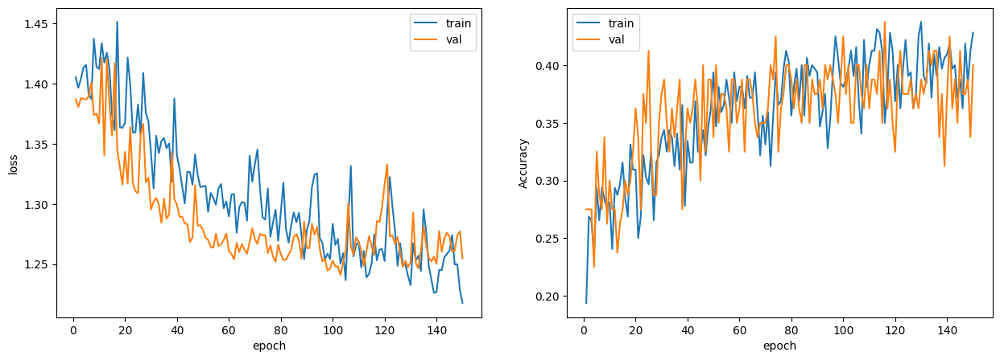

In [ ]:
train_acc_numpy = [tensor.cpu() for tensor in train_acc]
train_acc_numpy = np.array(train_acc_numpy)

plot_losses(train_loss, train_acc_numpy, val_loss, val_acc)


In [ ]:
preds = predict(model,test_loader)

conc_preds = torch.cat(preds, dim=0)
res = torch.argmax(conc_preds, dim=1)
res = res.cpu().numpy()

Testing: 100%|██████████| 2/2 [00:00<00:00, 291.83it/s]


In [ ]:
acc = accuracy_score(y_test, res)
print(f"Accuracy: {acc}")

Accuracy: 0.31


# MLP

In [ ]:
batch_size = 64
num_epochs = 100
hidden_features = 128
in_features = x_train_val.shape[1]
out_features = y_train_val.max() - y_train_val.min() + 1


model = nn.Sequential(
    nn.Linear(in_features, hidden_features),
    nn.BatchNorm1d(hidden_features),
    nn.ReLU(),
    nn.Linear(hidden_features, hidden_features),
    nn.BatchNorm1d(hidden_features),
    nn.ReLU(),
    nn.Linear(hidden_features, hidden_features),
    nn.BatchNorm1d(hidden_features),
    nn.ReLU(),
    nn.Linear(hidden_features, out_features),
).to(device)


train_dataset = TensorDataset(torch.tensor(x_train_val.values, dtype=torch.float32), torch.tensor(y_train_val.values, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(x_val.values, dtype=torch.float32), torch.tensor(y_val.values, dtype=torch.long))

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

optimizer = optim.SGD(model.parameters(), lr=1e-3)
criterion = nn.CrossEntropyLoss()
scheduler = None





train_loss, val_loss, train_acc, val_acc = train(model, optimizer, criterion, scheduler, train_loader, val_loader, num_epochs)

Validating epoch 1/100: 100%|██████████| 2/2 [00:00<00:00, 459.40it/s]


Epoch 1
 train loss: 1.3931371927261353, train acc: 0.2718749940395355
 val loss: 1.3924489259719848, val acc: 0.2375



Validating epoch 2/100: 100%|██████████| 2/2 [00:00<00:00, 525.57it/s]


Epoch 2
 train loss: 1.3862438678741456, train acc: 0.27812501788139343
 val loss: 1.3888236999511718, val acc: 0.2375



Validating epoch 3/100: 100%|██████████| 2/2 [00:00<00:00, 496.81it/s]


Epoch 3
 train loss: 1.3802961826324462, train acc: 0.29375001788139343
 val loss: 1.3849475383758545, val acc: 0.275



Validating epoch 4/100: 100%|██████████| 2/2 [00:00<00:00, 551.66it/s]


Epoch 4
 train loss: 1.367252731323242, train acc: 0.2906250059604645
 val loss: 1.383112359046936, val acc: 0.275



Validating epoch 5/100: 100%|██████████| 2/2 [00:00<00:00, 539.50it/s]


Epoch 5
 train loss: 1.3703168630599976, train acc: 0.28125
 val loss: 1.3824711084365844, val acc: 0.2875



Validating epoch 6/100: 100%|██████████| 2/2 [00:00<00:00, 429.96it/s]


Epoch 6
 train loss: 1.356990098953247, train acc: 0.296875
 val loss: 1.3827176809310913, val acc: 0.3



Validating epoch 7/100: 100%|██████████| 2/2 [00:00<00:00, 546.70it/s]


Epoch 7
 train loss: 1.3448388576507568, train acc: 0.33125001192092896
 val loss: 1.3819528818130493, val acc: 0.275



Validating epoch 8/100: 100%|██████████| 2/2 [00:00<00:00, 317.76it/s]


Epoch 8
 train loss: 1.347440242767334, train acc: 0.2874999940395355
 val loss: 1.378201460838318, val acc: 0.25



Validating epoch 9/100: 100%|██████████| 2/2 [00:00<00:00, 360.09it/s]


Epoch 9
 train loss: 1.3499460220336914, train acc: 0.3031249940395355
 val loss: 1.3702482223510741, val acc: 0.3



Validating epoch 10/100: 100%|██████████| 2/2 [00:00<00:00, 365.84it/s]


Epoch 10
 train loss: 1.330450987815857, train acc: 0.328125
 val loss: 1.3626730680465697, val acc: 0.275



Validating epoch 11/100: 100%|██████████| 2/2 [00:00<00:00, 377.61it/s]


Epoch 11
 train loss: 1.3362446784973145, train acc: 0.3499999940395355
 val loss: 1.3541699409484864, val acc: 0.2625



Validating epoch 12/100: 100%|██████████| 2/2 [00:00<00:00, 406.39it/s]


Epoch 12
 train loss: 1.332186222076416, train acc: 0.31562501192092896
 val loss: 1.344776439666748, val acc: 0.325



Validating epoch 13/100: 100%|██████████| 2/2 [00:00<00:00, 484.11it/s]


Epoch 13
 train loss: 1.3253509759902955, train acc: 0.34375
 val loss: 1.3372278690338135, val acc: 0.325



Validating epoch 14/100: 100%|██████████| 2/2 [00:00<00:00, 340.65it/s]


Epoch 14
 train loss: 1.3183022737503052, train acc: 0.328125
 val loss: 1.3306237936019898, val acc: 0.3125



Validating epoch 15/100: 100%|██████████| 2/2 [00:00<00:00, 451.53it/s]


Epoch 15
 train loss: 1.3152476310729981, train acc: 0.36250001192092896
 val loss: 1.3261355400085448, val acc: 0.3



Validating epoch 16/100: 100%|██████████| 2/2 [00:00<00:00, 383.36it/s]


Epoch 16
 train loss: 1.3043265342712402, train acc: 0.37187501788139343
 val loss: 1.3214796543121339, val acc: 0.325



Validating epoch 17/100: 100%|██████████| 2/2 [00:00<00:00, 441.55it/s]


Epoch 17
 train loss: 1.3039019107818604, train acc: 0.36250001192092896
 val loss: 1.3193322896957398, val acc: 0.3125



Validating epoch 18/100: 100%|██████████| 2/2 [00:00<00:00, 505.46it/s]


Epoch 18
 train loss: 1.3039318561553954, train acc: 0.37812501192092896
 val loss: 1.316651749610901, val acc: 0.3375



Validating epoch 19/100: 100%|██████████| 2/2 [00:00<00:00, 446.27it/s]


Epoch 19
 train loss: 1.2905635356903076, train acc: 0.39375001192092896
 val loss: 1.3138746976852418, val acc: 0.3375



Validating epoch 20/100: 100%|██████████| 2/2 [00:00<00:00, 473.96it/s]


Epoch 20
 train loss: 1.2948747396469116, train acc: 0.3687500059604645
 val loss: 1.3118271350860595, val acc: 0.35



Validating epoch 21/100: 100%|██████████| 2/2 [00:00<00:00, 545.10it/s]


Epoch 21
 train loss: 1.2824314832687378, train acc: 0.375
 val loss: 1.3102773666381835, val acc: 0.3375



Validating epoch 22/100: 100%|██████████| 2/2 [00:00<00:00, 450.54it/s]


Epoch 22
 train loss: 1.2779390811920166, train acc: 0.40625
 val loss: 1.3074950218200683, val acc: 0.3625



Validating epoch 23/100: 100%|██████████| 2/2 [00:00<00:00, 521.94it/s]


Epoch 23
 train loss: 1.2743144989013673, train acc: 0.40312501788139343
 val loss: 1.3056540012359619, val acc: 0.375



Validating epoch 24/100: 100%|██████████| 2/2 [00:00<00:00, 497.99it/s]


Epoch 24
 train loss: 1.271337103843689, train acc: 0.4000000059604645
 val loss: 1.3031055927276611, val acc: 0.3625



Validating epoch 25/100: 100%|██████████| 2/2 [00:00<00:00, 562.50it/s]


Epoch 25
 train loss: 1.2675791263580323, train acc: 0.4000000059604645
 val loss: 1.3025286197662354, val acc: 0.3625



Validating epoch 26/100: 100%|██████████| 2/2 [00:00<00:00, 581.25it/s]


Epoch 26
 train loss: 1.2641647815704347, train acc: 0.4156250059604645
 val loss: 1.3012558460235595, val acc: 0.3875



Validating epoch 27/100: 100%|██████████| 2/2 [00:00<00:00, 498.94it/s]


Epoch 27
 train loss: 1.267553734779358, train acc: 0.40625
 val loss: 1.30020751953125, val acc: 0.375



Validating epoch 28/100: 100%|██████████| 2/2 [00:00<00:00, 427.92it/s]


Epoch 28
 train loss: 1.2535849809646606, train acc: 0.421875
 val loss: 1.2982667207717895, val acc: 0.3875



Validating epoch 29/100: 100%|██████████| 2/2 [00:00<00:00, 367.23it/s]


Epoch 29
 train loss: 1.2563086032867432, train acc: 0.453125
 val loss: 1.2966094732284545, val acc: 0.375



Validating epoch 30/100: 100%|██████████| 2/2 [00:00<00:00, 250.61it/s]


Epoch 30
 train loss: 1.2488785266876221, train acc: 0.4124999940395355
 val loss: 1.2961000442504882, val acc: 0.4



Validating epoch 31/100: 100%|██████████| 2/2 [00:00<00:00, 437.82it/s]


Epoch 31
 train loss: 1.2382832050323487, train acc: 0.45000001788139343
 val loss: 1.2955724954605103, val acc: 0.4



Validating epoch 32/100: 100%|██████████| 2/2 [00:00<00:00, 515.81it/s]


Epoch 32
 train loss: 1.242753839492798, train acc: 0.45625001192092896
 val loss: 1.293832540512085, val acc: 0.4



Validating epoch 33/100: 100%|██████████| 2/2 [00:00<00:00, 449.48it/s]


Epoch 33
 train loss: 1.2372138261795045, train acc: 0.45625001192092896
 val loss: 1.2921461582183837, val acc: 0.4



Validating epoch 34/100: 100%|██████████| 2/2 [00:00<00:00, 441.62it/s]


Epoch 34
 train loss: 1.2370875835418702, train acc: 0.484375
 val loss: 1.292345905303955, val acc: 0.3875



Validating epoch 35/100: 100%|██████████| 2/2 [00:00<00:00, 540.36it/s]


Epoch 35
 train loss: 1.2337165355682373, train acc: 0.45625001192092896
 val loss: 1.2909057140350342, val acc: 0.375



Validating epoch 36/100: 100%|██████████| 2/2 [00:00<00:00, 530.05it/s]


Epoch 36
 train loss: 1.2247687578201294, train acc: 0.45625001192092896
 val loss: 1.2879090070724488, val acc: 0.3875



Validating epoch 37/100: 100%|██████████| 2/2 [00:00<00:00, 607.83it/s]


Epoch 37
 train loss: 1.2332396984100342, train acc: 0.4281249940395355
 val loss: 1.2885600090026856, val acc: 0.3875



Validating epoch 38/100: 100%|██████████| 2/2 [00:00<00:00, 439.01it/s]


Epoch 38
 train loss: 1.2223058462142944, train acc: 0.4625000059604645
 val loss: 1.2869502782821656, val acc: 0.3875



Validating epoch 39/100: 100%|██████████| 2/2 [00:00<00:00, 401.58it/s]


Epoch 39
 train loss: 1.2182488441467285, train acc: 0.4781250059604645
 val loss: 1.2864610433578492, val acc: 0.4



Validating epoch 40/100: 100%|██████████| 2/2 [00:00<00:00, 411.81it/s]


Epoch 40
 train loss: 1.2089035034179687, train acc: 0.4749999940395355
 val loss: 1.2851057767868042, val acc: 0.4



Validating epoch 41/100: 100%|██████████| 2/2 [00:00<00:00, 280.80it/s]


Epoch 41
 train loss: 1.2130587100982666, train acc: 0.4625000059604645
 val loss: 1.2830230474472046, val acc: 0.4



Validating epoch 42/100: 100%|██████████| 2/2 [00:00<00:00, 234.80it/s]


Epoch 42
 train loss: 1.2075430154800415, train acc: 0.4625000059604645
 val loss: 1.282670783996582, val acc: 0.4



Validating epoch 43/100: 100%|██████████| 2/2 [00:00<00:00, 409.68it/s]


Epoch 43
 train loss: 1.1966822624206543, train acc: 0.4749999940395355
 val loss: 1.2830562114715576, val acc: 0.4



Validating epoch 44/100: 100%|██████████| 2/2 [00:00<00:00, 332.50it/s]


Epoch 44
 train loss: 1.201718235015869, train acc: 0.4937500059604645
 val loss: 1.2817603826522828, val acc: 0.4125



Validating epoch 45/100: 100%|██████████| 2/2 [00:00<00:00, 441.41it/s]


Epoch 45
 train loss: 1.1945637226104737, train acc: 0.5062500238418579
 val loss: 1.2803115367889404, val acc: 0.425



Validating epoch 46/100: 100%|██████████| 2/2 [00:00<00:00, 440.53it/s]


Epoch 46
 train loss: 1.1970394849777222, train acc: 0.503125011920929
 val loss: 1.278543472290039, val acc: 0.425



Validating epoch 47/100: 100%|██████████| 2/2 [00:00<00:00, 573.03it/s]


Epoch 47
 train loss: 1.1940260410308838, train acc: 0.512499988079071
 val loss: 1.277862000465393, val acc: 0.4375



Validating epoch 48/100: 100%|██████████| 2/2 [00:00<00:00, 477.63it/s]


Epoch 48
 train loss: 1.1840450763702393, train acc: 0.512499988079071
 val loss: 1.2752017736434937, val acc: 0.425



Validating epoch 49/100: 100%|██████████| 2/2 [00:00<00:00, 399.72it/s]


Epoch 49
 train loss: 1.1842734575271607, train acc: 0.4906249940395355
 val loss: 1.2766396045684814, val acc: 0.425



Validating epoch 50/100: 100%|██████████| 2/2 [00:00<00:00, 422.32it/s]


Epoch 50
 train loss: 1.1831213712692261, train acc: 0.4937500059604645
 val loss: 1.2770907878875732, val acc: 0.425



Validating epoch 51/100: 100%|██████████| 2/2 [00:00<00:00, 343.58it/s]


Epoch 51
 train loss: 1.180433750152588, train acc: 0.48750001192092896
 val loss: 1.276850986480713, val acc: 0.4375



Validating epoch 52/100: 100%|██████████| 2/2 [00:00<00:00, 376.05it/s]


Epoch 52
 train loss: 1.174644136428833, train acc: 0.518750011920929
 val loss: 1.2752901315689087, val acc: 0.45



Validating epoch 53/100: 100%|██████████| 2/2 [00:00<00:00, 493.36it/s]


Epoch 53
 train loss: 1.1825757503509522, train acc: 0.48750001192092896
 val loss: 1.273611307144165, val acc: 0.4375



Validating epoch 54/100: 100%|██████████| 2/2 [00:00<00:00, 502.19it/s]


Epoch 54
 train loss: 1.1820793390274047, train acc: 0.4937500059604645
 val loss: 1.2718798875808717, val acc: 0.45



Validating epoch 55/100: 100%|██████████| 2/2 [00:00<00:00, 411.09it/s]


Epoch 55
 train loss: 1.1779091596603393, train acc: 0.503125011920929
 val loss: 1.2723118543624878, val acc: 0.4375



Validating epoch 56/100: 100%|██████████| 2/2 [00:00<00:00, 281.30it/s]


Epoch 56
 train loss: 1.1679457426071167, train acc: 0.515625
 val loss: 1.2714859962463378, val acc: 0.4375



Validating epoch 57/100: 100%|██████████| 2/2 [00:00<00:00, 522.75it/s]


Epoch 57
 train loss: 1.1651521921157837, train acc: 0.528124988079071
 val loss: 1.2700028896331788, val acc: 0.4375



Validating epoch 58/100: 100%|██████████| 2/2 [00:00<00:00, 431.42it/s]


Epoch 58
 train loss: 1.1650513410568237, train acc: 0.546875
 val loss: 1.268905019760132, val acc: 0.45



Validating epoch 59/100: 100%|██████████| 2/2 [00:00<00:00, 513.57it/s]


Epoch 59
 train loss: 1.1552417039871217, train acc: 0.53125
 val loss: 1.2706454515457153, val acc: 0.4375



Validating epoch 60/100: 100%|██████████| 2/2 [00:00<00:00, 443.42it/s]


Epoch 60
 train loss: 1.15189790725708, train acc: 0.5406250357627869
 val loss: 1.2698621511459351, val acc: 0.4375



Validating epoch 61/100: 100%|██████████| 2/2 [00:00<00:00, 369.20it/s]


Epoch 61
 train loss: 1.149914264678955, train acc: 0.534375011920929
 val loss: 1.268240261077881, val acc: 0.45



Validating epoch 62/100: 100%|██████████| 2/2 [00:00<00:00, 591.21it/s]


Epoch 62
 train loss: 1.1532979726791381, train acc: 0.5562500357627869
 val loss: 1.2682100534439087, val acc: 0.45



Validating epoch 63/100: 100%|██████████| 2/2 [00:00<00:00, 373.71it/s]


Epoch 63
 train loss: 1.1487269163131715, train acc: 0.53125
 val loss: 1.266467308998108, val acc: 0.4625



Validating epoch 64/100: 100%|██████████| 2/2 [00:00<00:00, 480.86it/s]


Epoch 64
 train loss: 1.1475035667419433, train acc: 0.528124988079071
 val loss: 1.2667582273483275, val acc: 0.45



Validating epoch 65/100: 100%|██████████| 2/2 [00:00<00:00, 448.42it/s]


Epoch 65
 train loss: 1.1424704551696778, train acc: 0.543749988079071
 val loss: 1.2663267850875854, val acc: 0.4625



Validating epoch 66/100: 100%|██████████| 2/2 [00:00<00:00, 544.33it/s]


Epoch 66
 train loss: 1.1471630096435548, train acc: 0.53125
 val loss: 1.2664971590042113, val acc: 0.4625



Validating epoch 67/100: 100%|██████████| 2/2 [00:00<00:00, 472.28it/s]


Epoch 67
 train loss: 1.1452595472335816, train acc: 0.5625
 val loss: 1.2671741485595702, val acc: 0.4625



Validating epoch 68/100: 100%|██████████| 2/2 [00:00<00:00, 277.25it/s]


Epoch 68
 train loss: 1.135193371772766, train acc: 0.53125
 val loss: 1.266642451286316, val acc: 0.45



Validating epoch 69/100: 100%|██████████| 2/2 [00:00<00:00, 336.16it/s]


Epoch 69
 train loss: 1.1400933504104613, train acc: 0.5375000238418579
 val loss: 1.2648265361785889, val acc: 0.4375



Validating epoch 70/100: 100%|██████████| 2/2 [00:00<00:00, 304.54it/s]


Epoch 70
 train loss: 1.1245044708251952, train acc: 0.5687500238418579
 val loss: 1.2643795013427734, val acc: 0.425



Validating epoch 71/100: 100%|██████████| 2/2 [00:00<00:00, 593.04it/s]


Epoch 71
 train loss: 1.1306660652160645, train acc: 0.5625
 val loss: 1.2647328853607178, val acc: 0.45



Validating epoch 72/100: 100%|██████████| 2/2 [00:00<00:00, 298.47it/s]


Epoch 72
 train loss: 1.1281003475189209, train acc: 0.5562500357627869
 val loss: 1.263360047340393, val acc: 0.4375



Validating epoch 73/100: 100%|██████████| 2/2 [00:00<00:00, 286.93it/s]


Epoch 73
 train loss: 1.1250338315963746, train acc: 0.5562500357627869
 val loss: 1.263097071647644, val acc: 0.45



Validating epoch 74/100: 100%|██████████| 2/2 [00:00<00:00, 471.69it/s]


Epoch 74
 train loss: 1.116556978225708, train acc: 0.578125
 val loss: 1.2624387264251709, val acc: 0.425



Validating epoch 75/100: 100%|██████████| 2/2 [00:00<00:00, 285.49it/s]


Epoch 75
 train loss: 1.11948721408844, train acc: 0.550000011920929
 val loss: 1.26210560798645, val acc: 0.425



Validating epoch 76/100: 100%|██████████| 2/2 [00:00<00:00, 307.83it/s]


Epoch 76
 train loss: 1.1203140258789062, train acc: 0.5687500238418579
 val loss: 1.2622337818145752, val acc: 0.425



Validating epoch 77/100: 100%|██████████| 2/2 [00:00<00:00, 384.18it/s]


Epoch 77
 train loss: 1.118241047859192, train acc: 0.565625011920929
 val loss: 1.26284921169281, val acc: 0.425



Validating epoch 78/100: 100%|██████████| 2/2 [00:00<00:00, 260.84it/s]


Epoch 78
 train loss: 1.1195234060287476, train acc: 0.5687500238418579
 val loss: 1.262234663963318, val acc: 0.4375



Validating epoch 79/100: 100%|██████████| 2/2 [00:00<00:00, 377.90it/s]


Epoch 79
 train loss: 1.1162585496902466, train acc: 0.574999988079071
 val loss: 1.2609543800354004, val acc: 0.4125



Validating epoch 80/100: 100%|██████████| 2/2 [00:00<00:00, 571.82it/s]


Epoch 80
 train loss: 1.1081798076629639, train acc: 0.574999988079071
 val loss: 1.2610722541809083, val acc: 0.4375



Validating epoch 81/100: 100%|██████████| 2/2 [00:00<00:00, 257.68it/s]


Epoch 81
 train loss: 1.1165624856948853, train acc: 0.578125
 val loss: 1.2606643676757812, val acc: 0.425



Validating epoch 82/100: 100%|██████████| 2/2 [00:00<00:00, 458.07it/s]


Epoch 82
 train loss: 1.109093713760376, train acc: 0.590624988079071
 val loss: 1.2596287250518798, val acc: 0.425



Validating epoch 83/100: 100%|██████████| 2/2 [00:00<00:00, 350.83it/s]


Epoch 83
 train loss: 1.097014021873474, train acc: 0.59375
 val loss: 1.2604268789291382, val acc: 0.425



Validating epoch 84/100: 100%|██████████| 2/2 [00:00<00:00, 552.72it/s]


Epoch 84
 train loss: 1.10377197265625, train acc: 0.596875011920929
 val loss: 1.260819673538208, val acc: 0.425



Validating epoch 85/100: 100%|██████████| 2/2 [00:00<00:00, 290.64it/s]


Epoch 85
 train loss: 1.0943819761276246, train acc: 0.5843750238418579
 val loss: 1.2597476482391357, val acc: 0.425



Validating epoch 86/100: 100%|██████████| 2/2 [00:00<00:00, 293.84it/s]


Epoch 86
 train loss: 1.1148604869842529, train acc: 0.5687500238418579
 val loss: 1.2582231521606446, val acc: 0.425



Validating epoch 87/100: 100%|██████████| 2/2 [00:00<00:00, 251.34it/s]


Epoch 87
 train loss: 1.100438690185547, train acc: 0.581250011920929
 val loss: 1.2579097747802734, val acc: 0.425



Validating epoch 88/100: 100%|██████████| 2/2 [00:00<00:00, 601.68it/s]


Epoch 88
 train loss: 1.0904046297073364, train acc: 0.5625
 val loss: 1.259079885482788, val acc: 0.425



Validating epoch 89/100: 100%|██████████| 2/2 [00:00<00:00, 583.60it/s]


Epoch 89
 train loss: 1.0842470169067382, train acc: 0.609375
 val loss: 1.2574085950851441, val acc: 0.425



Validating epoch 90/100: 100%|██████████| 2/2 [00:00<00:00, 272.45it/s]


Epoch 90
 train loss: 1.0902681350708008, train acc: 0.609375
 val loss: 1.2570131540298461, val acc: 0.425



Validating epoch 91/100: 100%|██████████| 2/2 [00:00<00:00, 255.03it/s]


Epoch 91
 train loss: 1.0777130842208862, train acc: 0.6031250357627869
 val loss: 1.2574870347976685, val acc: 0.425



Validating epoch 92/100: 100%|██████████| 2/2 [00:00<00:00, 310.67it/s]


Epoch 92
 train loss: 1.07791748046875, train acc: 0.6031250357627869
 val loss: 1.2573651313781737, val acc: 0.425



Validating epoch 93/100: 100%|██████████| 2/2 [00:00<00:00, 404.70it/s]


Epoch 93
 train loss: 1.0811716079711915, train acc: 0.596875011920929
 val loss: 1.257742738723755, val acc: 0.425



Validating epoch 94/100: 100%|██████████| 2/2 [00:00<00:00, 473.32it/s]


Epoch 94
 train loss: 1.0722126245498658, train acc: 0.6156250238418579
 val loss: 1.2575014591217042, val acc: 0.425



Validating epoch 95/100: 100%|██████████| 2/2 [00:00<00:00, 479.08it/s]


Epoch 95
 train loss: 1.0731642246246338, train acc: 0.6187500357627869
 val loss: 1.2553950548171997, val acc: 0.425



Validating epoch 96/100: 100%|██████████| 2/2 [00:00<00:00, 449.86it/s]


Epoch 96
 train loss: 1.0688530445098876, train acc: 0.609375
 val loss: 1.2563194036483765, val acc: 0.425



Validating epoch 97/100: 100%|██████████| 2/2 [00:00<00:00, 560.36it/s]


Epoch 97
 train loss: 1.066714334487915, train acc: 0.628125011920929
 val loss: 1.2548174858093262, val acc: 0.425



Validating epoch 98/100: 100%|██████████| 2/2 [00:00<00:00, 369.14it/s]


Epoch 98
 train loss: 1.0729956388473512, train acc: 0.6312500238418579
 val loss: 1.2559556722640992, val acc: 0.425



Validating epoch 99/100: 100%|██████████| 2/2 [00:00<00:00, 428.43it/s]


Epoch 99
 train loss: 1.065165400505066, train acc: 0.6187500357627869
 val loss: 1.257324719429016, val acc: 0.425



Validating epoch 100/100: 100%|██████████| 2/2 [00:00<00:00, 268.92it/s]

Epoch 100
 train loss: 1.0662723064422608, train acc: 0.609375
 val loss: 1.2564919471740723, val acc: 0.425



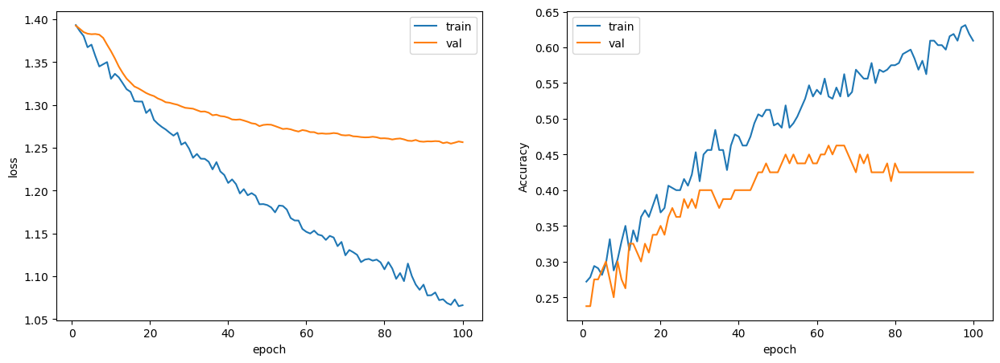

In [ ]:
train_acc_numpy = [tensor.cpu() for tensor in train_acc]
train_acc_numpy = np.array(train_acc_numpy)

plot_losses(train_loss, train_acc_numpy, val_loss, val_acc)


In [ ]:
preds = predict(model,test_loader)

conc_preds = torch.cat(preds, dim=0)
res = torch.argmax(conc_preds, dim=1)
res = res.cpu().numpy()

Testing: 100%|██████████| 2/2 [00:00<00:00, 377.98it/s]


In [ ]:
acc = accuracy_score(y_test, res)
print(f"Accuracy: {acc}")

Accuracy: 0.26


# Transformer

In [ ]:
x_train, y_train = train_df[embed_columns], train_df['target']
x_test, y_test = test_df[embed_columns], test_df['target']
x_train_val, x_val, y_train_val, y_val = train_test_split(x_train,y_train, test_size=0.2, random_state=42, stratify=y_train)

In [ ]:
class TransformerClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_heads, num_layers, num_classes, dropout=0.1):
        super(TransformerClassifier, self).__init__()

        encoder_layers = nn.TransformerEncoderLayer(hidden_size, num_heads)
        self.transformer_encoder = nn.TransformerEncoder(encoder_layers, num_layers)

        self.fc = nn.Linear(input_size, num_classes)

        self.dropout = nn.Dropout(dropout)

    def forward(self, x):
        encoded = self.transformer_encoder(x)
        encoded = encoded.unsqueeze(0)
        pooled = F.max_pool1d(encoded.permute(1, 2, 0), kernel_size=encoded.shape[0]).squeeze()
        out = self.fc(self.dropout(pooled))
        return F.log_softmax(out, dim=1)

In [ ]:
input_size = x_train_val.shape[1]
hidden_size = input_size
num_heads = 8
num_layers = 5
num_classes = y_train_val.max() - y_train_val.min() + 1

model = TransformerClassifier(input_size, hidden_size, num_heads, num_layers, num_classes)

x_train_tensor = torch.tensor(x_train_val.values, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train_val.values, dtype=torch.long)

x_val_tensor = torch.tensor(x_val.values, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val.values, dtype=torch.long)

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()

train_losses = []
val_losses = []
train_acc = []
val_acc = []

num_epochs = 100
for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()
    outputs = model(x_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    train_losses.append(loss.item())
    loss.backward()
    optimizer.step()
    train_predictions = torch.argmax(outputs, dim=1)
    train_accuracy = (train_predictions == y_train_tensor).float().mean().item()
    train_acc.append(train_accuracy)
    model.eval()
    with torch.no_grad():
        val_outputs = model(x_val_tensor)
        val_loss = criterion(val_outputs, y_val_tensor)
        val_losses.append(val_loss)
        val_predictions = torch.argmax(val_outputs, dim=1)
        val_accuracy = (val_predictions == y_val_tensor).float().mean().item()
        val_acc.append(val_accuracy)

    print(f'Epoch [{epoch+1}/{num_epochs}], '
          f'Training Loss: {loss.item():.4f}, '
          f'Validation Loss: {val_loss.item():.4f}, '
          f'Validation Accuracy: {val_accuracy:.4f}')

Epoch [1/100], Training Loss: 1.4415, Validation Loss: 3.5066, Validation Accuracy: 0.2375
Epoch [2/100], Training Loss: 3.4266, Validation Loss: 3.5850, Validation Accuracy: 0.2750
Epoch [3/100], Training Loss: 3.5154, Validation Loss: 2.5962, Validation Accuracy: 0.2125
Epoch [4/100], Training Loss: 2.5718, Validation Loss: 1.5585, Validation Accuracy: 0.2750
Epoch [5/100], Training Loss: 1.5580, Validation Loss: 1.5875, Validation Accuracy: 0.2750
Epoch [6/100], Training Loss: 1.5854, Validation Loss: 1.5418, Validation Accuracy: 0.2375
Epoch [7/100], Training Loss: 1.5331, Validation Loss: 1.5125, Validation Accuracy: 0.2375
Epoch [8/100], Training Loss: 1.5020, Validation Loss: 1.4195, Validation Accuracy: 0.2375
Epoch [9/100], Training Loss: 1.4417, Validation Loss: 1.3825, Validation Accuracy: 0.2750
Epoch [10/100], Training Loss: 1.4038, Validation Loss: 1.4040, Validation Accuracy: 0.2750
Epoch [11/100], Training Loss: 1.4078, Validation Loss: 1.4254, Validation Accuracy: 0.27

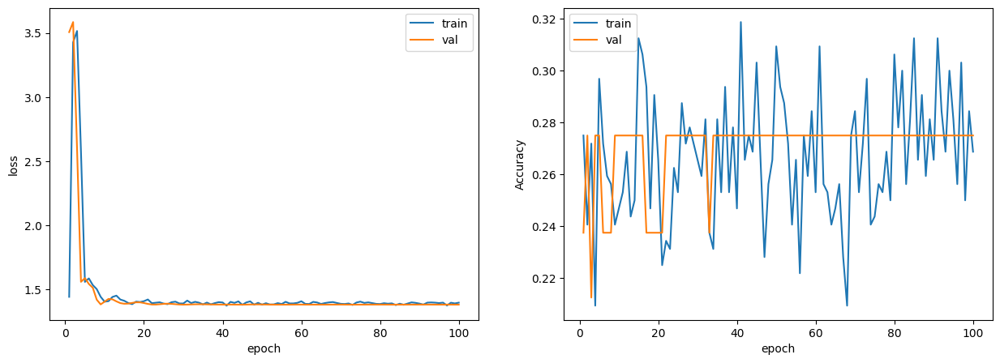

In [ ]:
plot_losses(train_losses, train_acc, val_losses, val_acc)

In [ ]:
x_test_tensor = torch.tensor(x_test.values, dtype=torch.float32)
model.eval()

with torch.no_grad():
    test_outputs = model(x_test_tensor)
    test_predictions = torch.argmax(test_outputs, dim=1)

test_predictions_np = test_predictions.numpy()

In [ ]:
transformer = accuracy_score(y_test, test_predictions_np)
print(f"Accuracy: {transformer}")

Accuracy: 0.23
